# Case Identify Bank Account Type

### Objective: Classify legal and illegal bank transactions and put in an Excel file 1 if the account had any illegal transactions and 0 otherwise.

<img src="bank_case.jpg">

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import sqlite3
import collections
import xlsxwriter
import datetime

import warnings
warnings.filterwarnings('ignore')

from math import sqrt

from imblearn.combine import SMOTEENN

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc, mean_squared_error

# 1.0 SQLite database connection and data queries

In [2]:
conn = sqlite3.connect('desafio-tecnico.db')
conn

In [3]:
tables = pd.read_sql_query("SELECT NAME AS 'Table_Name' FROM sqlite_master WHERE type = 'table'", conn)

In [4]:
type(tables)

pandas.core.frame.DataFrame

In [5]:
tables.head()

,Table_Name
0,accounts
1,address
2,levels
3,charges
4,transactions


## 1.1 Accounts

In [6]:
cur = conn.cursor()

for row in cur.execute('SELECT * FROM accounts'):
        print(row)

(1, 155938, '1984-10-29', 'Outros', 'mariaceciliaazevedo042@example.com', 1, '2021-04-01 02:30:00')
(2, 747007, '1977-03-26', 'Corretor', 'ananunes3@example.com', 2, '2021-04-01 02:00:00')
(3, 208404, '1984-01-26', 'Analista', 'luizfernandovieira@example.com', 3, '2021-04-01 11:30:00')
(4, 66402, '1982-06-30', 'Investidor', 'gabriellynascimento6@example.com', 4, '2021-04-01 14:30:00')
(5, 277012, '1967-01-11', 'Outros', 'aliciagoncalves7@example.com', 5, '2021-04-02 15:30:00')
(6, 228213, '1983-11-29', 'Analista', 'arthurlopes@example.com', 6, '2021-04-02 05:00:00')
(7, 108762, '1982-10-15', 'Analista', 'joaquimramos3@example.com', 7, '2021-04-02 12:30:00')
(8, 309054, '1990-01-07', 'Desenvolvedor', 'mariaalves2@example.com', 8, '2021-04-02 15:00:00')
(9, 89836, '1981-07-04', 'Investidor', 'larissafogaca9@example.com', 9, '2021-04-02 15:30:00')
(10, 343595, '1982-11-06', 'Analista', 'daviluizmelo@example.com', 10, '2021-04-02 03:30:00')
(11, 760897, '1995-05-26', 'Desenvolvedor', 'rafa

In [7]:
accounts = pd.DataFrame()
accounts = pd.read_sql("SELECT * FROM accounts", conn)

accounts

,id,account_number,birth,occupation,email,address_id,created_at
0,1,155938,1984-10-29,Outros,mariaceciliaazevedo042@example.com,1,2021-04-01 02:30:00
1,2,747007,1977-03-26,Corretor,ananunes3@example.com,2,2021-04-01 02:00:00
2,3,208404,1984-01-26,Analista,luizfernandovieira@example.com,3,2021-04-01 11:30:00
3,4,66402,1982-06-30,Investidor,gabriellynascimento6@example.com,4,2021-04-01 14:30:00
4,5,277012,1967-01-11,Outros,aliciagoncalves7@example.com,5,2021-04-02 15:30:00
...,...,...,...,...,...,...,...
1024,1025,385922,2003-05-20,Analista,evelynviana3@example.com,745,2021-07-10 03:30:00
1025,1026,37393,1996-01-20,Investidor,anaclaraporto9@example.com,505,2021-07-10 04:30:00
1026,1027,714025,1981-07-21,Corretor,miguelribeiro3@example.com,746,2021-07-10 15:00:00
1027,1028,708615,1967-03-14,Corretor,mariaeduardadarocha@example.com,747,2021-07-10 21:30:00


## 1.2 Address

In [8]:
for row in cur.execute('SELECT * FROM address'):
        print(row)

(1, 'RJ', 'Carmo', '2021-04-01 02:30:00')
(2, 'MG', 'Bertopolis', '2021-04-01 02:00:00')
(3, 'MG', 'Olaria', '2021-04-01 11:30:00')
(4, 'PR', 'Icaraima', '2021-04-01 14:30:00')
(5, 'ES', 'Ecoporanga', '2021-04-02 15:30:00')
(6, 'BA', 'Gaviao', '2021-04-02 05:00:00')
(7, 'ES', 'Cachoeiro de Itapemirim', '2021-04-02 12:30:00')
(8, 'RJ', 'Mesquita', '2021-04-02 15:00:00')
(9, 'PR', 'Marechal Candido Rondon', '2021-04-02 15:30:00')
(10, 'RJ', 'Barra do Pirai', '2021-04-02 03:30:00')
(11, 'GO', 'Cocalzinho de Goias', '2021-04-03 14:30:00')
(12, 'RJ', 'Italva', '2021-04-03 13:30:00')
(13, 'RJ', 'Sao Fidelis', '2021-04-03 06:00:00')
(14, 'RJ', 'Porto Real', '2021-04-03 15:00:00')
(15, 'MG', 'Novo Cruzeiro', '2021-04-03 17:00:00')
(16, 'RJ', 'Cardoso Moreira', '2021-04-04 07:30:00')
(17, 'MG', 'Carmo do Rio Claro', '2021-04-04 14:00:00')
(18, 'RJ', 'Nova Iguacu', '2021-04-04 20:30:00')
(19, 'PR', 'Terra Boa', '2021-04-04 03:00:00')
(20, 'RJ', 'Miguel Pereira', '2021-04-04 04:00:00')
(21, 'MG',

In [9]:
address = pd.DataFrame()
address = pd.read_sql("SELECT * FROM address", conn)

address

,id,state,city,created_at
0,1,RJ,Carmo,2021-04-01 02:30:00
1,2,MG,Bertopolis,2021-04-01 02:00:00
2,3,MG,Olaria,2021-04-01 11:30:00
3,4,PR,Icaraima,2021-04-01 14:30:00
4,5,ES,Ecoporanga,2021-04-02 15:30:00
...,...,...,...,...
742,743,SP,Bento de Abreu,2021-07-09 13:00:00
743,744,SP,Mira Estrela,2021-07-10 03:30:00
744,745,GO,Monte Alegre de Goias,2021-07-10 03:30:00
745,746,GO,Sao Luis de Montes Belos,2021-07-10 15:00:00


## 1.3 Levels

In [10]:
for row in cur.execute('SELECT * FROM levels'):
        print(row)

(1, 155938, 'F', '2021-04-20 08:00:00')
(2, 747007, 'D', '2021-04-19 19:30:00')
(4, 66402, 'D', '2021-04-28 21:00:00')
(5, 277012, 'D', '2021-04-19 12:00:00')
(6, 228213, 'D', '2021-04-26 15:00:00')
(10, 343595, 'D', '2021-04-12 15:00:00')
(11, 760897, 'C', '2021-04-27 07:00:00')
(12, 10621, 'F', '2021-04-23 09:00:00')
(13, 222177, 'F', '2021-04-16 09:30:00')
(14, 454867, 'C', '2021-04-21 16:30:00')
(15, 842594, 'A', '2021-04-24 22:00:00')
(16, 63383, 'D', '2021-04-16 14:30:00')
(17, 81331, 'C', '2021-04-28 10:30:00')
(18, 871021, 'F', '2021-04-28 22:00:00')
(19, 803613, 'C', '2021-04-23 07:00:00')
(20, 66561, 'F', '2021-04-25 14:30:00')
(21, 422360, 'A', '2021-05-01 19:00:00')
(22, 583097, 'F', '2021-04-22 07:00:00')
(23, 857149, 'D', '2021-04-28 17:00:00')
(24, 418279, 'D', '2021-04-28 17:30:00')
(25, 106377, 'C', '2021-04-17 12:30:00')
(26, 416756, 'C', '2021-04-30 17:00:00')
(27, 106463, 'F', '2021-04-23 20:00:00')
(28, 688913, 'C', '2021-04-25 12:30:00')
(29, 995447, 'B', '2021-04

In [11]:
levels = pd.DataFrame()
levels = pd.read_sql("SELECT * FROM levels", conn)

levels

,id,account_number,level,created_at
0,1,155938,F,2021-04-20 08:00:00
1,2,747007,D,2021-04-19 19:30:00
2,4,66402,D,2021-04-28 21:00:00
3,5,277012,D,2021-04-19 12:00:00
4,6,228213,D,2021-04-26 15:00:00
...,...,...,...,...
921,1025,385922,D,2021-08-07 19:30:00
922,1026,37393,C,2021-08-05 09:00:00
923,1027,714025,D,2021-07-26 10:00:00
924,1028,708615,D,2021-07-27 19:30:00


## 1.4 Charges

In [12]:
for row in cur.execute('SELECT * FROM charges'):
        print(row)

(1, 155938, 'paid', 11992, '2021-04-01 03:00:00')
(2, 155938, 'paid', 9689, '2021-04-01 13:30:00')
(3, 155938, 'paid', 11579, '2021-04-01 11:30:00')
(4, 747007, 'unpaid', 3134, '2021-04-02 12:00:00')
(5, 747007, 'paid', 3085, '2021-04-02 19:00:00')
(6, 747007, 'unpaid', 3427, '2021-04-02 14:00:00')
(7, 747007, 'paid', 3893, '2021-04-02 13:30:00')
(8, 747007, 'unpaid', 3601, '2021-04-02 08:30:00')
(9, 747007, 'paid', 3576, '2021-04-02 14:00:00')
(10, 747007, 'unpaid', 3399, '2021-04-02 15:30:00')
(11, 208404, 'unpaid', 5828, '2021-04-02 05:30:00')
(12, 208404, 'unpaid', 4496, '2021-04-02 16:00:00')
(13, 208404, 'unpaid', 5484, '2021-04-02 22:30:00')
(14, 208404, 'unpaid', 6093, '2021-04-02 11:00:00')
(15, 208404, 'paid', 5427, '2021-04-02 15:30:00')
(16, 208404, 'paid', 5550, '2021-04-02 12:00:00')
(17, 208404, 'paid', 5310, '2021-04-02 20:00:00')
(18, 208404, 'unpaid', 5620, '2021-04-02 13:00:00')
(19, 208404, 'unpaid', 5949, '2021-04-02 08:30:00')
(20, 66402, 'paid', 7595, '2021-04-02

(698, 756365, 'unpaid', 4966, '2021-04-07 19:30:00')
(699, 756365, 'unpaid', 4905, '2021-04-07 08:30:00')
(700, 756365, 'paid', 4929, '2021-04-07 16:00:00')
(701, 756365, 'paid', 6012, '2021-04-07 14:00:00')
(702, 756365, 'paid', 5663, '2021-04-07 07:00:00')
(703, 756365, 'paid', 4900, '2021-04-07 20:00:00')
(704, 97652, 'paid', 6643, '2021-04-07 06:00:00')
(705, 97652, 'paid', 4041, '2021-04-07 19:00:00')
(706, 97652, 'paid', 4811, '2021-04-07 06:00:00')
(707, 97652, 'paid', 4349, '2021-04-07 19:00:00')
(708, 97652, 'unpaid', 5153, '2021-04-07 06:00:00')
(709, 97652, 'paid', 3843, '2021-04-07 22:00:00')
(710, 97652, 'paid', 5338, '2021-04-07 01:00:00')
(711, 97652, 'paid', 4750, '2021-04-07 22:30:00')
(712, 336266, 'unpaid', 3100, '2021-04-07 02:00:00')
(713, 336266, 'paid', 2980, '2021-04-07 21:30:00')
(714, 336266, 'paid', 3794, '2021-04-07 20:00:00')
(715, 336266, 'unpaid', 3727, '2021-04-07 03:30:00')
(716, 336266, 'paid', 3510, '2021-04-07 16:00:00')
(717, 336266, 'paid', 3364, '

(2146, 351814, 'unpaid', 5785, '2021-04-11 02:00:00')
(2147, 351814, 'paid', 5232, '2021-04-11 12:30:00')
(2148, 351814, 'unpaid', 4873, '2021-04-11 09:30:00')
(2149, 258906, 'paid', 3324, '2021-04-11 14:00:00')
(2150, 258906, 'unpaid', 3318, '2021-04-11 08:30:00')
(2151, 258906, 'paid', 3942, '2021-04-11 04:00:00')
(2152, 258906, 'paid', 3320, '2021-04-11 17:00:00')
(2153, 258906, 'paid', 3045, '2021-04-11 01:30:00')
(2154, 711261, 'unpaid', 9055, '2021-04-11 05:00:00')
(2155, 711261, 'paid', 10217, '2021-04-11 21:30:00')
(2156, 711261, 'paid', 9820, '2021-04-11 16:00:00')
(2157, 711261, 'paid', 10086, '2021-04-11 19:30:00')
(2158, 711261, 'paid', 11215, '2021-04-11 14:30:00')
(2159, 711261, 'paid', 9942, '2021-04-11 07:00:00')
(2160, 711261, 'paid', 9983, '2021-04-11 01:30:00')
(2161, 711261, 'paid', 8909, '2021-04-11 21:00:00')
(2162, 693982, 'paid', 7996, '2021-04-11 13:00:00')
(2163, 693982, 'paid', 7170, '2021-04-11 16:30:00')
(2164, 693982, 'unpaid', 8142, '2021-04-11 10:00:00')

(3265, 832818, 'paid', 3926, '2021-04-13 02:00:00')
(3266, 832818, 'paid', 3907, '2021-04-13 08:00:00')
(3267, 832818, 'paid', 3495, '2021-04-13 09:30:00')
(3268, 227434, 'unpaid', 5503, '2021-04-13 18:30:00')
(3269, 227434, 'paid', 3969, '2021-04-13 04:00:00')
(3270, 738228, 'paid', 2735, '2021-04-13 03:30:00')
(3271, 738228, 'unpaid', 2966, '2021-04-13 22:30:00')
(3272, 738228, 'paid', 2731, '2021-04-13 03:00:00')
(3273, 738228, 'unpaid', 2420, '2021-04-13 09:30:00')
(3274, 738228, 'paid', 3619, '2021-04-13 13:00:00')
(3275, 738228, 'unpaid', 3538, '2021-04-13 06:30:00')
(3276, 738228, 'paid', 2576, '2021-04-13 20:00:00')
(3277, 738228, 'paid', 2865, '2021-04-13 13:30:00')
(3278, 355517, 'paid', 3369, '2021-04-13 01:30:00')
(3279, 355517, 'paid', 3018, '2021-04-13 15:30:00')
(3280, 355517, 'paid', 2982, '2021-04-13 03:00:00')
(3281, 355517, 'paid', 3542, '2021-04-13 22:30:00')
(3282, 355517, 'paid', 3490, '2021-04-13 19:00:00')
(3283, 355517, 'paid', 3427, '2021-04-13 01:30:00')
(328

(3801, 399562, 'unpaid', 9305, '2021-04-14 11:00:00')
(3802, 399562, 'unpaid', 9653, '2021-04-14 10:00:00')
(3803, 170233, 'paid', 9472, '2021-04-14 19:30:00')
(3804, 170233, 'paid', 8532, '2021-04-14 01:00:00')
(3805, 170233, 'paid', 7544, '2021-04-14 19:00:00')
(3806, 170233, 'paid', 7041, '2021-04-14 01:00:00')
(3807, 170233, 'paid', 7469, '2021-04-14 16:30:00')
(3808, 170233, 'paid', 9061, '2021-04-14 12:30:00')
(3809, 170233, 'paid', 9671, '2021-04-14 12:00:00')
(3810, 170233, 'paid', 6974, '2021-04-14 15:00:00')
(3811, 170233, 'paid', 7752, '2021-04-14 05:00:00')
(3812, 170233, 'unpaid', 7664, '2021-04-14 04:30:00')
(3813, 170233, 'paid', 7614, '2021-04-14 07:30:00')
(3814, 170233, 'unpaid', 8607, '2021-04-14 17:00:00')
(3815, 170233, 'unpaid', 9421, '2021-04-14 18:00:00')
(3816, 549474, 'unpaid', 10363, '2021-04-14 14:30:00')
(3817, 549474, 'unpaid', 9259, '2021-04-14 01:30:00')
(3818, 549474, 'unpaid', 8742, '2021-04-14 13:00:00')
(3819, 549474, 'unpaid', 9467, '2021-04-14 09:3

(5429, 738228, 'unpaid', 2892, '2021-04-16 08:00:00')
(5430, 738228, 'unpaid', 2389, '2021-04-16 20:30:00')
(5431, 738228, 'paid', 2943, '2021-04-16 07:30:00')
(5432, 738228, 'paid', 2617, '2021-04-16 05:30:00')
(5433, 738228, 'unpaid', 3153, '2021-04-16 11:30:00')
(5434, 738228, 'unpaid', 3018, '2021-04-16 12:00:00')
(5435, 355517, 'paid', 2999, '2021-04-16 23:00:00')
(5436, 355517, 'paid', 3261, '2021-04-16 10:00:00')
(5437, 355517, 'paid', 2934, '2021-04-16 12:30:00')
(5438, 355517, 'paid', 4119, '2021-04-16 22:30:00')
(5439, 355517, 'paid', 3150, '2021-04-16 08:00:00')
(5440, 355517, 'paid', 3167, '2021-04-16 17:30:00')
(5441, 355517, 'paid', 3200, '2021-04-16 18:00:00')
(5442, 525506, 'paid', 4886, '2021-04-16 05:30:00')
(5443, 179267, 'paid', 4652, '2021-04-16 19:00:00')
(5444, 179267, 'paid', 5261, '2021-04-16 15:00:00')
(5445, 179267, 'paid', 5620, '2021-04-16 11:00:00')
(5446, 179267, 'unpaid', 4945, '2021-04-16 08:30:00')
(5447, 179267, 'paid', 5188, '2021-04-16 06:00:00')
(5

(6746, 325492, 'paid', 7951, '2021-04-17 22:30:00')
(6747, 69546, 'unpaid', 3518, '2021-04-17 16:00:00')
(6748, 69546, 'unpaid', 2906, '2021-04-17 12:00:00')
(6749, 155938, 'paid', 10531, '2021-04-18 12:30:00')
(6750, 155938, 'unpaid', 11225, '2021-04-18 06:30:00')
(6751, 155938, 'unpaid', 10720, '2021-04-18 10:00:00')
(6752, 155938, 'unpaid', 10018, '2021-04-18 10:30:00')
(6753, 155938, 'unpaid', 11446, '2021-04-18 20:30:00')
(6754, 747007, 'unpaid', 2993, '2021-04-18 12:30:00')
(6755, 747007, 'unpaid', 3379, '2021-04-18 19:30:00')
(6756, 747007, 'unpaid', 4008, '2021-04-18 08:30:00')
(6757, 747007, 'paid', 3872, '2021-04-18 20:30:00')
(6758, 747007, 'paid', 2754, '2021-04-18 17:30:00')
(6759, 747007, 'unpaid', 3002, '2021-04-18 04:00:00')
(6760, 747007, 'unpaid', 3550, '2021-04-18 12:00:00')
(6761, 747007, 'paid', 3153, '2021-04-18 07:00:00')
(6762, 747007, 'unpaid', 3310, '2021-04-18 16:00:00')
(6763, 747007, 'unpaid', 3493, '2021-04-18 19:30:00')
(6764, 747007, 'paid', 3595, '2021-

(7175, 549474, 'unpaid', 9292, '2021-04-18 03:00:00')
(7176, 549474, 'unpaid', 8649, '2021-04-18 09:00:00')
(7177, 859316, 'unpaid', 5251, '2021-04-18 17:00:00')
(7178, 859316, 'paid', 6400, '2021-04-18 12:00:00')
(7179, 859316, 'paid', 4666, '2021-04-18 12:30:00')
(7180, 859316, 'paid', 5822, '2021-04-18 18:30:00')
(7181, 859316, 'paid', 5976, '2021-04-18 22:00:00')
(7182, 859316, 'paid', 5021, '2021-04-18 06:00:00')
(7183, 859316, 'paid', 5302, '2021-04-18 08:00:00')
(7184, 859316, 'unpaid', 5683, '2021-04-18 06:30:00')
(7185, 859316, 'paid', 4728, '2021-04-18 17:00:00')
(7186, 859316, 'paid', 5085, '2021-04-18 10:30:00')
(7187, 859316, 'paid', 5220, '2021-04-18 01:00:00')
(7188, 859316, 'paid', 5488, '2021-04-18 18:30:00')
(7189, 859316, 'unpaid', 4803, '2021-04-18 20:00:00')
(7190, 494250, 'paid', 6792, '2021-04-18 13:00:00')
(7191, 494250, 'paid', 7211, '2021-04-18 04:00:00')
(7192, 494250, 'paid', 5933, '2021-04-18 15:30:00')
(7193, 494250, 'unpaid', 6822, '2021-04-18 02:30:00')


(8631, 186285, 'paid', 6476, '2021-04-19 16:00:00')
(8632, 186285, 'unpaid', 5217, '2021-04-19 02:30:00')
(8633, 186285, 'unpaid', 5508, '2021-04-19 05:00:00')
(8634, 830539, 'paid', 5395, '2021-04-19 11:30:00')
(8635, 830539, 'paid', 4455, '2021-04-19 02:30:00')
(8636, 830539, 'unpaid', 4664, '2021-04-19 07:30:00')
(8637, 830539, 'paid', 5909, '2021-04-19 16:30:00')
(8638, 830539, 'paid', 6213, '2021-04-19 10:30:00')
(8639, 830539, 'unpaid', 5221, '2021-04-19 12:30:00')
(8640, 830539, 'unpaid', 5981, '2021-04-19 02:00:00')
(8641, 988259, 'unpaid', 9546, '2021-04-19 11:30:00')
(8642, 988259, 'paid', 8505, '2021-04-19 08:00:00')
(8643, 988259, 'paid', 8319, '2021-04-19 01:00:00')
(8644, 988259, 'unpaid', 9793, '2021-04-19 08:00:00')
(8645, 988259, 'unpaid', 8997, '2021-04-19 10:30:00')
(8646, 988259, 'paid', 8869, '2021-04-19 07:30:00')
(8647, 988259, 'unpaid', 8252, '2021-04-19 11:30:00')
(8648, 988259, 'unpaid', 9737, '2021-04-19 15:30:00')
(8649, 988259, 'paid', 9445, '2021-04-19 14:

(9865, 139437, 'paid', 3835, '2021-04-20 17:00:00')
(9866, 139437, 'paid', 4127, '2021-04-20 09:30:00')
(9867, 139437, 'unpaid', 3585, '2021-04-20 18:30:00')
(9868, 139437, 'unpaid', 3457, '2021-04-20 02:30:00')
(9869, 139437, 'paid', 3298, '2021-04-20 16:00:00')
(9870, 139437, 'paid', 3564, '2021-04-20 18:30:00')
(9871, 139437, 'paid', 3314, '2021-04-20 22:00:00')
(9872, 139437, 'paid', 3953, '2021-04-20 14:00:00')
(9873, 534723, 'unpaid', 3761, '2021-04-20 16:00:00')
(9874, 534723, 'unpaid', 3063, '2021-04-20 12:30:00')
(9875, 534723, 'paid', 3481, '2021-04-20 14:30:00')
(9876, 534723, 'paid', 3915, '2021-04-20 22:30:00')
(9877, 534723, 'paid', 4132, '2021-04-20 06:30:00')
(9878, 356405, 'unpaid', 8446, '2021-04-20 01:00:00')
(9879, 356405, 'paid', 7846, '2021-04-20 16:00:00')
(9880, 356405, 'paid', 7641, '2021-04-20 05:00:00')
(9881, 356405, 'paid', 8233, '2021-04-20 01:00:00')
(9882, 356405, 'paid', 6860, '2021-04-20 22:00:00')
(9883, 356405, 'paid', 7853, '2021-04-20 06:30:00')
(9

(10264, 106377, 'unpaid', 3004, '2021-04-21 08:00:00')
(10265, 106377, 'paid', 3482, '2021-04-21 04:30:00')
(10266, 106377, 'paid', 2822, '2021-04-21 04:30:00')
(10267, 106377, 'paid', 3579, '2021-04-21 09:00:00')
(10268, 106377, 'paid', 3819, '2021-04-21 11:30:00')
(10269, 106463, 'unpaid', 9034, '2021-04-21 21:30:00')
(10270, 688913, 'paid', 7500, '2021-04-21 22:00:00')
(10271, 688913, 'unpaid', 6313, '2021-04-21 09:00:00')
(10272, 688913, 'paid', 6464, '2021-04-21 15:00:00')
(10273, 688913, 'paid', 7026, '2021-04-21 07:00:00')
(10274, 688913, 'paid', 5565, '2021-04-21 08:30:00')
(10275, 688913, 'paid', 7559, '2021-04-21 01:00:00')
(10276, 688913, 'unpaid', 6014, '2021-04-21 04:00:00')
(10277, 688913, 'unpaid', 7632, '2021-04-21 07:00:00')
(10278, 688913, 'paid', 6223, '2021-04-21 02:30:00')
(10279, 688913, 'paid', 7850, '2021-04-21 16:30:00')
(10280, 688913, 'paid', 6824, '2021-04-21 02:00:00')
(10281, 995447, 'paid', 10650, '2021-04-21 19:00:00')
(10282, 995447, 'paid', 8873, '2021

(11897, 812305, 'paid', 7660, '2021-04-22 06:00:00')
(11898, 812305, 'paid', 7329, '2021-04-22 13:00:00')
(11899, 812305, 'paid', 7701, '2021-04-22 04:30:00')
(11900, 812305, 'paid', 7491, '2021-04-22 09:30:00')
(11901, 812305, 'unpaid', 7384, '2021-04-22 04:00:00')
(11902, 812305, 'paid', 6938, '2021-04-22 13:00:00')
(11903, 812305, 'unpaid', 8262, '2021-04-22 20:00:00')
(11904, 812305, 'unpaid', 7737, '2021-04-22 09:00:00')
(11905, 812305, 'paid', 7696, '2021-04-22 10:30:00')
(11906, 812305, 'paid', 6262, '2021-04-22 02:30:00')
(11907, 54143, 'unpaid', 4634, '2021-04-22 16:00:00')
(11908, 54143, 'unpaid', 4193, '2021-04-22 03:30:00')
(11909, 54143, 'unpaid', 3760, '2021-04-22 16:00:00')
(11910, 54143, 'unpaid', 4341, '2021-04-22 17:30:00')
(11911, 54143, 'paid', 5054, '2021-04-22 19:00:00')
(11912, 54143, 'unpaid', 4664, '2021-04-22 10:30:00')
(11913, 355091, 'unpaid', 7171, '2021-04-22 01:30:00')
(11914, 355091, 'paid', 9623, '2021-04-22 08:00:00')
(11915, 355091, 'unpaid', 7159, '2

(13142, 179267, 'paid', 4318, '2021-04-23 17:00:00')
(13143, 179267, 'paid', 4580, '2021-04-23 17:30:00')
(13144, 179267, 'paid', 4876, '2021-04-23 13:30:00')
(13145, 179267, 'paid', 4507, '2021-04-23 06:00:00')
(13146, 179267, 'paid', 4199, '2021-04-23 18:00:00')
(13147, 179267, 'paid', 4458, '2021-04-23 11:00:00')
(13148, 179267, 'paid', 4098, '2021-04-23 18:30:00')
(13149, 179267, 'paid', 4380, '2021-04-23 11:00:00')
(13150, 951518, 'paid', 5679, '2021-04-23 16:00:00')
(13151, 951518, 'unpaid', 5928, '2021-04-23 05:30:00')
(13152, 951518, 'paid', 5874, '2021-04-23 02:30:00')
(13153, 951518, 'paid', 4803, '2021-04-23 12:00:00')
(13154, 951518, 'paid', 5456, '2021-04-23 15:00:00')
(13155, 951518, 'paid', 5977, '2021-04-23 12:00:00')
(13156, 951518, 'paid', 5844, '2021-04-23 05:00:00')
(13157, 951518, 'paid', 6345, '2021-04-23 03:30:00')
(13158, 951518, 'paid', 5831, '2021-04-23 21:30:00')
(13159, 787526, 'unpaid', 5324, '2021-04-23 02:30:00')
(13160, 787526, 'paid', 4722, '2021-04-23 

(13624, 780206, 'unpaid', 10813, '2021-04-23 21:00:00')
(13625, 780206, 'paid', 10980, '2021-04-23 09:30:00')
(13626, 780206, 'paid', 10101, '2021-04-23 03:00:00')
(13627, 780206, 'paid', 8789, '2021-04-23 18:30:00')
(13628, 780206, 'paid', 8149, '2021-04-23 06:00:00')
(13629, 780206, 'paid', 8844, '2021-04-23 18:00:00')
(13630, 780206, 'paid', 10140, '2021-04-23 13:00:00')
(13631, 104291, 'paid', 5021, '2021-04-23 12:00:00')
(13632, 104291, 'paid', 4957, '2021-04-23 17:00:00')
(13633, 104291, 'paid', 5130, '2021-04-23 09:30:00')
(13634, 691228, 'unpaid', 5074, '2021-04-23 01:30:00')
(13635, 691228, 'unpaid', 5104, '2021-04-23 22:00:00')
(13636, 691228, 'unpaid', 4425, '2021-04-23 05:00:00')
(13637, 691228, 'paid', 4967, '2021-04-23 17:30:00')
(13638, 691228, 'unpaid', 5009, '2021-04-23 10:00:00')
(13639, 691228, 'unpaid', 5377, '2021-04-23 15:30:00')
(13640, 691228, 'paid', 4883, '2021-04-23 14:30:00')
(13641, 691228, 'paid', 6021, '2021-04-23 03:30:00')
(13642, 539640, 'paid', 4868, 

(15097, 836201, 'paid', 5025, '2021-04-24 03:00:00')
(15098, 836201, 'paid', 4652, '2021-04-24 01:00:00')
(15099, 836201, 'paid', 5684, '2021-04-24 12:00:00')
(15100, 836201, 'paid', 6256, '2021-04-24 11:00:00')
(15101, 836201, 'paid', 4190, '2021-04-24 11:00:00')
(15102, 943298, 'paid', 6941, '2021-04-24 08:30:00')
(15103, 943298, 'unpaid', 6496, '2021-04-24 09:30:00')
(15104, 943298, 'unpaid', 6171, '2021-04-24 14:30:00')
(15105, 943298, 'unpaid', 5587, '2021-04-24 18:30:00')
(15106, 742424, 'unpaid', 3654, '2021-04-24 12:00:00')
(15107, 742424, 'paid', 3420, '2021-04-24 11:00:00')
(15108, 742424, 'paid', 3701, '2021-04-24 08:30:00')
(15109, 166457, 'paid', 9542, '2021-04-24 20:30:00')
(15110, 166457, 'paid', 8971, '2021-04-24 09:30:00')
(15111, 166457, 'paid', 8941, '2021-04-24 20:30:00')
(15112, 166457, 'paid', 9600, '2021-04-24 04:30:00')
(15113, 166457, 'paid', 9392, '2021-04-24 20:00:00')
(15114, 166457, 'paid', 11296, '2021-04-24 09:30:00')
(15115, 166457, 'paid', 10365, '2021-

(16489, 535033, 'unpaid', 9996, '2021-04-25 04:30:00')
(16490, 535033, 'paid', 7413, '2021-04-25 07:00:00')
(16491, 535033, 'unpaid', 6589, '2021-04-25 06:00:00')
(16492, 535033, 'paid', 9597, '2021-04-25 19:00:00')
(16493, 535033, 'unpaid', 8607, '2021-04-25 15:00:00')
(16494, 535033, 'paid', 8675, '2021-04-25 04:30:00')
(16495, 535033, 'unpaid', 7706, '2021-04-25 13:30:00')
(16496, 535033, 'paid', 7962, '2021-04-25 23:00:00')
(16497, 535033, 'unpaid', 8175, '2021-04-25 10:30:00')
(16498, 535033, 'unpaid', 6673, '2021-04-25 16:30:00')
(16499, 535033, 'unpaid', 8958, '2021-04-25 12:00:00')
(16500, 535033, 'unpaid', 7498, '2021-04-25 13:30:00')
(16501, 889554, 'paid', 5607, '2021-04-25 11:30:00')
(16502, 889554, 'unpaid', 5679, '2021-04-25 09:30:00')
(16503, 889554, 'paid', 4770, '2021-04-25 06:00:00')
(16504, 889554, 'paid', 5775, '2021-04-25 18:30:00')
(16505, 889554, 'paid', 6591, '2021-04-25 06:00:00')
(16506, 889554, 'paid', 4873, '2021-04-25 02:00:00')
(16507, 889554, 'unpaid', 55

(17030, 459588, 'paid', 7012, '2021-04-26 02:00:00')
(17031, 595117, 'paid', 3577, '2021-04-26 06:30:00')
(17032, 595117, 'paid', 3265, '2021-04-26 13:30:00')
(17033, 595117, 'unpaid', 3525, '2021-04-26 21:00:00')
(17034, 595117, 'paid', 3377, '2021-04-26 21:00:00')
(17035, 595117, 'paid', 3462, '2021-04-26 11:00:00')
(17036, 595117, 'paid', 3389, '2021-04-26 02:30:00')
(17037, 595117, 'unpaid', 3585, '2021-04-26 04:00:00')
(17038, 595117, 'paid', 3440, '2021-04-26 12:00:00')
(17039, 595117, 'paid', 3596, '2021-04-26 07:30:00')
(17040, 69506, 'unpaid', 5718, '2021-04-26 04:00:00')
(17041, 69506, 'paid', 5762, '2021-04-26 01:30:00')
(17042, 69506, 'unpaid', 4590, '2021-04-26 17:30:00')
(17043, 69506, 'unpaid', 5652, '2021-04-26 02:00:00')
(17044, 69506, 'paid', 5551, '2021-04-26 09:00:00')
(17045, 69506, 'paid', 5940, '2021-04-26 07:00:00')
(17046, 69506, 'paid', 5502, '2021-04-26 17:00:00')
(17047, 201375, 'paid', 3633, '2021-04-26 08:30:00')
(17048, 201375, 'unpaid', 3896, '2021-04-26

(18420, 595117, 'unpaid', 3287, '2021-04-27 20:00:00')
(18421, 595117, 'unpaid', 3799, '2021-04-27 05:00:00')
(18422, 595117, 'unpaid', 3521, '2021-04-27 22:00:00')
(18423, 69506, 'unpaid', 4954, '2021-04-27 07:00:00')
(18424, 69506, 'paid', 5490, '2021-04-27 10:00:00')
(18425, 69506, 'paid', 4645, '2021-04-27 06:00:00')
(18426, 69506, 'paid', 5762, '2021-04-27 22:00:00')
(18427, 201375, 'paid', 3586, '2021-04-27 21:30:00')
(18428, 201375, 'paid', 3618, '2021-04-27 12:30:00')
(18429, 201375, 'paid', 3844, '2021-04-27 15:00:00')
(18430, 201375, 'unpaid', 3951, '2021-04-27 07:30:00')
(18431, 201375, 'unpaid', 3532, '2021-04-27 22:30:00')
(18432, 201375, 'unpaid', 3849, '2021-04-27 09:30:00')
(18433, 201375, 'unpaid', 3488, '2021-04-27 20:30:00')
(18434, 201375, 'paid', 3923, '2021-04-27 09:30:00')
(18435, 201375, 'unpaid', 3421, '2021-04-27 04:30:00')
(18436, 120552, 'paid', 2933, '2021-04-27 16:00:00')
(18437, 120552, 'unpaid', 2442, '2021-04-27 05:30:00')
(18438, 120552, 'unpaid', 2579

(19787, 97652, 'paid', 5520, '2021-04-28 21:00:00')
(19788, 97652, 'paid', 4487, '2021-04-28 22:30:00')
(19789, 97652, 'paid', 5266, '2021-04-28 12:00:00')
(19790, 97652, 'paid', 4559, '2021-04-28 20:30:00')
(19791, 97652, 'paid', 4815, '2021-04-28 04:30:00')
(19792, 97652, 'unpaid', 5251, '2021-04-28 05:30:00')
(19793, 97652, 'unpaid', 4269, '2021-04-28 23:00:00')
(19794, 97652, 'paid', 4877, '2021-04-28 20:30:00')
(19795, 336266, 'unpaid', 3517, '2021-04-28 09:00:00')
(19796, 336266, 'paid', 3088, '2021-04-28 03:00:00')
(19797, 336266, 'unpaid', 3051, '2021-04-28 04:30:00')
(19798, 336266, 'paid', 3363, '2021-04-28 14:00:00')
(19799, 336266, 'unpaid', 4079, '2021-04-28 13:00:00')
(19800, 336266, 'unpaid', 3456, '2021-04-28 06:00:00')
(19801, 336266, 'paid', 4073, '2021-04-28 19:30:00')
(19802, 668093, 'unpaid', 10179, '2021-04-28 04:30:00')
(19803, 668093, 'paid', 9278, '2021-04-28 19:30:00')
(19804, 668093, 'paid', 8320, '2021-04-28 13:00:00')
(19805, 668093, 'paid', 7414, '2021-04-

(20250, 382798, 'paid', 9850, '2021-04-28 13:30:00')
(20251, 382798, 'paid', 11077, '2021-04-28 12:30:00')
(20252, 382798, 'unpaid', 11367, '2021-04-28 21:00:00')
(20253, 382798, 'unpaid', 9818, '2021-04-28 18:30:00')
(20254, 382798, 'paid', 11283, '2021-04-28 09:30:00')
(20255, 382798, 'paid', 12423, '2021-04-28 21:30:00')
(20256, 382798, 'unpaid', 11491, '2021-04-28 17:00:00')
(20257, 279198, 'unpaid', 4878, '2021-04-28 13:00:00')
(20258, 279198, 'unpaid', 5751, '2021-04-28 05:30:00')
(20259, 279198, 'unpaid', 5705, '2021-04-28 13:00:00')
(20260, 317265, 'paid', 4231, '2021-04-28 18:30:00')
(20261, 317265, 'unpaid', 4056, '2021-04-28 01:30:00')
(20262, 317265, 'unpaid', 4110, '2021-04-28 10:30:00')
(20263, 317265, 'paid', 3917, '2021-04-28 02:30:00')
(20264, 317265, 'unpaid', 4114, '2021-04-28 17:30:00')
(20265, 929553, 'paid', 4198, '2021-04-28 03:30:00')
(20266, 929553, 'unpaid', 4405, '2021-04-28 06:30:00')
(20267, 929553, 'paid', 4234, '2021-04-28 12:30:00')
(20268, 929553, 'unpa

(21675, 453443, 'unpaid', 5185, '2021-04-29 06:30:00')
(21676, 453443, 'paid', 5767, '2021-04-29 22:30:00')
(21677, 950696, 'paid', 4998, '2021-04-29 11:30:00')
(21678, 950696, 'unpaid', 4345, '2021-04-29 04:30:00')
(21679, 950696, 'unpaid', 5669, '2021-04-29 13:00:00')
(21680, 950696, 'unpaid', 6396, '2021-04-29 20:30:00')
(21681, 950696, 'paid', 5442, '2021-04-29 18:30:00')
(21682, 382798, 'paid', 10411, '2021-04-29 21:00:00')
(21683, 382798, 'paid', 10527, '2021-04-29 14:00:00')
(21684, 382798, 'paid', 10760, '2021-04-29 11:00:00')
(21685, 382798, 'paid', 8903, '2021-04-29 11:00:00')
(21686, 382798, 'paid', 11705, '2021-04-29 20:00:00')
(21687, 279198, 'paid', 5446, '2021-04-29 23:00:00')
(21688, 279198, 'paid', 5044, '2021-04-29 21:00:00')
(21689, 279198, 'paid', 5571, '2021-04-29 03:30:00')
(21690, 279198, 'unpaid', 5480, '2021-04-29 06:00:00')
(21691, 279198, 'paid', 4784, '2021-04-29 14:30:00')
(21692, 279198, 'unpaid', 4709, '2021-04-29 15:30:00')
(21693, 279198, 'paid', 6353, 

(23008, 179267, 'paid', 4105, '2021-04-30 07:30:00')
(23009, 179267, 'paid', 4193, '2021-04-30 02:00:00')
(23010, 179267, 'unpaid', 4682, '2021-04-30 17:00:00')
(23011, 179267, 'paid', 4123, '2021-04-30 18:30:00')
(23012, 179267, 'paid', 4955, '2021-04-30 04:00:00')
(23013, 951518, 'paid', 6334, '2021-04-30 08:30:00')
(23014, 951518, 'unpaid', 6180, '2021-04-30 06:00:00')
(23015, 951518, 'paid', 5801, '2021-04-30 04:00:00')
(23016, 951518, 'unpaid', 6690, '2021-04-30 03:30:00')
(23017, 951518, 'paid', 5370, '2021-04-30 11:00:00')
(23018, 951518, 'paid', 5519, '2021-04-30 17:00:00')
(23019, 951518, 'paid', 5537, '2021-04-30 06:30:00')
(23020, 951518, 'paid', 6670, '2021-04-30 07:30:00')
(23021, 951518, 'paid', 7093, '2021-04-30 05:00:00')
(23022, 787526, 'paid', 6151, '2021-04-30 23:00:00')
(23023, 787526, 'unpaid', 5401, '2021-04-30 04:00:00')
(23024, 787526, 'unpaid', 4763, '2021-04-30 20:00:00')
(23025, 787526, 'unpaid', 5554, '2021-04-30 14:30:00')
(23026, 787526, 'paid', 4854, '202

(23417, 534723, 'paid', 3256, '2021-04-30 12:30:00')
(23418, 534723, 'paid', 3844, '2021-04-30 14:00:00')
(23419, 534723, 'unpaid', 3449, '2021-04-30 01:30:00')
(23420, 534723, 'paid', 4118, '2021-04-30 08:00:00')
(23421, 534723, 'paid', 3507, '2021-04-30 04:00:00')
(23422, 534723, 'paid', 3907, '2021-04-30 11:30:00')
(23423, 534723, 'paid', 3658, '2021-04-30 04:00:00')
(23424, 356405, 'paid', 6828, '2021-04-30 04:00:00')
(23425, 356405, 'unpaid', 7243, '2021-04-30 05:30:00')
(23426, 356405, 'paid', 6677, '2021-04-30 21:00:00')
(23427, 356405, 'unpaid', 7183, '2021-04-30 11:30:00')
(23428, 654031, 'paid', 7607, '2021-04-30 22:00:00')
(23429, 654031, 'paid', 8586, '2021-04-30 06:00:00')
(23430, 654031, 'unpaid', 8756, '2021-04-30 05:00:00')
(23431, 112373, 'paid', 4268, '2021-04-30 05:30:00')
(23432, 112373, 'paid', 4578, '2021-04-30 05:30:00')
(23433, 112373, 'paid', 4101, '2021-04-30 18:00:00')
(23434, 112373, 'paid', 3979, '2021-04-30 09:30:00')
(23435, 112373, 'unpaid', 3683, '2021-

(24981, 325492, 'paid', 6993, '2021-05-01 16:30:00')
(24982, 325492, 'paid', 9556, '2021-05-01 14:00:00')
(24983, 325492, 'paid', 6755, '2021-05-01 12:30:00')
(24984, 325492, 'paid', 7024, '2021-05-01 03:30:00')
(24985, 325492, 'unpaid', 6987, '2021-05-01 21:30:00')
(24986, 780206, 'paid', 8273, '2021-05-01 05:00:00')
(24987, 780206, 'unpaid', 9640, '2021-05-01 19:30:00')
(24988, 780206, 'paid', 9560, '2021-05-01 11:30:00')
(24989, 780206, 'paid', 9251, '2021-05-01 14:00:00')
(24990, 780206, 'paid', 10328, '2021-05-01 08:00:00')
(24991, 780206, 'paid', 9706, '2021-05-01 05:00:00')
(24992, 780206, 'paid', 9772, '2021-05-01 16:00:00')
(24993, 780206, 'paid', 8611, '2021-05-01 03:00:00')
(24994, 104291, 'paid', 5566, '2021-05-01 11:00:00')
(24995, 104291, 'unpaid', 4300, '2021-05-01 11:00:00')
(24996, 104291, 'paid', 6023, '2021-05-01 16:30:00')
(24997, 104291, 'paid', 5590, '2021-05-01 06:00:00')
(24998, 104291, 'unpaid', 4983, '2021-05-01 22:00:00')
(24999, 104291, 'paid', 5059, '2021-0

(26113, 27986, 'unpaid', 5105, '2021-05-02 06:30:00')
(26114, 27986, 'paid', 4891, '2021-05-02 19:00:00')
(26115, 27986, 'unpaid', 5811, '2021-05-02 21:30:00')
(26116, 27986, 'paid', 5543, '2021-05-02 09:00:00')
(26117, 164397, 'paid', 2916, '2021-05-02 13:30:00')
(26118, 808361, 'paid', 11154, '2021-05-02 20:00:00')
(26119, 808361, 'paid', 10736, '2021-05-02 16:00:00')
(26120, 808361, 'paid', 9126, '2021-05-02 15:30:00')
(26121, 808361, 'paid', 11767, '2021-05-02 11:30:00')
(26122, 808361, 'unpaid', 11244, '2021-05-02 21:30:00')
(26123, 74708, 'paid', 7126, '2021-05-02 20:30:00')
(26124, 171921, 'unpaid', 10716, '2021-05-02 04:30:00')
(26125, 171921, 'paid', 10835, '2021-05-02 12:00:00')
(26126, 171921, 'paid', 11395, '2021-05-02 23:00:00')
(26127, 970223, 'unpaid', 4386, '2021-05-02 15:30:00')
(26128, 970223, 'paid', 5576, '2021-05-02 13:30:00')
(26129, 970223, 'paid', 4979, '2021-05-02 12:00:00')
(26130, 970223, 'paid', 5418, '2021-05-02 17:00:00')
(26131, 970223, 'paid', 5717, '202

(26505, 325492, 'paid', 8255, '2021-05-02 07:30:00')
(26506, 325492, 'unpaid', 6931, '2021-05-02 11:30:00')
(26507, 325492, 'unpaid', 6687, '2021-05-02 14:30:00')
(26508, 325492, 'paid', 6332, '2021-05-02 18:00:00')
(26509, 325492, 'paid', 7642, '2021-05-02 13:00:00')
(26510, 325492, 'unpaid', 6760, '2021-05-02 08:00:00')
(26511, 325492, 'paid', 7896, '2021-05-02 03:00:00')
(26512, 780206, 'paid', 9270, '2021-05-02 19:30:00')
(26513, 780206, 'paid', 9772, '2021-05-02 16:30:00')
(26514, 780206, 'paid', 8070, '2021-05-02 21:00:00')
(26515, 780206, 'paid', 8561, '2021-05-02 19:00:00')
(26516, 780206, 'paid', 9189, '2021-05-02 08:00:00')
(26517, 780206, 'paid', 9591, '2021-05-02 10:00:00')
(26518, 780206, 'paid', 11294, '2021-05-02 09:30:00')
(26519, 780206, 'paid', 10576, '2021-05-02 01:00:00')
(26520, 780206, 'paid', 9928, '2021-05-02 07:30:00')
(26521, 104291, 'unpaid', 4952, '2021-05-02 13:30:00')
(26522, 104291, 'unpaid', 4805, '2021-05-02 12:00:00')
(26523, 104291, 'unpaid', 5210, '2

(28183, 675866, 'paid', 6132, '2021-05-03 15:30:00')
(28184, 675866, 'paid', 5611, '2021-05-03 02:00:00')
(28185, 675866, 'unpaid', 5714, '2021-05-03 10:00:00')
(28186, 675866, 'paid', 7519, '2021-05-03 01:00:00')
(28187, 675866, 'paid', 7661, '2021-05-03 10:30:00')
(28188, 675866, 'paid', 6561, '2021-05-03 08:00:00')
(28189, 675866, 'unpaid', 5730, '2021-05-03 15:30:00')
(28190, 675866, 'paid', 5728, '2021-05-03 04:00:00')
(28191, 113563, 'paid', 5012, '2021-05-03 16:30:00')
(28192, 113563, 'paid', 5318, '2021-05-03 15:30:00')
(28193, 113563, 'paid', 3872, '2021-05-03 20:30:00')
(28194, 113563, 'unpaid', 4884, '2021-05-03 06:30:00')
(28195, 113563, 'paid', 4866, '2021-05-03 17:30:00')
(28196, 113563, 'paid', 5108, '2021-05-03 01:30:00')
(28197, 113563, 'unpaid', 4601, '2021-05-03 07:00:00')
(28198, 113563, 'paid', 5500, '2021-05-03 22:00:00')
(28199, 113563, 'paid', 4497, '2021-05-03 06:30:00')
(28200, 113563, 'paid', 5335, '2021-05-03 03:30:00')
(28201, 113563, 'paid', 5642, '2021-05

(29367, 112373, 'paid', 4619, '2021-05-04 10:00:00')
(29368, 112373, 'unpaid', 3961, '2021-05-04 03:00:00')
(29369, 112373, 'paid', 4366, '2021-05-04 19:30:00')
(29370, 112373, 'paid', 4227, '2021-05-04 11:30:00')
(29371, 112373, 'unpaid', 4124, '2021-05-04 15:30:00')
(29372, 112373, 'unpaid', 4373, '2021-05-04 09:30:00')
(29373, 112373, 'paid', 3438, '2021-05-04 12:30:00')
(29374, 161214, 'paid', 7394, '2021-05-04 17:00:00')
(29375, 161214, 'paid', 7371, '2021-05-04 15:00:00')
(29376, 161214, 'paid', 8445, '2021-05-04 03:00:00')
(29377, 161214, 'paid', 7201, '2021-05-04 04:00:00')
(29378, 161214, 'paid', 7950, '2021-05-04 10:30:00')
(29379, 161214, 'unpaid', 8294, '2021-05-04 03:30:00')
(29380, 161214, 'paid', 7983, '2021-05-04 09:30:00')
(29381, 161214, 'paid', 7876, '2021-05-04 06:00:00')
(29382, 161214, 'paid', 7291, '2021-05-04 13:00:00')
(29383, 161214, 'paid', 7322, '2021-05-04 21:00:00')
(29384, 161214, 'paid', 8010, '2021-05-04 08:00:00')
(29385, 710263, 'paid', 3660, '2021-05

(29850, 767772, 'paid', 5504, '2021-05-04 16:30:00')
(29851, 767772, 'paid', 4808, '2021-05-04 18:30:00')
(29852, 767772, 'paid', 6049, '2021-05-04 03:30:00')
(29853, 767772, 'paid', 5483, '2021-05-04 22:00:00')
(29854, 767772, 'paid', 4267, '2021-05-04 09:00:00')
(29855, 767772, 'paid', 4424, '2021-05-04 02:00:00')
(29856, 224571, 'unpaid', 4154, '2021-05-04 02:30:00')
(29857, 224571, 'unpaid', 5543, '2021-05-04 05:30:00')
(29858, 224571, 'paid', 5019, '2021-05-04 07:30:00')
(29859, 224571, 'unpaid', 5302, '2021-05-04 08:30:00')
(29860, 224571, 'paid', 5189, '2021-05-04 15:30:00')
(29861, 217024, 'unpaid', 3385, '2021-05-04 16:00:00')
(29862, 217024, 'unpaid', 2838, '2021-05-04 18:30:00')
(29863, 217024, 'paid', 3319, '2021-05-04 17:00:00')
(29864, 217024, 'paid', 3108, '2021-05-04 07:30:00')
(29865, 217024, 'paid', 2838, '2021-05-04 21:00:00')
(29866, 217024, 'paid', 2973, '2021-05-04 20:00:00')
(29867, 898315, 'unpaid', 3937, '2021-05-04 17:00:00')
(29868, 898315, 'unpaid', 3620, '2

(31382, 323692, 'paid', 5852, '2021-05-05 14:30:00')
(31383, 323692, 'paid', 5095, '2021-05-05 03:30:00')
(31384, 323692, 'unpaid', 5403, '2021-05-05 07:00:00')
(31385, 481515, 'paid', 3983, '2021-05-05 18:30:00')
(31386, 481515, 'paid', 3692, '2021-05-05 18:30:00')
(31387, 481515, 'paid', 3495, '2021-05-05 20:00:00')
(31388, 481515, 'paid', 3947, '2021-05-05 07:00:00')
(31389, 481515, 'paid', 3676, '2021-05-05 16:00:00')
(31390, 481515, 'paid', 3835, '2021-05-05 17:00:00')
(31391, 481515, 'paid', 3535, '2021-05-05 18:30:00')
(31392, 481515, 'unpaid', 3240, '2021-05-05 10:00:00')
(31393, 481515, 'paid', 4554, '2021-05-05 21:00:00')
(31394, 845181, 'paid', 7694, '2021-05-05 10:00:00')
(31395, 845181, 'paid', 8223, '2021-05-05 08:00:00')
(31396, 845181, 'unpaid', 7926, '2021-05-05 17:30:00')
(31397, 999828, 'paid', 3669, '2021-05-05 10:00:00')
(31398, 999828, 'paid', 3460, '2021-05-05 17:30:00')
(31399, 706234, 'paid', 6344, '2021-05-05 01:00:00')
(31400, 706234, 'paid', 4933, '2021-05-0

(32596, 11485, 'paid', 9166, '2021-05-06 20:30:00')
(32597, 11485, 'paid', 7300, '2021-05-06 01:30:00')
(32598, 489371, 'unpaid', 4710, '2021-05-06 03:00:00')
(32599, 489371, 'unpaid', 4961, '2021-05-06 20:00:00')
(32600, 489371, 'paid', 4088, '2021-05-06 09:00:00')
(32601, 489371, 'paid', 4272, '2021-05-06 12:00:00')
(32602, 489371, 'unpaid', 4161, '2021-05-06 05:00:00')
(32603, 489371, 'paid', 4317, '2021-05-06 03:30:00')
(32604, 489371, 'paid', 5245, '2021-05-06 15:00:00')
(32605, 489371, 'paid', 4808, '2021-05-06 08:00:00')
(32606, 489371, 'unpaid', 4833, '2021-05-06 18:30:00')
(32607, 489371, 'unpaid', 4954, '2021-05-06 13:30:00')
(32608, 489371, 'paid', 4775, '2021-05-06 19:00:00')
(32609, 416638, 'unpaid', 3353, '2021-05-06 06:30:00')
(32610, 416638, 'unpaid', 3364, '2021-05-06 01:30:00')
(32611, 416638, 'paid', 3857, '2021-05-06 04:30:00')
(32612, 416638, 'paid', 3589, '2021-05-06 18:00:00')
(32613, 619093, 'paid', 4479, '2021-05-06 10:30:00')
(32614, 619093, 'paid', 4298, '202

(33006, 522052, 'paid', 3633, '2021-05-06 15:00:00')
(33007, 522052, 'unpaid', 3339, '2021-05-06 10:00:00')
(33008, 496274, 'paid', 8318, '2021-05-06 04:00:00')
(33009, 496274, 'unpaid', 7125, '2021-05-06 10:30:00')
(33010, 496274, 'unpaid', 8552, '2021-05-06 11:00:00')
(33011, 496274, 'unpaid', 8036, '2021-05-06 18:00:00')
(33012, 898947, 'paid', 3889, '2021-05-06 04:00:00')
(33013, 898947, 'unpaid', 3543, '2021-05-06 08:00:00')
(33014, 898947, 'unpaid', 3140, '2021-05-06 13:00:00')
(33015, 898947, 'unpaid', 3778, '2021-05-06 03:30:00')
(33016, 898947, 'unpaid', 3244, '2021-05-06 19:30:00')
(33017, 159843, 'paid', 4445, '2021-05-06 06:30:00')
(33018, 159843, 'paid', 4481, '2021-05-06 05:00:00')
(33019, 159843, 'paid', 4442, '2021-05-06 16:00:00')
(33020, 159843, 'paid', 4822, '2021-05-06 11:30:00')
(33021, 159843, 'unpaid', 4605, '2021-05-06 17:00:00')
(33022, 461127, 'paid', 4236, '2021-05-06 15:00:00')
(33023, 461127, 'unpaid', 4429, '2021-05-06 18:30:00')
(33024, 461127, 'unpaid', 

(34442, 323692, 'unpaid', 4942, '2021-05-07 14:00:00')
(34443, 323692, 'paid', 5527, '2021-05-07 04:30:00')
(34444, 323692, 'paid', 5352, '2021-05-07 01:30:00')
(34445, 323692, 'paid', 4549, '2021-05-07 04:30:00')
(34446, 481515, 'paid', 3792, '2021-05-07 01:00:00')
(34447, 481515, 'paid', 3355, '2021-05-07 21:30:00')
(34448, 481515, 'paid', 3781, '2021-05-07 15:00:00')
(34449, 481515, 'paid', 3651, '2021-05-07 07:30:00')
(34450, 481515, 'paid', 4331, '2021-05-07 16:00:00')
(34451, 481515, 'unpaid', 3900, '2021-05-07 14:00:00')
(34452, 481515, 'unpaid', 3751, '2021-05-07 10:00:00')
(34453, 481515, 'paid', 3282, '2021-05-07 05:00:00')
(34454, 481515, 'paid', 4122, '2021-05-07 18:00:00')
(34455, 481515, 'paid', 3968, '2021-05-07 07:00:00')
(34456, 481515, 'paid', 3521, '2021-05-07 17:00:00')
(34457, 481515, 'unpaid', 3561, '2021-05-07 05:00:00')
(34458, 481515, 'paid', 3922, '2021-05-07 16:00:00')
(34459, 481515, 'paid', 3864, '2021-05-07 02:30:00')
(34460, 845181, 'paid', 8596, '2021-05

(35804, 238697, 'unpaid', 7324, '2021-05-08 07:30:00')
(35805, 238697, 'paid', 7975, '2021-05-08 20:30:00')
(35806, 238697, 'paid', 8056, '2021-05-08 21:30:00')
(35807, 238697, 'unpaid', 7764, '2021-05-08 18:00:00')
(35808, 238697, 'paid', 7616, '2021-05-08 14:30:00')
(35809, 483841, 'paid', 5142, '2021-05-08 07:30:00')
(35810, 483841, 'unpaid', 6491, '2021-05-08 07:00:00')
(35811, 483841, 'paid', 7091, '2021-05-08 13:00:00')
(35812, 483841, 'paid', 6927, '2021-05-08 13:00:00')
(35813, 483841, 'unpaid', 6592, '2021-05-08 17:30:00')
(35814, 483841, 'paid', 6617, '2021-05-08 07:30:00')
(35815, 483841, 'unpaid', 6686, '2021-05-08 03:30:00')
(35816, 360755, 'unpaid', 5135, '2021-05-08 18:00:00')
(35817, 360755, 'paid', 7213, '2021-05-08 03:30:00')
(35818, 360755, 'paid', 6742, '2021-05-08 21:30:00')
(35819, 360755, 'unpaid', 8007, '2021-05-08 23:00:00')
(35820, 360755, 'paid', 6253, '2021-05-08 16:30:00')
(35821, 360755, 'paid', 6600, '2021-05-08 01:00:00')
(35822, 360755, 'unpaid', 8046, 

(36286, 937219, 'paid', 5322, '2021-05-08 12:30:00')
(36287, 937219, 'unpaid', 5296, '2021-05-08 11:30:00')
(36288, 937219, 'paid', 5568, '2021-05-08 04:30:00')
(36289, 937219, 'paid', 5420, '2021-05-08 17:00:00')
(36290, 937219, 'paid', 4651, '2021-05-08 04:00:00')
(36291, 937219, 'paid', 5562, '2021-05-08 02:00:00')
(36292, 937219, 'paid', 4704, '2021-05-08 10:30:00')
(36293, 513078, 'unpaid', 10129, '2021-05-08 22:30:00')
(36294, 513078, 'unpaid', 9727, '2021-05-08 21:30:00')
(36295, 513078, 'unpaid', 10932, '2021-05-08 19:30:00')
(36296, 588368, 'paid', 10743, '2021-05-08 21:00:00')
(36297, 588368, 'paid', 9670, '2021-05-08 10:00:00')
(36298, 588368, 'paid', 10233, '2021-05-08 14:00:00')
(36299, 588368, 'unpaid', 9765, '2021-05-08 18:00:00')
(36300, 588368, 'unpaid', 8397, '2021-05-08 09:30:00')
(36301, 588368, 'paid', 10227, '2021-05-08 06:30:00')
(36302, 588368, 'unpaid', 9296, '2021-05-08 05:00:00')
(36303, 34511, 'paid', 5527, '2021-05-08 13:00:00')
(36304, 34511, 'unpaid', 605

(37822, 609022, 'paid', 4921, '2021-05-09 03:00:00')
(37823, 609022, 'paid', 6067, '2021-05-09 05:00:00')
(37824, 609022, 'paid', 4644, '2021-05-09 18:30:00')
(37825, 609022, 'paid', 5465, '2021-05-09 01:00:00')
(37826, 609022, 'paid', 5803, '2021-05-09 22:00:00')
(37827, 382864, 'unpaid', 5059, '2021-05-09 01:30:00')
(37828, 382864, 'paid', 6749, '2021-05-09 12:30:00')
(37829, 382864, 'paid', 6282, '2021-05-09 19:00:00')
(37830, 382864, 'paid', 6503, '2021-05-09 18:30:00')
(37831, 382864, 'paid', 5758, '2021-05-09 12:30:00')
(37832, 382864, 'unpaid', 5672, '2021-05-09 23:00:00')
(37833, 382864, 'paid', 5787, '2021-05-09 17:30:00')
(37834, 382864, 'unpaid', 5762, '2021-05-09 22:30:00')
(37835, 382864, 'paid', 6312, '2021-05-09 18:00:00')
(37836, 382864, 'unpaid', 6071, '2021-05-09 12:00:00')
(37837, 382864, 'unpaid', 5850, '2021-05-09 17:30:00')
(37838, 382864, 'unpaid', 5344, '2021-05-09 09:00:00')
(37839, 382864, 'unpaid', 5319, '2021-05-09 05:30:00')
(37840, 166963, 'unpaid', 6158, 

(39012, 481515, 'paid', 3966, '2021-05-10 05:30:00')
(39013, 481515, 'paid', 3754, '2021-05-10 10:00:00')
(39014, 481515, 'unpaid', 3666, '2021-05-10 06:00:00')
(39015, 481515, 'unpaid', 3851, '2021-05-10 13:00:00')
(39016, 481515, 'paid', 3215, '2021-05-10 19:00:00')
(39017, 481515, 'paid', 4702, '2021-05-10 17:30:00')
(39018, 999828, 'unpaid', 3842, '2021-05-10 06:30:00')
(39019, 999828, 'unpaid', 3988, '2021-05-10 15:00:00')
(39020, 706234, 'unpaid', 4749, '2021-05-10 03:00:00')
(39021, 706234, 'paid', 5277, '2021-05-10 19:00:00')
(39022, 706234, 'unpaid', 4880, '2021-05-10 02:00:00')
(39023, 706234, 'paid', 6259, '2021-05-10 20:00:00')
(39024, 706234, 'paid', 5163, '2021-05-10 20:30:00')
(39025, 706234, 'paid', 5229, '2021-05-10 21:30:00')
(39026, 706234, 'unpaid', 4882, '2021-05-10 20:00:00')
(39027, 84809, 'unpaid', 5359, '2021-05-10 08:00:00')
(39028, 84809, 'unpaid', 5609, '2021-05-10 07:00:00')
(39029, 84809, 'paid', 4944, '2021-05-10 19:30:00')
(39030, 84809, 'paid', 5735, '2

(39501, 51777, 'paid', 7568, '2021-05-10 16:00:00')
(39502, 51777, 'unpaid', 6671, '2021-05-10 18:30:00')
(39503, 51777, 'paid', 6244, '2021-05-10 07:00:00')
(39504, 51777, 'paid', 5707, '2021-05-10 21:00:00')
(39505, 51777, 'unpaid', 5773, '2021-05-10 06:30:00')
(39506, 51777, 'unpaid', 5860, '2021-05-10 14:00:00')
(39507, 51777, 'paid', 6109, '2021-05-10 17:00:00')
(39508, 51777, 'unpaid', 5166, '2021-05-10 21:00:00')
(39509, 51777, 'paid', 6178, '2021-05-10 06:30:00')
(39510, 51777, 'unpaid', 6296, '2021-05-10 06:30:00')
(39511, 51777, 'unpaid', 4982, '2021-05-10 03:30:00')
(39512, 51777, 'unpaid', 6631, '2021-05-10 15:30:00')
(39513, 606555, 'paid', 11034, '2021-05-10 03:00:00')
(39514, 606555, 'unpaid', 8981, '2021-05-10 22:30:00')
(39515, 606555, 'unpaid', 8769, '2021-05-10 19:00:00')
(39516, 606555, 'paid', 13198, '2021-05-10 16:00:00')
(39517, 606555, 'paid', 8344, '2021-05-10 19:00:00')
(39518, 606555, 'unpaid', 10084, '2021-05-10 19:00:00')
(39519, 606555, 'paid', 9354, '2021

(41177, 840303, 'paid', 5017, '2021-05-11 23:00:00')
(41178, 840303, 'paid', 5094, '2021-05-11 13:00:00')
(41179, 456198, 'unpaid', 3681, '2021-05-11 08:00:00')
(41180, 456198, 'unpaid', 3179, '2021-05-11 10:30:00')
(41181, 456198, 'paid', 3708, '2021-05-11 18:30:00')
(41182, 456198, 'unpaid', 3637, '2021-05-11 01:30:00')
(41183, 227049, 'paid', 3243, '2021-05-11 18:00:00')
(41184, 227049, 'paid', 3311, '2021-05-11 04:30:00')
(41185, 227049, 'paid', 3051, '2021-05-11 01:00:00')
(41186, 227049, 'paid', 2922, '2021-05-11 18:30:00')
(41187, 227049, 'unpaid', 3034, '2021-05-11 20:30:00')
(41188, 227049, 'paid', 2560, '2021-05-11 12:30:00')
(41189, 300875, 'unpaid', 4315, '2021-05-11 18:30:00')
(41190, 300875, 'unpaid', 4883, '2021-05-11 10:30:00')
(41191, 300875, 'paid', 4031, '2021-05-11 17:00:00')
(41192, 300875, 'paid', 3647, '2021-05-11 12:30:00')
(41193, 300875, 'paid', 5843, '2021-05-11 07:30:00')
(41194, 991500, 'unpaid', 7781, '2021-05-11 16:00:00')
(41195, 991500, 'paid', 8279, '2

(42361, 815847, 'unpaid', 3591, '2021-05-12 17:00:00')
(42362, 815847, 'paid', 3153, '2021-05-12 11:30:00')
(42363, 815847, 'unpaid', 3631, '2021-05-12 06:00:00')
(42364, 815847, 'unpaid', 3477, '2021-05-12 05:30:00')
(42365, 815847, 'unpaid', 3639, '2021-05-12 14:00:00')
(42366, 815847, 'unpaid', 3584, '2021-05-12 14:30:00')
(42367, 815847, 'paid', 3962, '2021-05-12 10:00:00')
(42368, 815847, 'paid', 3637, '2021-05-12 16:00:00')
(42369, 506290, 'paid', 12464, '2021-05-12 02:00:00')
(42370, 506290, 'paid', 11709, '2021-05-12 22:00:00')
(42371, 506290, 'unpaid', 11329, '2021-05-12 20:30:00')
(42372, 506290, 'paid', 12866, '2021-05-12 12:00:00')
(42373, 64320, 'paid', 10215, '2021-05-12 03:00:00')
(42374, 64320, 'unpaid', 8409, '2021-05-12 06:00:00')
(42375, 64320, 'paid', 9068, '2021-05-12 02:30:00')
(42376, 867849, 'paid', 3923, '2021-05-12 21:30:00')
(42377, 867849, 'paid', 4349, '2021-05-12 04:30:00')
(42378, 867849, 'unpaid', 4537, '2021-05-12 04:30:00')
(42379, 867849, 'unpaid', 40

(42745, 863579, 'paid', 8046, '2021-05-12 20:30:00')
(42746, 863579, 'paid', 9666, '2021-05-12 17:30:00')
(42747, 863579, 'unpaid', 9790, '2021-05-12 09:00:00')
(42748, 877001, 'paid', 4716, '2021-05-12 15:30:00')
(42749, 877001, 'unpaid', 5640, '2021-05-12 15:30:00')
(42750, 877001, 'unpaid', 5325, '2021-05-12 07:00:00')
(42751, 877001, 'paid', 4104, '2021-05-12 02:30:00')
(42752, 877001, 'unpaid', 5157, '2021-05-12 10:30:00')
(42753, 877001, 'paid', 5333, '2021-05-12 10:00:00')
(42754, 877001, 'paid', 5516, '2021-05-12 11:30:00')
(42755, 877001, 'unpaid', 4677, '2021-05-12 03:30:00')
(42756, 877001, 'paid', 5352, '2021-05-12 20:30:00')
(42757, 799154, 'unpaid', 8569, '2021-05-12 21:30:00')
(42758, 799154, 'paid', 7681, '2021-05-12 02:30:00')
(42759, 799154, 'unpaid', 8817, '2021-05-12 09:00:00')
(42760, 799154, 'paid', 9646, '2021-05-12 13:00:00')
(42761, 799154, 'paid', 9853, '2021-05-12 21:30:00')
(42762, 799154, 'unpaid', 7696, '2021-05-12 21:00:00')
(42763, 799154, 'paid', 6814, 

(44306, 272355, 'paid', 3806, '2021-05-13 03:00:00')
(44307, 494349, 'unpaid', 3513, '2021-05-13 16:00:00')
(44308, 494349, 'paid', 3168, '2021-05-13 20:30:00')
(44309, 494349, 'paid', 4283, '2021-05-13 03:30:00')
(44310, 494349, 'paid', 3477, '2021-05-13 03:30:00')
(44311, 494349, 'paid', 4151, '2021-05-13 05:30:00')
(44312, 494349, 'paid', 4933, '2021-05-13 11:00:00')
(44313, 494349, 'paid', 4507, '2021-05-13 12:30:00')
(44314, 910936, 'paid', 5836, '2021-05-13 13:00:00')
(44315, 910936, 'paid', 5289, '2021-05-13 01:30:00')
(44316, 910936, 'unpaid', 5926, '2021-05-13 18:00:00')
(44317, 888288, 'unpaid', 4868, '2021-05-13 05:00:00')
(44318, 888288, 'paid', 4689, '2021-05-13 03:30:00')
(44319, 888288, 'unpaid', 5663, '2021-05-13 17:30:00')
(44320, 888288, 'unpaid', 4973, '2021-05-13 08:00:00')
(44321, 518282, 'paid', 6352, '2021-05-13 04:30:00')
(44322, 518282, 'paid', 7173, '2021-05-13 06:30:00')
(44323, 518282, 'paid', 7424, '2021-05-13 06:30:00')
(44324, 518282, 'unpaid', 7079, '202

(45571, 714234, 'paid', 3432, '2021-05-14 12:30:00')
(45572, 714234, 'paid', 4265, '2021-05-14 20:00:00')
(45573, 714234, 'unpaid', 3281, '2021-05-14 02:30:00')
(45574, 714234, 'paid', 3428, '2021-05-14 22:00:00')
(45575, 714234, 'paid', 4259, '2021-05-14 16:00:00')
(45576, 714234, 'paid', 4081, '2021-05-14 07:00:00')
(45577, 714234, 'paid', 3341, '2021-05-14 22:30:00')
(45578, 714234, 'paid', 3464, '2021-05-14 12:00:00')
(45579, 714234, 'paid', 3308, '2021-05-14 19:00:00')
(45580, 714234, 'paid', 3418, '2021-05-14 02:30:00')
(45581, 791156, 'paid', 9385, '2021-05-14 21:00:00')
(45582, 791156, 'paid', 8182, '2021-05-14 13:30:00')
(45583, 55986, 'paid', 9088, '2021-05-14 02:30:00')
(45584, 55986, 'unpaid', 7991, '2021-05-14 19:30:00')
(45585, 55986, 'paid', 8637, '2021-05-14 17:30:00')
(45586, 673009, 'unpaid', 4616, '2021-05-14 09:30:00')
(45587, 673009, 'paid', 5088, '2021-05-14 01:30:00')
(45588, 673009, 'paid', 4905, '2021-05-14 10:30:00')
(45589, 673009, 'paid', 5085, '2021-05-14 0

(45936, 535622, 'paid', 3559, '2021-05-14 03:00:00')
(45937, 535622, 'paid', 5289, '2021-05-14 16:30:00')
(45938, 535622, 'paid', 4673, '2021-05-14 17:30:00')
(45939, 535622, 'paid', 4791, '2021-05-14 11:00:00')
(45940, 535622, 'paid', 5842, '2021-05-14 17:00:00')
(45941, 535622, 'paid', 4824, '2021-05-14 16:00:00')
(45942, 535622, 'unpaid', 5288, '2021-05-14 06:00:00')
(45943, 535622, 'paid', 5540, '2021-05-14 17:30:00')
(45944, 535622, 'unpaid', 4558, '2021-05-14 10:30:00')
(45945, 535622, 'paid', 3330, '2021-05-14 01:00:00')
(45946, 535622, 'paid', 4287, '2021-05-14 07:30:00')
(45947, 535622, 'paid', 5502, '2021-05-14 13:30:00')
(45948, 535622, 'paid', 5712, '2021-05-14 05:30:00')
(45949, 535622, 'paid', 4520, '2021-05-14 14:00:00')
(45950, 70662, 'unpaid', 10141, '2021-05-14 19:30:00')
(45951, 70662, 'unpaid', 9540, '2021-05-14 18:30:00')
(45952, 70662, 'unpaid', 7885, '2021-05-14 11:00:00')
(45953, 70662, 'paid', 9100, '2021-05-14 06:30:00')
(45954, 70662, 'paid', 7310, '2021-05-1

(47577, 70662, 'unpaid', 8661, '2021-05-15 21:00:00')
(47578, 70662, 'unpaid', 6769, '2021-05-15 06:00:00')
(47579, 70662, 'unpaid', 6218, '2021-05-15 13:30:00')
(47580, 70662, 'unpaid', 7904, '2021-05-15 08:00:00')
(47581, 109211, 'paid', 3004, '2021-05-15 01:30:00')
(47582, 109211, 'paid', 3486, '2021-05-15 05:30:00')
(47583, 109211, 'unpaid', 3434, '2021-05-15 20:00:00')
(47584, 109211, 'paid', 2837, '2021-05-15 19:00:00')
(47585, 109211, 'paid', 3782, '2021-05-15 05:00:00')
(47586, 109211, 'paid', 3349, '2021-05-15 16:30:00')
(47587, 109211, 'paid', 3150, '2021-05-15 04:30:00')
(47588, 109211, 'paid', 3772, '2021-05-15 01:30:00')
(47589, 323032, 'unpaid', 6730, '2021-05-15 06:30:00')
(47590, 323032, 'paid', 7081, '2021-05-15 19:00:00')
(47591, 323032, 'unpaid', 6702, '2021-05-15 19:30:00')
(47592, 323032, 'paid', 6393, '2021-05-15 19:30:00')
(47593, 323032, 'paid', 7655, '2021-05-15 03:30:00')
(47594, 323032, 'paid', 7550, '2021-05-15 15:30:00')
(47595, 323032, 'unpaid', 7127, '202

(48864, 871232, 'unpaid', 6456, '2021-05-16 17:00:00')
(48865, 871232, 'unpaid', 4870, '2021-05-16 15:00:00')
(48866, 871232, 'unpaid', 5126, '2021-05-16 10:30:00')
(48867, 714234, 'paid', 3814, '2021-05-16 05:30:00')
(48868, 714234, 'unpaid', 3911, '2021-05-16 17:00:00')
(48869, 714234, 'paid', 4137, '2021-05-16 14:30:00')
(48870, 714234, 'paid', 3856, '2021-05-16 12:30:00')
(48871, 714234, 'paid', 3784, '2021-05-16 18:00:00')
(48872, 714234, 'paid', 3365, '2021-05-16 21:30:00')
(48873, 791156, 'paid', 7951, '2021-05-16 04:30:00')
(48874, 791156, 'unpaid', 9125, '2021-05-16 18:00:00')
(48875, 791156, 'unpaid', 8291, '2021-05-16 04:30:00')
(48876, 791156, 'paid', 9740, '2021-05-16 22:00:00')
(48877, 791156, 'paid', 9285, '2021-05-16 01:00:00')
(48878, 791156, 'unpaid', 9962, '2021-05-16 11:00:00')
(48879, 55986, 'unpaid', 8420, '2021-05-16 18:30:00')
(48880, 55986, 'paid', 8044, '2021-05-16 01:00:00')
(48881, 55986, 'unpaid', 7595, '2021-05-16 21:00:00')
(48882, 55986, 'paid', 7833, '2

(49296, 358801, 'paid', 6634, '2021-05-16 16:30:00')
(49297, 384771, 'unpaid', 9134, '2021-05-16 22:00:00')
(49298, 384771, 'paid', 10066, '2021-05-16 07:30:00')
(49299, 384771, 'paid', 9163, '2021-05-16 04:00:00')
(49300, 384771, 'paid', 10061, '2021-05-16 14:30:00')
(49301, 384771, 'paid', 11621, '2021-05-16 09:00:00')
(49302, 384771, 'paid', 8806, '2021-05-16 13:30:00')
(49303, 384771, 'unpaid', 8489, '2021-05-16 17:30:00')
(49304, 384771, 'paid', 11160, '2021-05-16 07:00:00')
(49305, 384771, 'unpaid', 8172, '2021-05-16 14:00:00')
(49306, 588458, 'paid', 10877, '2021-05-16 14:00:00')
(49307, 588458, 'unpaid', 9690, '2021-05-16 22:30:00')
(49308, 588458, 'unpaid', 10213, '2021-05-16 04:00:00')
(49309, 588458, 'paid', 10238, '2021-05-16 18:30:00')
(49310, 588458, 'unpaid', 7886, '2021-05-16 21:00:00')
(49311, 588458, 'paid', 10013, '2021-05-16 03:30:00')
(49312, 588458, 'paid', 8153, '2021-05-16 15:30:00')
(49313, 588458, 'unpaid', 10641, '2021-05-16 22:00:00')
(49314, 588458, 'unpaid

(50774, 468953, 'paid', 5004, '2021-05-17 06:00:00')
(50775, 468953, 'unpaid', 4824, '2021-05-17 06:00:00')
(50776, 468953, 'unpaid', 4514, '2021-05-17 18:00:00')
(50777, 468953, 'unpaid', 4176, '2021-05-17 13:30:00')
(50778, 468953, 'unpaid', 4086, '2021-05-17 07:00:00')
(50779, 468953, 'paid', 4634, '2021-05-17 03:30:00')
(50780, 468953, 'paid', 5459, '2021-05-17 23:00:00')
(50781, 468953, 'paid', 3773, '2021-05-17 12:30:00')
(50782, 989906, 'paid', 8251, '2021-05-17 10:30:00')
(50783, 989906, 'unpaid', 10082, '2021-05-17 03:30:00')
(50784, 509862, 'paid', 5034, '2021-05-17 17:00:00')
(50785, 509862, 'paid', 5384, '2021-05-17 17:30:00')
(50786, 509862, 'paid', 4798, '2021-05-17 07:00:00')
(50787, 509862, 'paid', 4831, '2021-05-17 15:00:00')
(50788, 509862, 'unpaid', 4481, '2021-05-17 05:00:00')
(50789, 607067, 'unpaid', 5143, '2021-05-17 10:30:00')
(50790, 607067, 'paid', 4977, '2021-05-17 08:00:00')
(50791, 607067, 'unpaid', 4206, '2021-05-17 01:00:00')
(50792, 30128, 'paid', 5603, 

(51961, 488823, 'paid', 5357, '2021-05-18 09:30:00')
(51962, 488823, 'paid', 5306, '2021-05-18 07:30:00')
(51963, 488823, 'paid', 4839, '2021-05-18 08:30:00')
(51964, 488823, 'paid', 5424, '2021-05-18 15:00:00')
(51965, 488823, 'paid', 5730, '2021-05-18 21:30:00')
(51966, 488823, 'paid', 6162, '2021-05-18 12:30:00')
(51967, 488823, 'paid', 5134, '2021-05-18 12:00:00')
(51968, 488823, 'paid', 5760, '2021-05-18 19:00:00')
(51969, 488823, 'paid', 6201, '2021-05-18 10:30:00')
(51970, 545541, 'paid', 5074, '2021-05-18 09:00:00')
(51971, 545541, 'unpaid', 4625, '2021-05-18 13:00:00')
(51972, 545541, 'unpaid', 5414, '2021-05-18 20:00:00')
(51973, 545541, 'paid', 4546, '2021-05-18 10:30:00')
(51974, 545541, 'unpaid', 5499, '2021-05-18 01:30:00')
(51975, 545541, 'unpaid', 5407, '2021-05-18 13:30:00')
(51976, 545541, 'paid', 4800, '2021-05-18 16:30:00')
(51977, 997838, 'unpaid', 9853, '2021-05-18 16:00:00')
(51978, 997838, 'unpaid', 8027, '2021-05-18 17:00:00')
(51979, 997838, 'unpaid', 9784, '2

(52362, 249793, 'paid', 7558, '2021-05-18 07:00:00')
(52363, 249793, 'unpaid', 6909, '2021-05-18 08:30:00')
(52364, 249793, 'unpaid', 7166, '2021-05-18 03:30:00')
(52365, 249793, 'paid', 7713, '2021-05-18 05:00:00')
(52366, 249793, 'paid', 6118, '2021-05-18 10:30:00')
(52367, 146565, 'paid', 6399, '2021-05-18 12:00:00')
(52368, 146565, 'paid', 5754, '2021-05-18 06:30:00')
(52369, 146565, 'unpaid', 5344, '2021-05-18 04:30:00')
(52370, 146565, 'unpaid', 4747, '2021-05-18 18:00:00')
(52371, 146565, 'paid', 5622, '2021-05-18 08:00:00')
(52372, 146565, 'paid', 6282, '2021-05-18 08:30:00')
(52373, 146565, 'paid', 5539, '2021-05-18 17:00:00')
(52374, 146565, 'paid', 6017, '2021-05-18 22:30:00')
(52375, 146565, 'unpaid', 6377, '2021-05-18 23:00:00')
(52376, 146565, 'paid', 5097, '2021-05-18 15:30:00')
(52377, 840303, 'paid', 5950, '2021-05-18 15:30:00')
(52378, 840303, 'paid', 4981, '2021-05-18 14:00:00')
(52379, 840303, 'paid', 4341, '2021-05-18 21:30:00')
(52380, 840303, 'paid', 4736, '2021-

(53990, 199219, 'unpaid', 8165, '2021-05-19 12:00:00')
(53991, 199219, 'unpaid', 9164, '2021-05-19 08:00:00')
(53992, 199219, 'unpaid', 10680, '2021-05-19 22:30:00')
(53993, 199219, 'unpaid', 8251, '2021-05-19 10:00:00')
(53994, 199219, 'unpaid', 9916, '2021-05-19 09:30:00')
(53995, 453194, 'paid', 7117, '2021-05-19 10:00:00')
(53996, 453194, 'paid', 8434, '2021-05-19 05:00:00')
(53997, 465936, 'paid', 6558, '2021-05-19 19:00:00')
(53998, 465936, 'paid', 8859, '2021-05-19 04:30:00')
(53999, 465936, 'paid', 6981, '2021-05-19 18:00:00')
(54000, 465936, 'paid', 9290, '2021-05-19 11:00:00')
(54001, 465936, 'paid', 6845, '2021-05-19 07:30:00')
(54002, 465936, 'unpaid', 7113, '2021-05-19 20:00:00')
(54003, 272123, 'paid', 3457, '2021-05-19 07:00:00')
(54004, 272123, 'paid', 3586, '2021-05-19 23:00:00')
(54005, 272123, 'paid', 3368, '2021-05-19 20:00:00')
(54006, 272123, 'paid', 4146, '2021-05-19 15:30:00')
(54007, 272123, 'paid', 3473, '2021-05-19 08:00:00')
(54008, 272123, 'unpaid', 3562, '

(55329, 767772, 'paid', 6114, '2021-05-20 05:00:00')
(55330, 767772, 'unpaid', 4915, '2021-05-20 23:00:00')
(55331, 767772, 'paid', 5004, '2021-05-20 11:30:00')
(55332, 767772, 'paid', 4956, '2021-05-20 06:30:00')
(55333, 767772, 'paid', 5053, '2021-05-20 02:30:00')
(55334, 767772, 'unpaid', 4812, '2021-05-20 10:00:00')
(55335, 767772, 'paid', 4825, '2021-05-20 03:00:00')
(55336, 224571, 'paid', 4565, '2021-05-20 14:00:00')
(55337, 224571, 'unpaid', 4970, '2021-05-20 15:30:00')
(55338, 224571, 'paid', 4780, '2021-05-20 05:30:00')
(55339, 224571, 'paid', 5390, '2021-05-20 22:30:00')
(55340, 217024, 'paid', 2847, '2021-05-20 20:00:00')
(55341, 217024, 'paid', 3411, '2021-05-20 03:30:00')
(55342, 217024, 'paid', 2858, '2021-05-20 01:30:00')
(55343, 217024, 'paid', 2328, '2021-05-20 14:30:00')
(55344, 217024, 'paid', 2805, '2021-05-20 22:00:00')
(55345, 217024, 'paid', 2461, '2021-05-20 04:00:00')
(55346, 217024, 'paid', 3224, '2021-05-20 21:00:00')
(55347, 217024, 'paid', 3109, '2021-05-2

(55790, 465936, 'paid', 7304, '2021-05-20 18:30:00')
(55791, 898127, 'paid', 4340, '2021-05-20 19:30:00')
(55792, 898127, 'paid', 3308, '2021-05-20 15:30:00')
(55793, 272123, 'paid', 3551, '2021-05-20 20:00:00')
(55794, 272123, 'paid', 3452, '2021-05-20 22:00:00')
(55795, 272123, 'paid', 3468, '2021-05-20 21:00:00')
(55796, 272123, 'paid', 3240, '2021-05-20 10:30:00')
(55797, 272123, 'paid', 3968, '2021-05-20 18:30:00')
(55798, 272123, 'paid', 3854, '2021-05-20 10:00:00')
(55799, 272123, 'paid', 3714, '2021-05-20 10:30:00')
(55800, 704395, 'unpaid', 5747, '2021-05-20 21:30:00')
(55801, 261019, 'unpaid', 4029, '2021-05-20 02:00:00')
(55802, 261019, 'paid', 4039, '2021-05-20 20:00:00')
(55803, 261019, 'paid', 4972, '2021-05-20 14:30:00')
(55804, 261019, 'unpaid', 5385, '2021-05-20 19:30:00')
(55805, 261019, 'paid', 4511, '2021-05-20 08:00:00')
(55806, 261019, 'unpaid', 4661, '2021-05-20 21:00:00')
(55807, 261019, 'unpaid', 4375, '2021-05-20 18:30:00')
(55808, 261019, 'paid', 4376, '2021-

(57283, 472231, 'paid', 5091, '2021-05-21 14:00:00')
(57284, 472231, 'unpaid', 4931, '2021-05-21 08:30:00')
(57285, 472231, 'paid', 5173, '2021-05-21 08:30:00')
(57286, 472231, 'paid', 5567, '2021-05-21 20:00:00')
(57287, 472231, 'unpaid', 4391, '2021-05-21 17:30:00')
(57288, 472231, 'unpaid', 4533, '2021-05-21 07:00:00')
(57289, 472231, 'unpaid', 3852, '2021-05-21 10:30:00')
(57290, 472231, 'unpaid', 6044, '2021-05-21 15:30:00')
(57291, 472231, 'unpaid', 5086, '2021-05-21 08:00:00')
(57292, 508661, 'unpaid', 7577, '2021-05-21 01:30:00')
(57293, 508661, 'unpaid', 7642, '2021-05-21 11:00:00')
(57294, 67890, 'unpaid', 5276, '2021-05-21 17:00:00')
(57295, 67890, 'paid', 5399, '2021-05-21 06:30:00')
(57296, 67890, 'paid', 4434, '2021-05-21 22:00:00')
(57297, 932284, 'paid', 5016, '2021-05-21 05:30:00')
(57298, 932284, 'paid', 4709, '2021-05-21 10:30:00')
(57299, 932284, 'unpaid', 4725, '2021-05-21 12:00:00')
(57300, 932284, 'paid', 4970, '2021-05-21 11:30:00')
(57301, 932284, 'unpaid', 532

(58656, 90157, 'unpaid', 3013, '2021-05-21 11:00:00')
(58657, 90157, 'paid', 3333, '2021-05-21 02:30:00')
(58658, 90157, 'unpaid', 3859, '2021-05-21 08:00:00')
(58659, 90157, 'unpaid', 3437, '2021-05-21 07:00:00')
(58660, 90157, 'unpaid', 4810, '2021-05-21 16:30:00')
(58661, 90157, 'unpaid', 4357, '2021-05-21 10:30:00')
(58662, 90157, 'unpaid', 3666, '2021-05-21 11:30:00')
(58663, 90157, 'paid', 3305, '2021-05-21 03:30:00')
(58664, 90157, 'paid', 4258, '2021-05-21 07:00:00')
(58665, 90157, 'paid', 4083, '2021-05-21 11:30:00')
(58666, 90157, 'unpaid', 5248, '2021-05-21 01:30:00')
(58667, 90157, 'unpaid', 4977, '2021-05-21 16:30:00')
(58668, 90157, 'paid', 4476, '2021-05-21 01:30:00')
(58669, 90157, 'paid', 4415, '2021-05-21 18:30:00')
(58670, 669990, 'paid', 3802, '2021-05-21 01:30:00')
(58671, 669990, 'paid', 4131, '2021-05-21 01:30:00')
(58672, 669990, 'paid', 3646, '2021-05-21 05:00:00')
(58673, 669990, 'paid', 3917, '2021-05-21 01:30:00')
(58674, 669990, 'unpaid', 4309, '2021-05-21 

(59124, 690030, 'paid', 5006, '2021-05-22 07:00:00')
(59125, 857898, 'unpaid', 4457, '2021-05-22 19:30:00')
(59126, 857898, 'paid', 5408, '2021-05-22 19:00:00')
(59127, 857898, 'paid', 4674, '2021-05-22 05:00:00')
(59128, 857898, 'unpaid', 4332, '2021-05-22 17:30:00')
(59129, 857898, 'paid', 4941, '2021-05-22 14:30:00')
(59130, 857898, 'paid', 4482, '2021-05-22 13:00:00')
(59131, 857898, 'paid', 4865, '2021-05-22 03:00:00')
(59132, 857898, 'paid', 5326, '2021-05-22 09:30:00')
(59133, 857898, 'paid', 5810, '2021-05-22 03:00:00')
(59134, 531307, 'paid', 3006, '2021-05-22 20:00:00')
(59135, 531307, 'unpaid', 2871, '2021-05-22 17:00:00')
(59136, 531307, 'unpaid', 3086, '2021-05-22 18:30:00')
(59137, 531307, 'paid', 2732, '2021-05-22 20:30:00')
(59138, 531307, 'unpaid', 2668, '2021-05-22 09:00:00')
(59139, 531307, 'paid', 3271, '2021-05-22 08:30:00')
(59140, 531307, 'paid', 2965, '2021-05-22 12:30:00')
(59141, 531307, 'unpaid', 3210, '2021-05-22 13:30:00')
(59142, 531307, 'unpaid', 3586, '2

(60507, 788470, 'unpaid', 3608, '2021-05-22 05:00:00')
(60508, 788470, 'unpaid', 4406, '2021-05-22 14:00:00')
(60509, 201742, 'unpaid', 3815, '2021-05-22 17:30:00')
(60510, 201742, 'unpaid', 3580, '2021-05-22 20:00:00')
(60511, 201742, 'paid', 3397, '2021-05-22 14:30:00')
(60512, 201742, 'unpaid', 3741, '2021-05-22 02:00:00')
(60513, 201742, 'paid', 4119, '2021-05-22 14:30:00')
(60514, 190959, 'paid', 10916, '2021-05-22 17:30:00')
(60515, 190959, 'unpaid', 8954, '2021-05-22 07:30:00')
(60516, 190959, 'paid', 11079, '2021-05-22 08:00:00')
(60517, 190959, 'unpaid', 10126, '2021-05-22 16:30:00')
(60518, 190959, 'paid', 9282, '2021-05-22 13:00:00')
(60519, 55568, 'unpaid', 7611, '2021-05-22 02:30:00')
(60520, 55568, 'paid', 9298, '2021-05-22 11:30:00')
(60521, 194643, 'paid', 9127, '2021-05-22 18:00:00')
(60522, 194643, 'unpaid', 9834, '2021-05-22 18:00:00')
(60523, 194643, 'unpaid', 6844, '2021-05-22 08:00:00')
(60524, 194643, 'unpaid', 9998, '2021-05-22 02:00:00')
(60525, 194643, 'unpaid

(61799, 680477, 'paid', 3879, '2021-05-23 19:00:00')
(61800, 680477, 'unpaid', 3762, '2021-05-23 14:00:00')
(61801, 680477, 'unpaid', 3722, '2021-05-23 01:00:00')
(61802, 680477, 'paid', 4123, '2021-05-23 07:00:00')
(61803, 680477, 'paid', 3388, '2021-05-23 01:30:00')
(61804, 680477, 'paid', 3775, '2021-05-23 17:00:00')
(61805, 680477, 'unpaid', 3411, '2021-05-23 09:30:00')
(61806, 854949, 'unpaid', 7719, '2021-05-23 07:30:00')
(61807, 854949, 'unpaid', 7126, '2021-05-23 14:30:00')
(61808, 854949, 'unpaid', 8219, '2021-05-23 18:00:00')
(61809, 854949, 'unpaid', 6550, '2021-05-23 10:30:00')
(61810, 854949, 'paid', 7177, '2021-05-23 11:30:00')
(61811, 36759, 'unpaid', 2518, '2021-05-23 21:30:00')
(61812, 36759, 'paid', 3073, '2021-05-23 15:30:00')
(61813, 36759, 'paid', 2556, '2021-05-23 02:30:00')
(61814, 36759, 'paid', 2860, '2021-05-23 04:00:00')
(61815, 36759, 'unpaid', 2944, '2021-05-23 02:00:00')
(61816, 36759, 'paid', 2775, '2021-05-23 06:30:00')
(61817, 36759, 'paid', 2409, '2021

(62259, 298596, 'unpaid', 2730, '2021-05-23 11:00:00')
(62260, 752361, 'paid', 4347, '2021-05-23 07:00:00')
(62261, 752361, 'paid', 4938, '2021-05-23 06:30:00')
(62262, 752361, 'paid', 3824, '2021-05-23 20:00:00')
(62263, 752361, 'paid', 3587, '2021-05-23 22:30:00')
(62264, 752361, 'unpaid', 4471, '2021-05-23 08:00:00')
(62265, 429516, 'paid', 3315, '2021-05-23 20:00:00')
(62266, 429516, 'unpaid', 4154, '2021-05-23 10:30:00')
(62267, 429516, 'paid', 3133, '2021-05-23 20:00:00')
(62268, 429516, 'unpaid', 3885, '2021-05-23 01:30:00')
(62269, 429516, 'paid', 3296, '2021-05-23 01:30:00')
(62270, 429516, 'paid', 4022, '2021-05-23 20:30:00')
(62271, 429516, 'unpaid', 3763, '2021-05-23 09:30:00')
(62272, 429516, 'paid', 3418, '2021-05-23 11:30:00')
(62273, 429516, 'unpaid', 3952, '2021-05-23 07:00:00')
(62274, 429516, 'paid', 3681, '2021-05-23 08:00:00')
(62275, 429516, 'unpaid', 4128, '2021-05-23 15:30:00')
(62276, 429516, 'unpaid', 3425, '2021-05-23 16:00:00')
(62277, 58587, 'paid', 10109, 

(63722, 854949, 'paid', 7339, '2021-05-24 11:30:00')
(63723, 854949, 'paid', 7713, '2021-05-24 11:30:00')
(63724, 854949, 'unpaid', 7772, '2021-05-24 16:00:00')
(63725, 36759, 'paid', 3038, '2021-05-24 03:00:00')
(63726, 36759, 'unpaid', 2751, '2021-05-24 20:30:00')
(63727, 36759, 'unpaid', 3028, '2021-05-24 05:30:00')
(63728, 36759, 'paid', 2677, '2021-05-24 13:30:00')
(63729, 36759, 'paid', 3403, '2021-05-24 03:30:00')
(63730, 36759, 'paid', 2784, '2021-05-24 12:00:00')
(63731, 36759, 'paid', 3006, '2021-05-24 04:30:00')
(63732, 36759, 'paid', 3044, '2021-05-24 16:30:00')
(63733, 36759, 'paid', 2550, '2021-05-24 04:00:00')
(63734, 36759, 'paid', 2615, '2021-05-24 02:00:00')
(63735, 36759, 'paid', 3038, '2021-05-24 10:00:00')
(63736, 36759, 'unpaid', 2571, '2021-05-24 12:00:00')
(63737, 36759, 'unpaid', 2686, '2021-05-24 17:30:00')
(63738, 438473, 'paid', 4902, '2021-05-24 05:30:00')
(63739, 438473, 'paid', 5055, '2021-05-24 06:00:00')
(63740, 438473, 'paid', 4794, '2021-05-24 06:30:0

(64969, 815847, 'paid', 3712, '2021-05-25 20:30:00')
(64970, 815847, 'unpaid', 2977, '2021-05-25 02:30:00')
(64971, 815847, 'unpaid', 3449, '2021-05-25 01:30:00')
(64972, 815847, 'paid', 3586, '2021-05-25 08:00:00')
(64973, 815847, 'unpaid', 3441, '2021-05-25 02:00:00')
(64974, 815847, 'paid', 3502, '2021-05-25 20:00:00')
(64975, 815847, 'paid', 3226, '2021-05-25 21:30:00')
(64976, 867849, 'unpaid', 3958, '2021-05-25 17:30:00')
(64977, 254087, 'paid', 3602, '2021-05-25 14:00:00')
(64978, 254087, 'paid', 3352, '2021-05-25 17:30:00')
(64979, 254087, 'paid', 3509, '2021-05-25 04:00:00')
(64980, 254087, 'paid', 3478, '2021-05-25 12:00:00')
(64981, 254087, 'paid', 3237, '2021-05-25 20:30:00')
(64982, 254087, 'paid', 3048, '2021-05-25 16:30:00')
(64983, 254087, 'paid', 3419, '2021-05-25 23:00:00')
(64984, 254087, 'paid', 2233, '2021-05-25 15:30:00')
(64985, 254087, 'paid', 3502, '2021-05-25 04:00:00')
(64986, 283398, 'unpaid', 6177, '2021-05-25 09:30:00')
(64987, 283398, 'unpaid', 5848, '202

(65357, 733479, 'unpaid', 3730, '2021-05-25 20:30:00')
(65358, 733479, 'paid', 3849, '2021-05-25 05:00:00')
(65359, 733479, 'paid', 4044, '2021-05-25 12:30:00')
(65360, 733479, 'unpaid', 4269, '2021-05-25 19:30:00')
(65361, 733479, 'paid', 4237, '2021-05-25 20:30:00')
(65362, 863579, 'paid', 9854, '2021-05-25 22:00:00')
(65363, 863579, 'unpaid', 7555, '2021-05-25 19:00:00')
(65364, 863579, 'paid', 8634, '2021-05-25 17:00:00')
(65365, 863579, 'unpaid', 9080, '2021-05-25 04:00:00')
(65366, 863579, 'paid', 6279, '2021-05-25 09:30:00')
(65367, 863579, 'paid', 7549, '2021-05-25 10:00:00')
(65368, 877001, 'paid', 5751, '2021-05-25 01:00:00')
(65369, 877001, 'unpaid', 5147, '2021-05-25 04:30:00')
(65370, 877001, 'paid', 5286, '2021-05-25 15:30:00')
(65371, 877001, 'paid', 4530, '2021-05-25 03:30:00')
(65372, 877001, 'paid', 4450, '2021-05-25 06:00:00')
(65373, 468953, 'unpaid', 4422, '2021-05-25 16:00:00')
(65374, 468953, 'paid', 4843, '2021-05-25 02:00:00')
(65375, 468953, 'unpaid', 4136, '2

(66947, 382864, 'unpaid', 5571, '2021-05-26 03:30:00')
(66948, 382864, 'unpaid', 6500, '2021-05-26 05:30:00')
(66949, 382864, 'paid', 5849, '2021-05-26 16:00:00')
(66950, 382864, 'paid', 5953, '2021-05-26 01:30:00')
(66951, 382864, 'unpaid', 5057, '2021-05-26 09:00:00')
(66952, 382864, 'paid', 6295, '2021-05-26 21:00:00')
(66953, 382864, 'unpaid', 5896, '2021-05-26 19:30:00')
(66954, 382864, 'unpaid', 5092, '2021-05-26 15:30:00')
(66955, 382864, 'unpaid', 5378, '2021-05-26 16:30:00')
(66956, 382864, 'paid', 5637, '2021-05-26 09:00:00')
(66957, 382864, 'unpaid', 6152, '2021-05-26 07:30:00')
(66958, 382864, 'paid', 6519, '2021-05-26 15:00:00')
(66959, 378731, 'paid', 6313, '2021-05-26 08:00:00')
(66960, 378731, 'paid', 6008, '2021-05-26 20:30:00')
(66961, 378731, 'paid', 6136, '2021-05-26 16:30:00')
(66962, 378731, 'paid', 5972, '2021-05-26 13:00:00')
(66963, 2763, 'unpaid', 6701, '2021-05-26 03:30:00')
(66964, 2763, 'paid', 6218, '2021-05-26 22:00:00')
(66965, 2763, 'unpaid', 5968, '202

(68273, 252456, 'paid', 3743, '2021-05-26 22:00:00')
(68274, 306979, 'paid', 3179, '2021-05-26 14:00:00')
(68275, 306979, 'paid', 2808, '2021-05-26 11:30:00')
(68276, 306979, 'paid', 3261, '2021-05-26 18:00:00')
(68277, 306979, 'unpaid', 3142, '2021-05-26 17:00:00')
(68278, 306979, 'paid', 2422, '2021-05-26 11:30:00')
(68279, 306979, 'unpaid', 3242, '2021-05-26 22:00:00')
(68280, 306979, 'paid', 2146, '2021-05-26 14:00:00')
(68281, 79262, 'unpaid', 5733, '2021-05-26 14:30:00')
(68282, 79262, 'unpaid', 5032, '2021-05-26 21:30:00')
(68283, 79262, 'unpaid', 5553, '2021-05-26 20:30:00')
(68284, 79262, 'paid', 5278, '2021-05-26 09:00:00')
(68285, 79262, 'unpaid', 6359, '2021-05-26 20:00:00')
(68286, 488928, 'unpaid', 4334, '2021-05-26 16:30:00')
(68287, 488928, 'unpaid', 3819, '2021-05-26 05:30:00')
(68288, 488928, 'paid', 4017, '2021-05-26 13:00:00')
(68289, 328377, 'unpaid', 8367, '2021-05-26 01:30:00')
(68290, 328377, 'unpaid', 8932, '2021-05-26 04:00:00')
(68291, 328377, 'paid', 7522, '

(68625, 311410, 'paid', 4606, '2021-05-27 10:30:00')
(68626, 311410, 'paid', 4977, '2021-05-27 09:30:00')
(68627, 311410, 'paid', 5582, '2021-05-27 15:00:00')
(68628, 311410, 'paid', 4862, '2021-05-27 23:00:00')
(68629, 311410, 'paid', 4953, '2021-05-27 02:30:00')
(68630, 311410, 'unpaid', 5092, '2021-05-27 20:00:00')
(68631, 311410, 'paid', 6038, '2021-05-27 22:30:00')
(68632, 311410, 'paid', 5170, '2021-05-27 10:30:00')
(68633, 311410, 'paid', 4713, '2021-05-27 14:00:00')
(68634, 221895, 'unpaid', 4678, '2021-05-27 09:00:00')
(68635, 221895, 'unpaid', 5280, '2021-05-27 03:00:00')
(68636, 221895, 'unpaid', 5190, '2021-05-27 05:00:00')
(68637, 221895, 'paid', 5770, '2021-05-27 16:00:00')
(68638, 221895, 'unpaid', 5324, '2021-05-27 17:30:00')
(68639, 221895, 'unpaid', 4538, '2021-05-27 12:30:00')
(68640, 595117, 'paid', 4085, '2021-05-27 17:30:00')
(68641, 595117, 'paid', 3643, '2021-05-27 09:00:00')
(68642, 595117, 'paid', 3501, '2021-05-27 19:00:00')
(68643, 595117, 'paid', 3766, '202

(70163, 574840, 'paid', 6737, '2021-05-27 02:00:00')
(70164, 574840, 'paid', 9108, '2021-05-27 03:00:00')
(70165, 574840, 'paid', 9179, '2021-05-27 06:00:00')
(70166, 574840, 'paid', 9800, '2021-05-27 13:30:00')
(70167, 574840, 'paid', 9420, '2021-05-27 22:00:00')
(70168, 574840, 'paid', 11532, '2021-05-27 03:30:00')
(70169, 574840, 'paid', 7644, '2021-05-27 02:00:00')
(70170, 788470, 'unpaid', 3982, '2021-05-27 01:00:00')
(70171, 201742, 'paid', 3318, '2021-05-27 22:00:00')
(70172, 201742, 'paid', 3505, '2021-05-27 23:00:00')
(70173, 201742, 'paid', 3691, '2021-05-27 20:00:00')
(70174, 201742, 'unpaid', 3676, '2021-05-27 20:30:00')
(70175, 201742, 'paid', 3285, '2021-05-27 20:00:00')
(70176, 190959, 'unpaid', 8277, '2021-05-27 02:30:00')
(70177, 190959, 'unpaid', 7881, '2021-05-27 15:30:00')
(70178, 55568, 'unpaid', 8504, '2021-05-27 05:00:00')
(70179, 55568, 'unpaid', 9066, '2021-05-27 14:00:00')
(70180, 55568, 'unpaid', 9772, '2021-05-27 07:00:00')
(70181, 55568, 'paid', 7888, '2021

(71464, 687438, 'unpaid', 5051, '2021-05-28 17:30:00')
(71465, 687438, 'unpaid', 5077, '2021-05-28 16:00:00')
(71466, 687438, 'paid', 4536, '2021-05-28 19:30:00')
(71467, 687438, 'paid', 5137, '2021-05-28 12:30:00')
(71468, 687438, 'unpaid', 5742, '2021-05-28 17:00:00')
(71469, 687438, 'paid', 4987, '2021-05-28 20:30:00')
(71470, 877961, 'paid', 3674, '2021-05-28 18:30:00')
(71471, 877961, 'unpaid', 4120, '2021-05-28 21:30:00')
(71472, 877961, 'unpaid', 4166, '2021-05-28 04:30:00')
(71473, 877961, 'paid', 4229, '2021-05-28 14:00:00')
(71474, 877961, 'paid', 4370, '2021-05-28 06:00:00')
(71475, 877961, 'paid', 3559, '2021-05-28 19:00:00')
(71476, 877961, 'unpaid', 4326, '2021-05-28 07:00:00')
(71477, 877961, 'paid', 4101, '2021-05-28 05:00:00')
(71478, 877961, 'unpaid', 3717, '2021-05-28 02:00:00')
(71479, 877961, 'unpaid', 4467, '2021-05-28 16:30:00')
(71480, 877961, 'paid', 3822, '2021-05-28 07:30:00')
(71481, 877961, 'unpaid', 4227, '2021-05-28 07:30:00')
(71482, 877961, 'unpaid', 41

(71885, 429516, 'paid', 3824, '2021-05-28 18:00:00')
(71886, 429516, 'paid', 3257, '2021-05-28 19:00:00')
(71887, 429516, 'paid', 3691, '2021-05-28 04:00:00')
(71888, 429516, 'unpaid', 3944, '2021-05-28 03:00:00')
(71889, 429516, 'unpaid', 3636, '2021-05-28 10:30:00')
(71890, 429516, 'paid', 3405, '2021-05-28 07:30:00')
(71891, 429516, 'paid', 3562, '2021-05-28 22:30:00')
(71892, 429516, 'paid', 3775, '2021-05-28 20:30:00')
(71893, 58587, 'paid', 8806, '2021-05-28 10:30:00')
(71894, 58587, 'paid', 7739, '2021-05-28 18:30:00')
(71895, 58587, 'paid', 7736, '2021-05-28 07:00:00')
(71896, 58587, 'paid', 8431, '2021-05-28 12:00:00')
(71897, 58587, 'unpaid', 8644, '2021-05-28 04:00:00')
(71898, 58587, 'unpaid', 7998, '2021-05-28 22:30:00')
(71899, 58587, 'unpaid', 8522, '2021-05-28 09:00:00')
(71900, 58587, 'paid', 8620, '2021-05-28 17:00:00')
(71901, 58587, 'unpaid', 7849, '2021-05-28 03:30:00')
(71902, 58587, 'paid', 9988, '2021-05-28 14:00:00')
(71903, 58587, 'unpaid', 8219, '2021-05-28 2

(73520, 493024, 'paid', 4717, '2021-05-29 19:00:00')
(73521, 493024, 'paid', 4102, '2021-05-29 10:00:00')
(73522, 493024, 'paid', 5152, '2021-05-29 07:30:00')
(73523, 493024, 'paid', 4665, '2021-05-29 01:00:00')
(73524, 493024, 'unpaid', 5098, '2021-05-29 01:00:00')
(73525, 493024, 'paid', 5616, '2021-05-29 20:30:00')
(73526, 493024, 'unpaid', 4375, '2021-05-29 21:30:00')
(73527, 77898, 'paid', 4661, '2021-05-29 10:00:00')
(73528, 77898, 'paid', 4083, '2021-05-29 05:30:00')
(73529, 77898, 'paid', 4932, '2021-05-29 05:00:00')
(73530, 77898, 'paid', 4105, '2021-05-29 05:30:00')
(73531, 77898, 'paid', 5033, '2021-05-29 17:00:00')
(73532, 77898, 'paid', 4884, '2021-05-29 01:00:00')
(73533, 77898, 'paid', 4560, '2021-05-29 06:00:00')
(73534, 221055, 'paid', 8154, '2021-05-29 16:30:00')
(73535, 221055, 'unpaid', 7702, '2021-05-29 07:00:00')
(73536, 221055, 'unpaid', 9298, '2021-05-29 03:00:00')
(73537, 221055, 'unpaid', 8152, '2021-05-29 06:00:00')
(73538, 479184, 'unpaid', 8610, '2021-05-29

(74841, 382864, 'paid', 5081, '2021-05-30 16:00:00')
(74842, 382864, 'unpaid', 5541, '2021-05-30 07:30:00')
(74843, 382864, 'unpaid', 6068, '2021-05-30 16:00:00')
(74844, 382864, 'paid', 6244, '2021-05-30 18:30:00')
(74845, 382864, 'unpaid', 5494, '2021-05-30 16:00:00')
(74846, 382864, 'paid', 5594, '2021-05-30 10:00:00')
(74847, 382864, 'unpaid', 5984, '2021-05-30 15:30:00')
(74848, 382864, 'unpaid', 6400, '2021-05-30 14:00:00')
(74849, 382864, 'unpaid', 6294, '2021-05-30 22:00:00')
(74850, 382864, 'paid', 6147, '2021-05-30 03:00:00')
(74851, 378731, 'paid', 5471, '2021-05-30 10:30:00')
(74852, 378731, 'paid', 6786, '2021-05-30 18:00:00')
(74853, 378731, 'paid', 6206, '2021-05-30 09:30:00')
(74854, 378731, 'unpaid', 5693, '2021-05-30 10:00:00')
(74855, 378731, 'unpaid', 6554, '2021-05-30 07:30:00')
(74856, 378731, 'paid', 6335, '2021-05-30 05:00:00')
(74857, 378731, 'unpaid', 5437, '2021-05-30 21:30:00')
(74858, 378731, 'paid', 5376, '2021-05-30 16:30:00')
(74859, 378731, 'paid', 6199

(75248, 492288, 'paid', 4089, '2021-05-30 20:30:00')
(75249, 492288, 'paid', 4030, '2021-05-30 11:00:00')
(75250, 492288, 'paid', 3658, '2021-05-30 21:00:00')
(75251, 492288, 'paid', 4069, '2021-05-30 13:30:00')
(75252, 492288, 'paid', 3691, '2021-05-30 15:00:00')
(75253, 492288, 'unpaid', 3638, '2021-05-30 08:00:00')
(75254, 233873, 'paid', 4077, '2021-05-30 12:00:00')
(75255, 233873, 'unpaid', 3957, '2021-05-30 05:00:00')
(75256, 539649, 'paid', 7959, '2021-05-30 21:00:00')
(75257, 539649, 'paid', 7218, '2021-05-30 06:30:00')
(75258, 315081, 'unpaid', 5254, '2021-05-30 23:00:00')
(75259, 315081, 'paid', 4341, '2021-05-30 12:30:00')
(75260, 315081, 'paid', 5755, '2021-05-30 10:30:00')
(75261, 315081, 'paid', 4621, '2021-05-30 04:30:00')
(75262, 315081, 'paid', 5647, '2021-05-30 09:30:00')
(75263, 315081, 'unpaid', 5321, '2021-05-30 05:30:00')
(75264, 396124, 'unpaid', 4951, '2021-05-30 15:30:00')
(75265, 396124, 'paid', 4910, '2021-05-30 19:30:00')
(75266, 396124, 'paid', 5248, '2021-

(76852, 378731, 'unpaid', 5746, '2021-05-31 08:30:00')
(76853, 378731, 'paid', 5625, '2021-05-31 11:30:00')
(76854, 378731, 'paid', 5959, '2021-05-31 06:00:00')
(76855, 254087, 'paid', 3599, '2021-05-31 09:00:00')
(76856, 254087, 'paid', 3488, '2021-05-31 08:00:00')
(76857, 254087, 'paid', 3060, '2021-05-31 18:30:00')
(76858, 254087, 'paid', 3160, '2021-05-31 02:30:00')
(76859, 254087, 'paid', 3853, '2021-05-31 20:00:00')
(76860, 254087, 'paid', 3104, '2021-05-31 17:00:00')
(76861, 254087, 'paid', 2998, '2021-05-31 13:30:00')
(76862, 254087, 'paid', 3228, '2021-05-31 03:00:00')
(76863, 254087, 'paid', 3328, '2021-05-31 13:00:00')
(76864, 254087, 'paid', 3809, '2021-05-31 03:30:00')
(76865, 254087, 'paid', 3297, '2021-05-31 16:00:00')
(76866, 254087, 'paid', 3572, '2021-05-31 06:30:00')
(76867, 254087, 'paid', 3365, '2021-05-31 22:00:00')
(76868, 168220, 'paid', 3255, '2021-05-31 20:30:00')
(76869, 168220, 'unpaid', 3607, '2021-05-31 02:30:00')
(76870, 168220, 'paid', 4167, '2021-05-31 

(78130, 960820, 'paid', 4114, '2021-05-31 07:00:00')
(78131, 960820, 'paid', 5348, '2021-05-31 23:00:00')
(78132, 960820, 'unpaid', 5482, '2021-05-31 08:00:00')
(78133, 960820, 'paid', 4515, '2021-05-31 19:00:00')
(78134, 430668, 'paid', 6997, '2021-05-31 08:30:00')
(78135, 900247, 'unpaid', 8498, '2021-05-31 06:30:00')
(78136, 900247, 'paid', 8869, '2021-05-31 18:30:00')
(78137, 161682, 'paid', 9922, '2021-05-31 18:00:00')
(78138, 161682, 'unpaid', 8349, '2021-05-31 19:30:00')
(78139, 942123, 'paid', 5290, '2021-05-31 04:30:00')
(78140, 942123, 'unpaid', 5460, '2021-05-31 11:30:00')
(78141, 942123, 'unpaid', 5123, '2021-05-31 16:00:00')
(78142, 942123, 'unpaid', 5641, '2021-05-31 14:30:00')
(78143, 942123, 'unpaid', 5957, '2021-05-31 20:30:00')
(78144, 942123, 'unpaid', 5122, '2021-05-31 02:00:00')
(78145, 942123, 'unpaid', 5599, '2021-05-31 04:00:00')
(78146, 942123, 'unpaid', 5678, '2021-05-31 01:30:00')
(78147, 942123, 'unpaid', 4732, '2021-05-31 14:30:00')
(78148, 942123, 'unpaid'

(78477, 365489, 'paid', 9018, '2021-05-31 14:00:00')
(78478, 365489, 'paid', 10180, '2021-05-31 02:00:00')
(78479, 365489, 'paid', 8768, '2021-05-31 13:00:00')
(78480, 365489, 'paid', 8923, '2021-05-31 07:30:00')
(78481, 157884, 'paid', 9104, '2021-05-31 04:00:00')
(78482, 157884, 'unpaid', 9544, '2021-05-31 05:30:00')
(78483, 61098, 'paid', 3267, '2021-05-31 07:00:00')
(78484, 61098, 'paid', 3727, '2021-05-31 11:00:00')
(78485, 61098, 'paid', 3342, '2021-05-31 17:30:00')
(78486, 61098, 'unpaid', 3857, '2021-05-31 05:00:00')
(78487, 61098, 'paid', 3388, '2021-05-31 07:00:00')
(78488, 61098, 'paid', 3367, '2021-05-31 22:00:00')
(78489, 61098, 'paid', 3335, '2021-05-31 10:30:00')
(78490, 145551, 'unpaid', 3792, '2021-05-31 04:00:00')
(78491, 145551, 'unpaid', 5395, '2021-05-31 12:00:00')
(78492, 145551, 'paid', 3568, '2021-05-31 15:00:00')
(78493, 145551, 'paid', 4156, '2021-05-31 09:00:00')
(78494, 145551, 'unpaid', 4136, '2021-05-31 03:30:00')
(78495, 736952, 'paid', 3527, '2021-05-31 

(80006, 640950, 'paid', 5015, '2021-06-01 12:30:00')
(80007, 640950, 'paid', 4456, '2021-06-01 22:30:00')
(80008, 640950, 'paid', 5196, '2021-06-01 20:00:00')
(80009, 640950, 'paid', 6248, '2021-06-01 02:30:00')
(80010, 640950, 'unpaid', 5779, '2021-06-01 07:00:00')
(80011, 640950, 'paid', 5627, '2021-06-01 06:00:00')
(80012, 640950, 'paid', 5003, '2021-06-01 12:30:00')
(80013, 640950, 'paid', 5344, '2021-06-01 04:30:00')
(80014, 526121, 'unpaid', 5315, '2021-06-01 21:00:00')
(80015, 526121, 'paid', 6468, '2021-06-01 16:00:00')
(80016, 526121, 'unpaid', 5341, '2021-06-01 18:30:00')
(80017, 526121, 'paid', 5602, '2021-06-01 21:00:00')
(80018, 526121, 'paid', 4650, '2021-06-01 09:00:00')
(80019, 526121, 'paid', 5283, '2021-06-01 23:00:00')
(80020, 526121, 'paid', 5603, '2021-06-01 22:30:00')
(80021, 526121, 'paid', 5405, '2021-06-01 19:00:00')
(80022, 960820, 'paid', 4330, '2021-06-01 22:00:00')
(80023, 960820, 'unpaid', 3698, '2021-06-01 01:30:00')
(80024, 960820, 'paid', 4534, '2021-06

(81199, 36759, 'paid', 2712, '2021-06-02 13:30:00')
(81200, 36759, 'paid', 2571, '2021-06-02 16:00:00')
(81201, 36759, 'paid', 3043, '2021-06-02 16:00:00')
(81202, 36759, 'unpaid', 3060, '2021-06-02 12:30:00')
(81203, 36759, 'paid', 2545, '2021-06-02 19:00:00')
(81204, 438473, 'paid', 4871, '2021-06-02 03:30:00')
(81205, 438473, 'paid', 4129, '2021-06-02 05:00:00')
(81206, 438473, 'paid', 5712, '2021-06-02 14:00:00')
(81207, 438473, 'paid', 5534, '2021-06-02 18:00:00')
(81208, 438473, 'paid', 5008, '2021-06-02 11:30:00')
(81209, 438473, 'paid', 4197, '2021-06-02 10:30:00')
(81210, 395522, 'unpaid', 3864, '2021-06-02 04:00:00')
(81211, 395522, 'unpaid', 3992, '2021-06-02 10:30:00')
(81212, 395522, 'unpaid', 3854, '2021-06-02 13:30:00')
(81213, 395522, 'paid', 3513, '2021-06-02 11:00:00')
(81214, 395522, 'unpaid', 3264, '2021-06-02 12:00:00')
(81215, 395522, 'paid', 3976, '2021-06-02 17:30:00')
(81216, 395522, 'unpaid', 3924, '2021-06-02 14:30:00')
(81217, 395522, 'paid', 3588, '2021-06-

(81687, 90157, 'unpaid', 3802, '2021-06-02 21:30:00')
(81688, 90157, 'paid', 4354, '2021-06-02 14:30:00')
(81689, 90157, 'unpaid', 4308, '2021-06-02 04:30:00')
(81690, 669990, 'paid', 3675, '2021-06-02 14:00:00')
(81691, 669990, 'paid', 3754, '2021-06-02 18:00:00')
(81692, 669990, 'paid', 3565, '2021-06-02 13:00:00')
(81693, 669990, 'paid', 4200, '2021-06-02 22:00:00')
(81694, 669990, 'unpaid', 4010, '2021-06-02 07:00:00')
(81695, 669990, 'paid', 3692, '2021-06-02 04:00:00')
(81696, 669990, 'paid', 3498, '2021-06-02 22:30:00')
(81697, 669990, 'paid', 3557, '2021-06-02 19:00:00')
(81698, 669990, 'unpaid', 4073, '2021-06-02 03:00:00')
(81699, 923705, 'unpaid', 3390, '2021-06-02 19:00:00')
(81700, 923705, 'unpaid', 3951, '2021-06-02 09:30:00')
(81701, 923705, 'paid', 3327, '2021-06-02 22:00:00')
(81702, 923705, 'paid', 4066, '2021-06-02 21:00:00')
(81703, 923705, 'unpaid', 3619, '2021-06-02 02:00:00')
(81704, 923705, 'paid', 3938, '2021-06-02 04:00:00')
(81705, 923705, 'unpaid', 4252, '20

(82997, 493066, 'paid', 6002, '2021-06-03 06:30:00')
(82998, 493066, 'unpaid', 6058, '2021-06-03 03:00:00')
(82999, 493066, 'paid', 5744, '2021-06-03 06:30:00')
(83000, 509862, 'paid', 5146, '2021-06-03 01:30:00')
(83001, 509862, 'unpaid', 4956, '2021-06-03 17:30:00')
(83002, 509862, 'paid', 5058, '2021-06-03 20:30:00')
(83003, 509862, 'paid', 5717, '2021-06-03 14:30:00')
(83004, 509862, 'paid', 6486, '2021-06-03 06:30:00')
(83005, 509862, 'paid', 4260, '2021-06-03 02:00:00')
(83006, 509862, 'paid', 5005, '2021-06-03 02:30:00')
(83007, 30128, 'unpaid', 6733, '2021-06-03 16:30:00')
(83008, 30128, 'unpaid', 6856, '2021-06-03 07:00:00')
(83009, 30128, 'paid', 7422, '2021-06-03 03:30:00')
(83010, 30128, 'paid', 7258, '2021-06-03 23:00:00')
(83011, 30128, 'paid', 6531, '2021-06-03 16:00:00')
(83012, 30128, 'paid', 6634, '2021-06-03 17:30:00')
(83013, 30128, 'paid', 7127, '2021-06-03 14:30:00')
(83014, 30128, 'unpaid', 5917, '2021-06-03 18:00:00')
(83015, 30128, 'paid', 6141, '2021-06-03 02:

(84242, 17915, 'paid', 10516, '2021-06-03 21:00:00')
(84243, 17915, 'unpaid', 9757, '2021-06-03 07:00:00')
(84244, 17915, 'paid', 7161, '2021-06-03 20:30:00')
(84245, 17915, 'paid', 8376, '2021-06-03 17:30:00')
(84246, 17915, 'unpaid', 9011, '2021-06-03 01:30:00')
(84247, 17915, 'paid', 9107, '2021-06-03 02:30:00')
(84248, 907171, 'unpaid', 3849, '2021-06-03 12:30:00')
(84249, 907171, 'unpaid', 2730, '2021-06-03 04:00:00')
(84250, 907171, 'paid', 2761, '2021-06-03 04:30:00')
(84251, 907171, 'paid', 2841, '2021-06-03 03:00:00')
(84252, 907171, 'paid', 3136, '2021-06-03 12:00:00')
(84253, 907171, 'paid', 2709, '2021-06-03 20:00:00')
(84254, 907171, 'unpaid', 3056, '2021-06-03 21:00:00')
(84255, 468531, 'paid', 3412, '2021-06-03 22:30:00')
(84256, 468531, 'unpaid', 3670, '2021-06-03 13:00:00')
(84257, 468531, 'paid', 3441, '2021-06-03 17:00:00')
(84258, 468531, 'paid', 3607, '2021-06-03 02:30:00')
(84259, 468531, 'paid', 3521, '2021-06-03 16:00:00')
(84260, 468531, 'paid', 3573, '2021-06-

(84719, 217024, 'paid', 3542, '2021-06-04 23:00:00')
(84720, 217024, 'paid', 2670, '2021-06-04 09:00:00')
(84721, 217024, 'paid', 2975, '2021-06-04 01:30:00')
(84722, 217024, 'paid', 3164, '2021-06-04 08:30:00')
(84723, 217024, 'paid', 3304, '2021-06-04 12:30:00')
(84724, 217024, 'paid', 3672, '2021-06-04 03:30:00')
(84725, 217024, 'paid', 3586, '2021-06-04 18:30:00')
(84726, 217024, 'paid', 3659, '2021-06-04 02:00:00')
(84727, 217024, 'paid', 3355, '2021-06-04 18:30:00')
(84728, 894546, 'paid', 3475, '2021-06-04 10:30:00')
(84729, 894546, 'unpaid', 3249, '2021-06-04 14:00:00')
(84730, 894546, 'paid', 3724, '2021-06-04 07:00:00')
(84731, 894546, 'paid', 3694, '2021-06-04 02:00:00')
(84732, 894546, 'paid', 3252, '2021-06-04 18:30:00')
(84733, 898947, 'unpaid', 3109, '2021-06-04 16:30:00')
(84734, 898947, 'paid', 3456, '2021-06-04 16:00:00')
(84735, 898947, 'unpaid', 3549, '2021-06-04 06:30:00')
(84736, 898947, 'paid', 3757, '2021-06-04 16:30:00')
(84737, 898947, 'paid', 3993, '2021-06-0

(86217, 671348, 'paid', 3528, '2021-06-04 07:30:00')
(86218, 671348, 'unpaid', 3236, '2021-06-04 19:30:00')
(86219, 671348, 'paid', 2940, '2021-06-04 20:00:00')
(86220, 671348, 'paid', 3884, '2021-06-04 07:00:00')
(86221, 671348, 'paid', 3073, '2021-06-04 02:00:00')
(86222, 671348, 'paid', 3464, '2021-06-04 13:30:00')
(86223, 671348, 'unpaid', 3217, '2021-06-04 09:00:00')
(86224, 671348, 'paid', 3234, '2021-06-04 03:00:00')
(86225, 671348, 'paid', 3270, '2021-06-04 04:30:00')
(86226, 899818, 'paid', 11219, '2021-06-04 13:00:00')
(86227, 848172, 'paid', 4562, '2021-06-04 14:00:00')
(86228, 848172, 'unpaid', 5357, '2021-06-04 23:00:00')
(86229, 195920, 'unpaid', 3222, '2021-06-04 10:30:00')
(86230, 195920, 'unpaid', 4030, '2021-06-04 17:00:00')
(86231, 195920, 'unpaid', 3010, '2021-06-04 10:30:00')
(86232, 195920, 'unpaid', 3643, '2021-06-04 21:30:00')
(86233, 195920, 'unpaid', 3259, '2021-06-04 21:30:00')
(86234, 625931, 'paid', 3556, '2021-06-04 09:30:00')
(86235, 625931, 'paid', 3218,

(87368, 468501, 'paid', 3246, '2021-06-05 11:00:00')
(87369, 468501, 'paid', 3636, '2021-06-05 14:30:00')
(87370, 468501, 'paid', 3567, '2021-06-05 10:00:00')
(87371, 434459, 'unpaid', 5452, '2021-06-05 23:00:00')
(87372, 43001, 'unpaid', 4373, '2021-06-05 05:00:00')
(87373, 43001, 'unpaid', 5306, '2021-06-05 12:30:00')
(87374, 43001, 'paid', 5686, '2021-06-05 12:00:00')
(87375, 43001, 'paid', 6237, '2021-06-05 17:30:00')
(87376, 43001, 'paid', 5921, '2021-06-05 21:30:00')
(87377, 43001, 'paid', 6817, '2021-06-05 16:30:00')
(87378, 43001, 'unpaid', 5249, '2021-06-05 03:00:00')
(87379, 43001, 'paid', 5897, '2021-06-05 19:00:00')
(87380, 43001, 'paid', 5638, '2021-06-05 01:30:00')
(87381, 43001, 'paid', 5868, '2021-06-05 20:00:00')
(87382, 248603, 'unpaid', 5959, '2021-06-05 14:30:00')
(87383, 248603, 'unpaid', 3855, '2021-06-05 08:30:00')
(87384, 248603, 'paid', 3876, '2021-06-05 09:30:00')
(87385, 248603, 'paid', 4750, '2021-06-05 22:00:00')
(87386, 248603, 'unpaid', 5344, '2021-06-05 

(87749, 171339, 'paid', 3237, '2021-06-05 06:00:00')
(87750, 171197, 'paid', 4172, '2021-06-05 20:30:00')
(87751, 171197, 'paid', 3904, '2021-06-05 09:30:00')
(87752, 171197, 'paid', 3655, '2021-06-05 06:00:00')
(87753, 171197, 'paid', 3606, '2021-06-05 10:00:00')
(87754, 611199, 'unpaid', 2945, '2021-06-05 17:00:00')
(87755, 611199, 'unpaid', 3173, '2021-06-05 01:00:00')
(87756, 611199, 'paid', 2998, '2021-06-05 01:00:00')
(87757, 543516, 'unpaid', 3483, '2021-06-05 05:00:00')
(87758, 543516, 'unpaid', 3932, '2021-06-05 08:30:00')
(87759, 543516, 'unpaid', 3710, '2021-06-05 22:00:00')
(87760, 543516, 'paid', 4436, '2021-06-05 12:00:00')
(87761, 543516, 'unpaid', 4078, '2021-06-05 11:00:00')
(87762, 543516, 'paid', 3710, '2021-06-05 15:30:00')
(87763, 543516, 'paid', 4061, '2021-06-05 06:00:00')
(87764, 543516, 'paid', 3750, '2021-06-05 19:00:00')
(87765, 816307, 'unpaid', 4299, '2021-06-05 14:30:00')
(87766, 816307, 'paid', 4784, '2021-06-05 12:00:00')
(87767, 816307, 'paid', 3938, '2

(89246, 624995, 'paid', 10974, '2021-06-06 07:30:00')
(89247, 624995, 'unpaid', 10003, '2021-06-06 12:30:00')
(89248, 624995, 'paid', 8426, '2021-06-06 07:00:00')
(89249, 865565, 'unpaid', 3992, '2021-06-06 10:00:00')
(89250, 865565, 'unpaid', 4985, '2021-06-06 04:00:00')
(89251, 865565, 'unpaid', 4588, '2021-06-06 10:30:00')
(89252, 755485, 'unpaid', 4323, '2021-06-06 09:30:00')
(89253, 755485, 'unpaid', 3124, '2021-06-06 21:00:00')
(89254, 208776, 'paid', 3779, '2021-06-06 20:00:00')
(89255, 208776, 'unpaid', 4111, '2021-06-06 06:00:00')
(89256, 208776, 'unpaid', 3895, '2021-06-06 10:00:00')
(89257, 208776, 'unpaid', 4372, '2021-06-06 22:30:00')
(89258, 208776, 'unpaid', 3775, '2021-06-06 05:00:00')
(89259, 208776, 'paid', 3387, '2021-06-06 18:30:00')
(89260, 701441, 'paid', 4709, '2021-06-06 04:00:00')
(89261, 701441, 'unpaid', 4668, '2021-06-06 07:00:00')
(89262, 701441, 'unpaid', 4374, '2021-06-06 19:00:00')
(89263, 701441, 'paid', 5245, '2021-06-06 04:30:00')
(89264, 701441, 'unp

(90545, 164397, 'paid', 4326, '2021-06-07 04:00:00')
(90546, 164397, 'paid', 3335, '2021-06-07 05:30:00')
(90547, 164397, 'paid', 3691, '2021-06-07 12:30:00')
(90548, 164397, 'unpaid', 2817, '2021-06-07 09:30:00')
(90549, 164397, 'unpaid', 3412, '2021-06-07 01:30:00')
(90550, 317265, 'unpaid', 3819, '2021-06-07 13:30:00')
(90551, 317265, 'paid', 3863, '2021-06-07 02:00:00')
(90552, 317265, 'paid', 3998, '2021-06-07 12:00:00')
(90553, 317265, 'unpaid', 3992, '2021-06-07 21:30:00')
(90554, 317265, 'paid', 3533, '2021-06-07 12:00:00')
(90555, 317265, 'paid', 3660, '2021-06-07 15:00:00')
(90556, 317265, 'unpaid', 3766, '2021-06-07 03:00:00')
(90557, 317265, 'paid', 3560, '2021-06-07 13:00:00')
(90558, 317265, 'unpaid', 3540, '2021-06-07 02:30:00')
(90559, 830539, 'paid', 5925, '2021-06-07 22:00:00')
(90560, 830539, 'paid', 5284, '2021-06-07 10:00:00')
(90561, 830539, 'unpaid', 5076, '2021-06-07 08:30:00')
(90562, 830539, 'unpaid', 5340, '2021-06-07 15:00:00')
(90563, 830539, 'unpaid', 5323

(90931, 202217, 'paid', 6308, '2021-06-07 13:30:00')
(90932, 202217, 'paid', 6881, '2021-06-07 12:00:00')
(90933, 966417, 'unpaid', 3365, '2021-06-07 19:00:00')
(90934, 966417, 'paid', 3599, '2021-06-07 21:00:00')
(90935, 966417, 'unpaid', 3541, '2021-06-07 23:00:00')
(90936, 966417, 'unpaid', 3404, '2021-06-07 03:30:00')
(90937, 966417, 'paid', 3570, '2021-06-07 18:00:00')
(90938, 493024, 'paid', 4448, '2021-06-07 12:30:00')
(90939, 493024, 'paid', 5197, '2021-06-07 07:00:00')
(90940, 493024, 'paid', 4265, '2021-06-07 09:00:00')
(90941, 493024, 'paid', 5656, '2021-06-07 17:00:00')
(90942, 493024, 'unpaid', 4272, '2021-06-07 04:00:00')
(90943, 493024, 'paid', 4980, '2021-06-07 22:00:00')
(90944, 77898, 'paid', 5081, '2021-06-07 08:30:00')
(90945, 77898, 'paid', 3916, '2021-06-07 11:00:00')
(90946, 77898, 'unpaid', 5024, '2021-06-07 05:30:00')
(90947, 77898, 'paid', 4523, '2021-06-07 02:00:00')
(90948, 77898, 'paid', 4399, '2021-06-07 17:00:00')
(90949, 77898, 'paid', 3971, '2021-06-07 

(92407, 164397, 'unpaid', 3236, '2021-06-08 03:00:00')
(92408, 164397, 'paid', 3261, '2021-06-08 11:00:00')
(92409, 164397, 'unpaid', 2840, '2021-06-08 19:30:00')
(92410, 317265, 'unpaid', 4200, '2021-06-08 14:30:00')
(92411, 317265, 'paid', 3573, '2021-06-08 02:30:00')
(92412, 317265, 'paid', 3704, '2021-06-08 06:00:00')
(92413, 317265, 'unpaid', 3970, '2021-06-08 05:00:00')
(92414, 317265, 'unpaid', 3657, '2021-06-08 15:30:00')
(92415, 317265, 'paid', 3879, '2021-06-08 18:30:00')
(92416, 317265, 'unpaid', 3302, '2021-06-08 04:00:00')
(92417, 317265, 'unpaid', 3467, '2021-06-08 16:00:00')
(92418, 317265, 'unpaid', 3827, '2021-06-08 05:00:00')
(92419, 317265, 'paid', 4010, '2021-06-08 15:30:00')
(92420, 830539, 'paid', 5874, '2021-06-08 04:00:00')
(92421, 830539, 'unpaid', 5070, '2021-06-08 10:30:00')
(92422, 830539, 'paid', 5012, '2021-06-08 01:30:00')
(92423, 830539, 'unpaid', 5964, '2021-06-08 17:00:00')
(92424, 830539, 'unpaid', 5081, '2021-06-08 03:30:00')
(92425, 604549, 'paid', 

(93783, 680806, 'unpaid', 10259, '2021-06-08 05:30:00')
(93784, 680806, 'unpaid', 9408, '2021-06-08 21:00:00')
(93785, 680806, 'unpaid', 10105, '2021-06-08 06:00:00')
(93786, 680806, 'unpaid', 8807, '2021-06-08 16:30:00')
(93787, 680806, 'unpaid', 8368, '2021-06-08 13:00:00')
(93788, 680806, 'unpaid', 7887, '2021-06-08 19:30:00')
(93789, 617194, 'paid', 4603, '2021-06-08 22:00:00')
(93790, 617194, 'unpaid', 5606, '2021-06-08 03:30:00')
(93791, 617194, 'paid', 5940, '2021-06-08 06:00:00')
(93792, 617194, 'paid', 6327, '2021-06-08 21:30:00')
(93793, 617194, 'paid', 6044, '2021-06-08 23:00:00')
(93794, 617194, 'unpaid', 5786, '2021-06-08 03:30:00')
(93795, 617194, 'unpaid', 5197, '2021-06-08 03:00:00')
(93796, 617194, 'paid', 5130, '2021-06-08 17:30:00')
(93797, 871292, 'paid', 9561, '2021-06-08 09:00:00')
(93798, 871292, 'paid', 9438, '2021-06-08 07:00:00')
(93799, 871292, 'unpaid', 10001, '2021-06-08 14:00:00')
(93800, 689193, 'unpaid', 5420, '2021-06-08 19:30:00')
(93801, 689193, 'unpa

(94199, 221895, 'unpaid', 5862, '2021-06-09 22:00:00')
(94200, 221895, 'unpaid', 4144, '2021-06-09 15:30:00')
(94201, 221895, 'paid', 4429, '2021-06-09 07:30:00')
(94202, 221895, 'paid', 6138, '2021-06-09 15:00:00')
(94203, 595117, 'unpaid', 3356, '2021-06-09 04:30:00')
(94204, 595117, 'paid', 3420, '2021-06-09 20:30:00')
(94205, 595117, 'paid', 3050, '2021-06-09 05:30:00')
(94206, 595117, 'paid', 3774, '2021-06-09 05:30:00')
(94207, 595117, 'paid', 3517, '2021-06-09 06:30:00')
(94208, 595117, 'paid', 3427, '2021-06-09 21:00:00')
(94209, 377206, 'paid', 3061, '2021-06-09 19:00:00')
(94210, 377206, 'paid', 2722, '2021-06-09 14:30:00')
(94211, 377206, 'paid', 3254, '2021-06-09 17:00:00')
(94212, 355091, 'unpaid', 8896, '2021-06-09 16:00:00')
(94213, 355091, 'unpaid', 7538, '2021-06-09 17:00:00')
(94214, 355091, 'paid', 8903, '2021-06-09 21:00:00')
(94215, 355091, 'unpaid', 7925, '2021-06-09 09:30:00')
(94216, 355091, 'unpaid', 6993, '2021-06-09 19:00:00')
(94217, 355091, 'paid', 6228, '2

(95529, 867775, 'unpaid', 7788, '2021-06-09 15:00:00')
(95530, 867775, 'unpaid', 7580, '2021-06-09 02:00:00')
(95531, 867775, 'paid', 7482, '2021-06-09 07:00:00')
(95532, 867775, 'unpaid', 7128, '2021-06-09 21:00:00')
(95533, 3478, 'paid', 3266, '2021-06-09 03:30:00')
(95534, 3478, 'unpaid', 2973, '2021-06-09 18:00:00')
(95535, 3478, 'paid', 3236, '2021-06-09 05:00:00')
(95536, 760147, 'unpaid', 7768, '2021-06-09 02:00:00')
(95537, 760147, 'unpaid', 8477, '2021-06-09 20:30:00')
(95538, 760147, 'paid', 8506, '2021-06-09 15:00:00')
(95539, 760147, 'unpaid', 8347, '2021-06-09 21:00:00')
(95540, 760147, 'unpaid', 7967, '2021-06-09 19:00:00')
(95541, 760147, 'unpaid', 7299, '2021-06-09 05:00:00')
(95542, 760147, 'paid', 8240, '2021-06-09 12:00:00')
(95543, 760147, 'paid', 8553, '2021-06-09 07:00:00')
(95544, 760147, 'unpaid', 9322, '2021-06-09 06:30:00')
(95545, 760147, 'unpaid', 7177, '2021-06-09 21:00:00')
(95546, 760147, 'unpaid', 9432, '2021-06-09 12:30:00')
(95547, 680806, 'unpaid', 10

(96724, 307624, 'paid', 6380, '2021-06-10 04:00:00')
(96725, 307624, 'paid', 6606, '2021-06-10 13:00:00')
(96726, 307624, 'paid', 6543, '2021-06-10 14:00:00')
(96727, 307624, 'paid', 6335, '2021-06-10 06:30:00')
(96728, 307624, 'paid', 5072, '2021-06-10 04:00:00')
(96729, 307624, 'paid', 6140, '2021-06-10 10:00:00')
(96730, 523049, 'paid', 7798, '2021-06-10 15:00:00')
(96731, 523049, 'unpaid', 9882, '2021-06-10 13:00:00')
(96732, 523049, 'paid', 10223, '2021-06-10 11:30:00')
(96733, 523049, 'paid', 9669, '2021-06-10 04:00:00')
(96734, 134041, 'unpaid', 3557, '2021-06-10 02:30:00')
(96735, 134041, 'paid', 3888, '2021-06-10 03:30:00')
(96736, 134041, 'paid', 4200, '2021-06-10 01:00:00')
(96737, 134041, 'unpaid', 4068, '2021-06-10 09:00:00')
(96738, 134041, 'paid', 4377, '2021-06-10 21:30:00')
(96739, 134041, 'paid', 4202, '2021-06-10 14:30:00')
(96740, 134041, 'paid', 4237, '2021-06-10 07:00:00')
(96741, 134041, 'unpaid', 3540, '2021-06-10 01:00:00')
(96742, 134041, 'unpaid', 3674, '2021

(97110, 907171, 'unpaid', 2889, '2021-06-10 12:00:00')
(97111, 907171, 'unpaid', 3143, '2021-06-10 02:00:00')
(97112, 907171, 'paid', 3062, '2021-06-10 07:30:00')
(97113, 907171, 'paid', 2723, '2021-06-10 03:00:00')
(97114, 907171, 'unpaid', 3434, '2021-06-10 17:30:00')
(97115, 907171, 'unpaid', 2879, '2021-06-10 20:00:00')
(97116, 468531, 'paid', 3477, '2021-06-10 04:30:00')
(97117, 468531, 'paid', 3979, '2021-06-10 18:00:00')
(97118, 468531, 'paid', 3972, '2021-06-10 14:00:00')
(97119, 468531, 'paid', 3498, '2021-06-10 03:30:00')
(97120, 468531, 'paid', 3029, '2021-06-10 01:30:00')
(97121, 97459, 'unpaid', 8073, '2021-06-10 08:00:00')
(97122, 97459, 'paid', 9158, '2021-06-10 08:30:00')
(97123, 513799, 'paid', 9211, '2021-06-10 12:30:00')
(97124, 513799, 'paid', 7419, '2021-06-10 20:30:00')
(97125, 513799, 'paid', 7369, '2021-06-10 02:00:00')
(97126, 513799, 'paid', 6855, '2021-06-10 11:00:00')
(97127, 513799, 'unpaid', 7192, '2021-06-10 03:30:00')
(97128, 96821, 'paid', 5863, '2021-0

(98508, 960820, 'paid', 4951, '2021-06-11 09:30:00')
(98509, 960820, 'paid', 4791, '2021-06-11 20:00:00')
(98510, 960820, 'paid', 4243, '2021-06-11 04:30:00')
(98511, 960820, 'unpaid', 4295, '2021-06-11 07:30:00')
(98512, 960820, 'paid', 4146, '2021-06-11 17:00:00')
(98513, 960820, 'paid', 4901, '2021-06-11 21:00:00')
(98514, 960820, 'paid', 3781, '2021-06-11 07:30:00')
(98515, 960820, 'unpaid', 4435, '2021-06-11 19:30:00')
(98516, 960820, 'paid', 4251, '2021-06-11 03:00:00')
(98517, 960820, 'paid', 3976, '2021-06-11 07:30:00')
(98518, 960820, 'paid', 4544, '2021-06-11 07:00:00')
(98519, 960820, 'unpaid', 4952, '2021-06-11 17:30:00')
(98520, 960820, 'unpaid', 4392, '2021-06-11 14:30:00')
(98521, 960820, 'paid', 4541, '2021-06-11 08:30:00')
(98522, 430668, 'unpaid', 8391, '2021-06-11 16:30:00')
(98523, 430668, 'paid', 7178, '2021-06-11 22:30:00')
(98524, 430668, 'paid', 5528, '2021-06-11 19:30:00')
(98525, 900247, 'unpaid', 10572, '2021-06-11 13:30:00')
(98526, 942123, 'unpaid', 5361, '

(100046, 965384, 'paid', 8195, '2021-06-12 18:00:00')
(100047, 965384, 'unpaid', 11912, '2021-06-12 13:30:00')
(100048, 965384, 'paid', 10791, '2021-06-12 14:30:00')
(100049, 501139, 'paid', 5616, '2021-06-12 15:00:00')
(100050, 501139, 'paid', 6699, '2021-06-12 15:30:00')
(100051, 501139, 'paid', 5473, '2021-06-12 11:30:00')
(100052, 501139, 'unpaid', 6056, '2021-06-12 02:00:00')
(100053, 501139, 'paid', 4897, '2021-06-12 20:00:00')
(100054, 501139, 'paid', 5256, '2021-06-12 04:30:00')
(100055, 347530, 'paid', 4667, '2021-06-12 07:30:00')
(100056, 347530, 'paid', 4535, '2021-06-12 20:30:00')
(100057, 347530, 'paid', 4611, '2021-06-12 08:00:00')
(100058, 347530, 'paid', 4339, '2021-06-12 19:00:00')
(100059, 347530, 'paid', 4664, '2021-06-12 14:30:00')
(100060, 347530, 'paid', 5535, '2021-06-12 11:30:00')
(100061, 347530, 'unpaid', 4638, '2021-06-12 06:00:00')
(100062, 347530, 'paid', 4764, '2021-06-12 12:30:00')
(100063, 347530, 'paid', 3179, '2021-06-12 11:30:00')
(100064, 347530, 'pa

(100493, 824565, 'unpaid', 4883, '2021-06-12 14:30:00')
(100494, 824565, 'paid', 5188, '2021-06-12 18:00:00')
(100495, 824565, 'paid', 4517, '2021-06-12 02:30:00')
(100496, 894284, 'paid', 4575, '2021-06-12 20:30:00')
(100497, 894284, 'unpaid', 5313, '2021-06-12 20:30:00')
(100498, 894284, 'unpaid', 4817, '2021-06-12 01:00:00')
(100499, 894284, 'paid', 4098, '2021-06-12 04:30:00')
(100500, 894284, 'unpaid', 4777, '2021-06-12 18:00:00')
(100501, 894284, 'paid', 4869, '2021-06-12 10:00:00')
(100502, 894284, 'paid', 4259, '2021-06-12 22:00:00')
(100503, 64834, 'unpaid', 5280, '2021-06-12 20:00:00')
(100504, 64834, 'unpaid', 5672, '2021-06-12 20:30:00')
(100505, 64834, 'paid', 5821, '2021-06-12 21:30:00')
(100506, 64834, 'paid', 5670, '2021-06-12 14:00:00')
(100507, 64834, 'paid', 5038, '2021-06-12 15:00:00')
(100508, 64834, 'paid', 5114, '2021-06-12 08:30:00')
(100509, 64834, 'unpaid', 5051, '2021-06-12 02:00:00')
(100510, 64834, 'paid', 5736, '2021-06-12 01:30:00')
(100511, 191721, 'paid

(101749, 860449, 'paid', 3462, '2021-06-13 18:00:00')
(101750, 860449, 'unpaid', 3699, '2021-06-13 04:30:00')
(101751, 860449, 'paid', 3742, '2021-06-13 10:00:00')
(101752, 860449, 'paid', 3101, '2021-06-13 04:30:00')
(101753, 749350, 'paid', 5291, '2021-06-13 06:30:00')
(101754, 749350, 'paid', 4885, '2021-06-13 21:00:00')
(101755, 749350, 'paid', 4308, '2021-06-13 18:30:00')
(101756, 749350, 'unpaid', 5651, '2021-06-13 19:30:00')
(101757, 749350, 'paid', 5426, '2021-06-13 18:00:00')
(101758, 749350, 'unpaid', 4956, '2021-06-13 12:00:00')
(101759, 749350, 'paid', 5834, '2021-06-13 10:30:00')
(101760, 749350, 'paid', 5324, '2021-06-13 17:00:00')
(101761, 749350, 'unpaid', 5301, '2021-06-13 09:30:00')
(101762, 749350, 'paid', 4779, '2021-06-13 20:00:00')
(101763, 30128, 'paid', 7384, '2021-06-13 06:30:00')
(101764, 30128, 'paid', 7268, '2021-06-13 11:30:00')
(101765, 30128, 'paid', 6385, '2021-06-13 03:30:00')
(101766, 30128, 'paid', 6630, '2021-06-13 15:00:00')
(101767, 30128, 'unpaid'

(103011, 672953, 'paid', 3541, '2021-06-13 06:00:00')
(103012, 672953, 'unpaid', 3205, '2021-06-13 09:30:00')
(103013, 672953, 'paid', 3227, '2021-06-13 01:30:00')
(103014, 672953, 'unpaid', 3543, '2021-06-13 07:00:00')
(103015, 371630, 'unpaid', 3242, '2021-06-13 22:30:00')
(103016, 371630, 'unpaid', 3563, '2021-06-13 21:00:00')
(103017, 371630, 'paid', 3813, '2021-06-13 21:00:00')
(103018, 371630, 'paid', 3360, '2021-06-13 04:30:00')
(103019, 371630, 'unpaid', 3112, '2021-06-13 13:00:00')
(103020, 592860, 'paid', 3882, '2021-06-13 17:00:00')
(103021, 592860, 'paid', 3707, '2021-06-13 01:30:00')
(103022, 592860, 'paid', 3767, '2021-06-13 02:30:00')
(103023, 592860, 'paid', 4374, '2021-06-13 12:30:00')
(103024, 592860, 'paid', 3870, '2021-06-13 16:30:00')
(103025, 592860, 'unpaid', 3318, '2021-06-13 09:00:00')
(103026, 592860, 'unpaid', 3588, '2021-06-13 01:00:00')
(103027, 592860, 'unpaid', 4275, '2021-06-13 15:00:00')
(103028, 200298, 'unpaid', 9702, '2021-06-13 14:00:00')
(103029, 2

(103550, 346360, 'paid', 6330, '2021-06-14 13:30:00')
(103551, 346360, 'paid', 7369, '2021-06-14 22:30:00')
(103552, 346360, 'unpaid', 6730, '2021-06-14 09:30:00')
(103553, 860449, 'unpaid', 3643, '2021-06-14 02:30:00')
(103554, 860449, 'paid', 3441, '2021-06-14 19:30:00')
(103555, 860449, 'paid', 3202, '2021-06-14 17:00:00')
(103556, 860449, 'paid', 3157, '2021-06-14 06:30:00')
(103557, 860449, 'unpaid', 3008, '2021-06-14 08:00:00')
(103558, 860449, 'paid', 3443, '2021-06-14 08:00:00')
(103559, 860449, 'paid', 2911, '2021-06-14 22:00:00')
(103560, 749350, 'paid', 5554, '2021-06-14 21:00:00')
(103561, 749350, 'unpaid', 5134, '2021-06-14 11:00:00')
(103562, 749350, 'unpaid', 5833, '2021-06-14 19:00:00')
(103563, 749350, 'paid', 5394, '2021-06-14 13:30:00')
(103564, 749350, 'paid', 5182, '2021-06-14 18:00:00')
(103565, 30128, 'paid', 6987, '2021-06-14 04:30:00')
(103566, 30128, 'paid', 6404, '2021-06-14 04:30:00')
(103567, 30128, 'paid', 7584, '2021-06-14 19:30:00')
(103568, 30128, 'unpa

(104786, 881771, 'unpaid', 3921, '2021-06-14 07:00:00')
(104787, 954770, 'paid', 3379, '2021-06-14 07:00:00')
(104788, 954770, 'unpaid', 3247, '2021-06-14 19:30:00')
(104789, 954770, 'unpaid', 3603, '2021-06-14 17:30:00')
(104790, 954770, 'paid', 3502, '2021-06-14 03:00:00')
(104791, 954770, 'paid', 3096, '2021-06-14 03:00:00')
(104792, 954770, 'paid', 3559, '2021-06-14 16:00:00')
(104793, 954770, 'unpaid', 3386, '2021-06-14 23:00:00')
(104794, 695012, 'paid', 6554, '2021-06-14 14:30:00')
(104795, 695012, 'unpaid', 8596, '2021-06-14 02:30:00')
(104796, 695012, 'unpaid', 6321, '2021-06-14 06:00:00')
(104797, 695012, 'paid', 7286, '2021-06-14 02:00:00')
(104798, 672953, 'paid', 3419, '2021-06-14 16:00:00')
(104799, 672953, 'paid', 3054, '2021-06-14 02:00:00')
(104800, 672953, 'paid', 3329, '2021-06-14 09:30:00')
(104801, 672953, 'paid', 3330, '2021-06-14 07:00:00')
(104802, 672953, 'paid', 3264, '2021-06-14 21:00:00')
(104803, 672953, 'paid', 3573, '2021-06-14 04:30:00')
(104804, 672953,

(106040, 539518, 'paid', 10352, '2021-06-15 12:00:00')
(106041, 539518, 'unpaid', 10544, '2021-06-15 07:00:00')
(106042, 539518, 'paid', 11472, '2021-06-15 05:30:00')
(106043, 429207, 'paid', 5631, '2021-06-15 06:00:00')
(106044, 429207, 'paid', 5812, '2021-06-15 04:30:00')
(106045, 429207, 'unpaid', 6155, '2021-06-15 09:00:00')
(106046, 429207, 'unpaid', 5003, '2021-06-15 01:30:00')
(106047, 429207, 'unpaid', 4741, '2021-06-15 06:00:00')
(106048, 429207, 'paid', 4442, '2021-06-15 13:30:00')
(106049, 429207, 'unpaid', 5411, '2021-06-15 01:30:00')
(106050, 429207, 'unpaid', 5420, '2021-06-15 07:30:00')
(106051, 17915, 'unpaid', 8300, '2021-06-15 11:00:00')
(106052, 17915, 'unpaid', 8310, '2021-06-15 20:00:00')
(106053, 17915, 'unpaid', 9327, '2021-06-15 10:00:00')
(106054, 907171, 'unpaid', 2689, '2021-06-15 22:30:00')
(106055, 907171, 'unpaid', 2888, '2021-06-15 18:00:00')
(106056, 468531, 'paid', 3325, '2021-06-15 04:30:00')
(106057, 468531, 'paid', 3225, '2021-06-15 05:00:00')
(10605

(106521, 280383, 'paid', 3105, '2021-06-15 22:30:00')
(106522, 280383, 'unpaid', 3432, '2021-06-15 17:00:00')
(106523, 307845, 'unpaid', 5099, '2021-06-15 10:00:00')
(106524, 307845, 'paid', 5446, '2021-06-15 05:00:00')
(106525, 307845, 'paid', 5055, '2021-06-15 20:00:00')
(106526, 307845, 'unpaid', 4890, '2021-06-15 01:00:00')
(106527, 307845, 'unpaid', 5318, '2021-06-15 08:00:00')
(106528, 307845, 'paid', 5846, '2021-06-15 15:00:00')
(106529, 307845, 'unpaid', 5199, '2021-06-15 21:30:00')
(106530, 307845, 'unpaid', 6007, '2021-06-15 06:30:00')
(106531, 307845, 'unpaid', 5439, '2021-06-15 07:30:00')
(106532, 307845, 'paid', 5772, '2021-06-15 22:00:00')
(106533, 307845, 'unpaid', 4566, '2021-06-15 09:30:00')
(106534, 307845, 'paid', 5379, '2021-06-15 10:30:00')
(106535, 307845, 'unpaid', 5924, '2021-06-15 12:00:00')
(106536, 307845, 'unpaid', 5457, '2021-06-15 09:30:00')
(106537, 88902, 'unpaid', 7650, '2021-06-15 04:00:00')
(106538, 88902, 'unpaid', 9844, '2021-06-15 14:00:00')
(10653

(107931, 625931, 'paid', 3480, '2021-06-16 22:30:00')
(107932, 964804, 'unpaid', 5134, '2021-06-16 21:00:00')
(107933, 964804, 'paid', 5176, '2021-06-16 08:30:00')
(107934, 964804, 'unpaid', 4999, '2021-06-16 21:00:00')
(107935, 964804, 'paid', 5747, '2021-06-16 14:00:00')
(107936, 964804, 'paid', 5193, '2021-06-16 10:00:00')
(107937, 964804, 'unpaid', 5067, '2021-06-16 21:00:00')
(107938, 469467, 'paid', 3091, '2021-06-16 01:00:00')
(107939, 469467, 'unpaid', 5391, '2021-06-16 10:00:00')
(107940, 469467, 'unpaid', 4240, '2021-06-16 03:00:00')
(107941, 469467, 'paid', 4620, '2021-06-16 13:30:00')
(107942, 246676, 'unpaid', 5077, '2021-06-16 06:00:00')
(107943, 246676, 'paid', 5056, '2021-06-16 16:00:00')
(107944, 246676, 'paid', 5171, '2021-06-16 13:00:00')
(107945, 246676, 'unpaid', 5735, '2021-06-16 09:00:00')
(107946, 246676, 'paid', 6224, '2021-06-16 10:00:00')
(107947, 246676, 'paid', 5448, '2021-06-16 04:30:00')
(107948, 246676, 'paid', 6630, '2021-06-16 02:30:00')
(107949, 24667

(109334, 526074, 'unpaid', 5720, '2021-06-17 11:00:00')
(109335, 526074, 'unpaid', 4272, '2021-06-17 20:30:00')
(109336, 526074, 'unpaid', 7907, '2021-06-17 05:30:00')
(109337, 526074, 'unpaid', 5727, '2021-06-17 20:30:00')
(109338, 79262, 'paid', 5180, '2021-06-17 08:00:00')
(109339, 79262, 'paid', 6098, '2021-06-17 12:30:00')
(109340, 488928, 'paid', 3618, '2021-06-17 04:00:00')
(109341, 488928, 'paid', 3838, '2021-06-17 12:30:00')
(109342, 328377, 'unpaid', 8869, '2021-06-17 17:00:00')
(109343, 328377, 'unpaid', 9858, '2021-06-17 13:00:00')
(109344, 328377, 'paid', 9558, '2021-06-17 21:30:00')
(109345, 328377, 'unpaid', 7125, '2021-06-17 08:30:00')
(109346, 941452, 'paid', 4504, '2021-06-17 07:00:00')
(109347, 941452, 'unpaid', 4949, '2021-06-17 10:30:00')
(109348, 941452, 'paid', 4849, '2021-06-17 08:00:00')
(109349, 941452, 'unpaid', 4649, '2021-06-17 19:30:00')
(109350, 941452, 'unpaid', 3678, '2021-06-17 04:30:00')
(109351, 941452, 'paid', 3650, '2021-06-17 02:30:00')
(109352, 9

(109754, 371235, 'paid', 6556, '2021-06-17 06:00:00')
(109755, 371235, 'unpaid', 5926, '2021-06-17 06:30:00')
(109756, 371235, 'unpaid', 5643, '2021-06-17 04:30:00')
(109757, 371235, 'unpaid', 5037, '2021-06-17 03:00:00')
(109758, 371235, 'paid', 5835, '2021-06-17 02:00:00')
(109759, 371235, 'unpaid', 5761, '2021-06-17 09:00:00')
(109760, 371235, 'unpaid', 5596, '2021-06-17 06:00:00')
(109761, 365489, 'unpaid', 8941, '2021-06-17 22:30:00')
(109762, 365489, 'unpaid', 8749, '2021-06-17 12:30:00')
(109763, 365489, 'paid', 8200, '2021-06-17 18:00:00')
(109764, 365489, 'paid', 9259, '2021-06-17 22:00:00')
(109765, 365489, 'paid', 8091, '2021-06-17 19:00:00')
(109766, 365489, 'paid', 8777, '2021-06-17 03:30:00')
(109767, 157884, 'paid', 10736, '2021-06-17 09:00:00')
(109768, 61098, 'paid', 3373, '2021-06-17 21:30:00')
(109769, 61098, 'unpaid', 3025, '2021-06-17 14:00:00')
(109770, 61098, 'paid', 3578, '2021-06-17 05:00:00')
(109771, 61098, 'paid', 3237, '2021-06-17 19:30:00')
(109772, 61098,

(111219, 640950, 'paid', 5330, '2021-06-18 03:30:00')
(111220, 640950, 'paid', 5548, '2021-06-18 22:00:00')
(111221, 640950, 'unpaid', 4662, '2021-06-18 05:30:00')
(111222, 640950, 'paid', 5141, '2021-06-18 16:00:00')
(111223, 640950, 'paid', 4923, '2021-06-18 20:30:00')
(111224, 526121, 'unpaid', 5693, '2021-06-18 06:30:00')
(111225, 526121, 'unpaid', 5407, '2021-06-18 14:30:00')
(111226, 526121, 'paid', 5468, '2021-06-18 13:00:00')
(111227, 526121, 'paid', 6008, '2021-06-18 15:30:00')
(111228, 526121, 'paid', 4854, '2021-06-18 14:30:00')
(111229, 526121, 'unpaid', 6946, '2021-06-18 11:30:00')
(111230, 526121, 'paid', 5610, '2021-06-18 10:00:00')
(111231, 960820, 'unpaid', 4173, '2021-06-18 15:30:00')
(111232, 960820, 'paid', 4697, '2021-06-18 20:00:00')
(111233, 960820, 'unpaid', 4737, '2021-06-18 22:30:00')
(111234, 960820, 'unpaid', 4023, '2021-06-18 07:00:00')
(111235, 960820, 'unpaid', 4594, '2021-06-18 05:30:00')
(111236, 960820, 'paid', 4869, '2021-06-18 12:30:00')
(111237, 960

(112448, 339523, 'paid', 5549, '2021-06-18 07:00:00')
(112449, 339523, 'unpaid', 5037, '2021-06-18 02:30:00')
(112450, 339523, 'paid', 5220, '2021-06-18 14:00:00')
(112451, 339523, 'paid', 5148, '2021-06-18 08:30:00')
(112452, 339523, 'paid', 5017, '2021-06-18 13:30:00')
(112453, 339523, 'unpaid', 5659, '2021-06-18 21:00:00')
(112454, 339523, 'paid', 6420, '2021-06-18 19:00:00')
(112455, 339523, 'paid', 4970, '2021-06-18 01:30:00')
(112456, 339523, 'unpaid', 5698, '2021-06-18 21:30:00')
(112457, 978032, 'paid', 2994, '2021-06-18 01:00:00')
(112458, 978032, 'paid', 3112, '2021-06-18 19:00:00')
(112459, 978032, 'paid', 2744, '2021-06-18 03:30:00')
(112460, 978032, 'paid', 3083, '2021-06-18 18:00:00')
(112461, 978032, 'paid', 3295, '2021-06-18 18:30:00')
(112462, 978032, 'paid', 3511, '2021-06-18 15:30:00')
(112463, 978032, 'unpaid', 3595, '2021-06-18 17:30:00')
(112464, 726832, 'paid', 5736, '2021-06-18 18:30:00')
(112465, 726832, 'paid', 5589, '2021-06-18 16:30:00')
(112466, 726832, 'pa

(112821, 860449, 'unpaid', 3402, '2021-06-19 06:30:00')
(112822, 860449, 'unpaid', 3260, '2021-06-19 18:30:00')
(112823, 860449, 'paid', 3523, '2021-06-19 23:00:00')
(112824, 860449, 'paid', 3041, '2021-06-19 04:00:00')
(112825, 860449, 'unpaid', 3004, '2021-06-19 07:30:00')
(112826, 860449, 'unpaid', 3943, '2021-06-19 02:00:00')
(112827, 860449, 'paid', 3881, '2021-06-19 18:00:00')
(112828, 860449, 'paid', 3650, '2021-06-19 23:00:00')
(112829, 860449, 'paid', 3474, '2021-06-19 14:30:00')
(112830, 860449, 'paid', 3286, '2021-06-19 02:00:00')
(112831, 749350, 'paid', 5171, '2021-06-19 09:00:00')
(112832, 749350, 'unpaid', 5991, '2021-06-19 23:00:00')
(112833, 749350, 'paid', 5689, '2021-06-19 06:00:00')
(112834, 749350, 'paid', 4745, '2021-06-19 08:00:00')
(112835, 749350, 'paid', 5411, '2021-06-19 03:30:00')
(112836, 749350, 'paid', 5812, '2021-06-19 02:30:00')
(112837, 30128, 'paid', 6616, '2021-06-19 14:00:00')
(112838, 30128, 'paid', 6584, '2021-06-19 03:00:00')
(112839, 30128, 'pai

(114300, 953508, 'paid', 4389, '2021-06-19 06:00:00')
(114301, 953508, 'unpaid', 4166, '2021-06-19 02:30:00')
(114302, 953508, 'paid', 5455, '2021-06-19 09:00:00')
(114303, 853106, 'unpaid', 4189, '2021-06-19 04:30:00')
(114304, 853106, 'unpaid', 4149, '2021-06-19 05:00:00')
(114305, 853106, 'unpaid', 3584, '2021-06-19 09:00:00')
(114306, 853106, 'unpaid', 3602, '2021-06-19 02:30:00')
(114307, 372378, 'unpaid', 4935, '2021-06-19 02:00:00')
(114308, 372378, 'paid', 4293, '2021-06-19 08:00:00')
(114309, 399847, 'paid', 3377, '2021-06-19 14:30:00')
(114310, 399847, 'paid', 3603, '2021-06-19 22:30:00')
(114311, 399847, 'paid', 3414, '2021-06-19 12:30:00')
(114312, 399847, 'paid', 3726, '2021-06-19 06:30:00')
(114313, 399847, 'paid', 3500, '2021-06-19 07:00:00')
(114314, 399847, 'unpaid', 3714, '2021-06-19 11:30:00')
(114315, 399847, 'unpaid', 3923, '2021-06-19 01:30:00')
(114316, 399847, 'paid', 3502, '2021-06-19 18:30:00')
(114317, 399847, 'unpaid', 2478, '2021-06-19 05:00:00')
(114318, 3

(115487, 255791, 'paid', 3166, '2021-06-20 09:00:00')
(115488, 255791, 'paid', 3457, '2021-06-20 06:30:00')
(115489, 255791, 'paid', 3103, '2021-06-20 18:30:00')
(115490, 881771, 'paid', 5029, '2021-06-20 20:30:00')
(115491, 881771, 'paid', 4417, '2021-06-20 13:30:00')
(115492, 881771, 'unpaid', 4897, '2021-06-20 15:30:00')
(115493, 881771, 'unpaid', 4487, '2021-06-20 12:30:00')
(115494, 954770, 'paid', 2724, '2021-06-20 06:30:00')
(115495, 954770, 'paid', 3717, '2021-06-20 20:30:00')
(115496, 954770, 'unpaid', 3307, '2021-06-20 19:30:00')
(115497, 954770, 'unpaid', 3896, '2021-06-20 20:00:00')
(115498, 954770, 'paid', 2675, '2021-06-20 20:30:00')
(115499, 954770, 'unpaid', 3753, '2021-06-20 03:00:00')
(115500, 954770, 'unpaid', 3031, '2021-06-20 02:30:00')
(115501, 954770, 'paid', 3662, '2021-06-20 19:00:00')
(115502, 695012, 'paid', 7704, '2021-06-20 07:00:00')
(115503, 695012, 'unpaid', 9079, '2021-06-20 04:30:00')
(115504, 672953, 'paid', 3330, '2021-06-20 02:00:00')
(115505, 67295

(115824, 436135, 'unpaid', 3644, '2021-06-20 14:00:00')
(115825, 436135, 'paid', 3972, '2021-06-20 19:30:00')
(115826, 436135, 'paid', 3838, '2021-06-20 21:30:00')
(115827, 436135, 'paid', 3847, '2021-06-20 16:00:00')
(115828, 327437, 'paid', 5394, '2021-06-20 14:00:00')
(115829, 327437, 'paid', 5247, '2021-06-20 21:00:00')
(115830, 327437, 'paid', 4382, '2021-06-20 19:30:00')
(115831, 327437, 'paid', 5064, '2021-06-20 17:30:00')
(115832, 806703, 'paid', 5826, '2021-06-20 10:00:00')
(115833, 806703, 'paid', 4393, '2021-06-20 06:00:00')
(115834, 806703, 'paid', 5302, '2021-06-20 06:30:00')
(115835, 806703, 'paid', 4856, '2021-06-20 05:00:00')
(115836, 806703, 'paid', 5403, '2021-06-20 04:30:00')
(115837, 806703, 'paid', 5067, '2021-06-20 13:30:00')
(115838, 806703, 'paid', 5357, '2021-06-20 16:00:00')
(115839, 806703, 'paid', 5453, '2021-06-20 21:00:00')
(115840, 806703, 'paid', 6093, '2021-06-20 06:00:00')
(115841, 806703, 'paid', 4653, '2021-06-20 20:30:00')
(115842, 806703, 'paid', 4

(117403, 821957, 'unpaid', 5116, '2021-06-21 08:30:00')
(117404, 821957, 'paid', 5587, '2021-06-21 14:00:00')
(117405, 821957, 'unpaid', 5089, '2021-06-21 20:00:00')
(117406, 821957, 'paid', 5282, '2021-06-21 03:30:00')
(117407, 821957, 'paid', 4936, '2021-06-21 13:30:00')
(117408, 821957, 'paid', 5130, '2021-06-21 08:00:00')
(117409, 821957, 'paid', 5565, '2021-06-21 03:00:00')
(117410, 821957, 'unpaid', 5505, '2021-06-21 11:00:00')
(117411, 458573, 'paid', 5846, '2021-06-21 03:00:00')
(117412, 458573, 'paid', 4559, '2021-06-21 15:30:00')
(117413, 458573, 'paid', 5220, '2021-06-21 12:30:00')
(117414, 458573, 'paid', 6445, '2021-06-21 13:00:00')
(117415, 458573, 'paid', 4828, '2021-06-21 11:00:00')
(117416, 458573, 'paid', 5423, '2021-06-21 14:30:00')
(117417, 458573, 'paid', 5595, '2021-06-21 21:00:00')
(117418, 458573, 'unpaid', 4784, '2021-06-21 07:30:00')
(117419, 878381, 'paid', 6214, '2021-06-21 02:00:00')
(117420, 878381, 'paid', 5459, '2021-06-21 10:00:00')
(117421, 878381, 'pa

(118627, 625931, 'paid', 3274, '2021-06-22 20:00:00')
(118628, 625931, 'paid', 3216, '2021-06-22 22:00:00')
(118629, 625931, 'unpaid', 3275, '2021-06-22 08:30:00')
(118630, 625931, 'paid', 3108, '2021-06-22 03:30:00')
(118631, 625931, 'paid', 2813, '2021-06-22 18:00:00')
(118632, 964804, 'unpaid', 4301, '2021-06-22 11:00:00')
(118633, 964804, 'paid', 4599, '2021-06-22 14:30:00')
(118634, 964804, 'unpaid', 5534, '2021-06-22 08:30:00')
(118635, 964804, 'paid', 5133, '2021-06-22 15:00:00')
(118636, 964804, 'unpaid', 5294, '2021-06-22 21:30:00')
(118637, 964804, 'paid', 3911, '2021-06-22 16:00:00')
(118638, 964804, 'paid', 5108, '2021-06-22 22:00:00')
(118639, 964804, 'paid', 5505, '2021-06-22 05:00:00')
(118640, 964804, 'paid', 4837, '2021-06-22 15:30:00')
(118641, 964804, 'unpaid', 5582, '2021-06-22 16:00:00')
(118642, 964804, 'paid', 4759, '2021-06-22 05:30:00')
(118643, 964804, 'paid', 6203, '2021-06-22 09:30:00')
(118644, 469467, 'unpaid', 5099, '2021-06-22 17:30:00')
(118645, 469467,

(119066, 264846, 'paid', 6333, '2021-06-22 14:30:00')
(119067, 264846, 'paid', 5170, '2021-06-22 17:30:00')
(119068, 264846, 'unpaid', 5158, '2021-06-22 20:00:00')
(119069, 264846, 'unpaid', 5086, '2021-06-22 03:00:00')
(119070, 264846, 'unpaid', 6102, '2021-06-22 16:30:00')
(119071, 264846, 'paid', 5845, '2021-06-22 18:00:00')
(119072, 255791, 'paid', 2656, '2021-06-22 10:00:00')
(119073, 255791, 'paid', 3547, '2021-06-22 06:30:00')
(119074, 255791, 'unpaid', 3250, '2021-06-22 06:30:00')
(119075, 255791, 'paid', 3350, '2021-06-22 08:30:00')
(119076, 255791, 'paid', 4038, '2021-06-22 12:30:00')
(119077, 255791, 'paid', 3595, '2021-06-22 17:30:00')
(119078, 255791, 'paid', 2999, '2021-06-22 08:30:00')
(119079, 255791, 'paid', 3312, '2021-06-22 07:00:00')
(119080, 255791, 'unpaid', 3139, '2021-06-22 01:30:00')
(119081, 255791, 'paid', 3492, '2021-06-22 15:30:00')
(119082, 255791, 'paid', 3105, '2021-06-22 10:30:00')
(119083, 255791, 'paid', 3053, '2021-06-22 08:30:00')
(119084, 881771, '

(120607, 78011, 'unpaid', 5140, '2021-06-23 08:30:00')
(120608, 78011, 'unpaid', 5732, '2021-06-23 11:30:00')
(120609, 816256, 'unpaid', 4437, '2021-06-23 20:30:00')
(120610, 816256, 'unpaid', 4865, '2021-06-23 18:30:00')
(120611, 816256, 'unpaid', 5518, '2021-06-23 10:30:00')
(120612, 816256, 'paid', 4874, '2021-06-23 09:00:00')
(120613, 816256, 'paid', 4590, '2021-06-23 16:00:00')
(120614, 816256, 'paid', 4867, '2021-06-23 16:30:00')
(120615, 816256, 'unpaid', 4674, '2021-06-23 14:30:00')
(120616, 816256, 'unpaid', 4829, '2021-06-23 05:30:00')
(120617, 816256, 'paid', 4872, '2021-06-23 10:30:00')
(120618, 816256, 'paid', 6070, '2021-06-23 16:00:00')
(120619, 816256, 'paid', 4327, '2021-06-23 23:00:00')
(120620, 816256, 'paid', 4767, '2021-06-23 10:00:00')
(120621, 468275, 'paid', 3938, '2021-06-23 17:30:00')
(120622, 867574, 'paid', 7073, '2021-06-23 06:30:00')
(120623, 867574, 'paid', 7458, '2021-06-23 20:00:00')
(120624, 867574, 'paid', 7877, '2021-06-23 12:00:00')
(120625, 867574,

(121684, 806410, 'paid', 6973, '2021-06-23 07:00:00')
(121685, 843488, 'unpaid', 4137, '2021-06-23 13:00:00')
(121686, 843488, 'unpaid', 4452, '2021-06-23 10:00:00')
(121687, 843488, 'paid', 3712, '2021-06-23 06:00:00')
(121688, 843488, 'paid', 4322, '2021-06-23 17:00:00')
(121689, 843488, 'unpaid', 4740, '2021-06-23 16:00:00')
(121690, 843488, 'paid', 4983, '2021-06-23 13:30:00')
(121691, 334979, 'unpaid', 8682, '2021-06-23 20:30:00')
(121692, 334979, 'unpaid', 9985, '2021-06-23 13:00:00')
(121693, 334979, 'unpaid', 11760, '2021-06-23 16:00:00')
(121694, 334979, 'unpaid', 9210, '2021-06-23 22:30:00')
(121695, 334979, 'paid', 10785, '2021-06-23 16:00:00')
(121696, 334979, 'unpaid', 10159, '2021-06-23 16:00:00')
(121697, 369709, 'unpaid', 3420, '2021-06-23 13:30:00')
(121698, 369709, 'paid', 3287, '2021-06-23 02:30:00')
(121699, 369709, 'paid', 3749, '2021-06-23 13:00:00')
(121700, 591336, 'unpaid', 4579, '2021-06-23 11:30:00')
(121701, 591336, 'paid', 4171, '2021-06-23 18:30:00')
(1217

(122087, 468501, 'unpaid', 3238, '2021-06-24 15:00:00')
(122088, 468501, 'paid', 2652, '2021-06-24 02:30:00')
(122089, 298596, 'unpaid', 2822, '2021-06-24 12:00:00')
(122090, 298596, 'paid', 2921, '2021-06-24 15:30:00')
(122091, 298596, 'paid', 3182, '2021-06-24 17:00:00')
(122092, 965384, 'unpaid', 11753, '2021-06-24 02:00:00')
(122093, 965384, 'paid', 12879, '2021-06-24 18:30:00')
(122094, 965384, 'paid', 12401, '2021-06-24 02:30:00')
(122095, 965384, 'unpaid', 11636, '2021-06-24 14:30:00')
(122096, 965384, 'unpaid', 10916, '2021-06-24 21:00:00')
(122097, 965384, 'paid', 9485, '2021-06-24 19:30:00')
(122098, 965384, 'unpaid', 10883, '2021-06-24 07:00:00')
(122099, 965384, 'paid', 9770, '2021-06-24 14:00:00')
(122100, 965384, 'paid', 11235, '2021-06-24 15:30:00')
(122101, 965384, 'unpaid', 9969, '2021-06-24 12:00:00')
(122102, 965384, 'unpaid', 11435, '2021-06-24 02:30:00')
(122103, 201742, 'unpaid', 4008, '2021-06-24 21:30:00')
(122104, 201742, 'paid', 3355, '2021-06-24 02:00:00')
(1

(123638, 738366, 'paid', 4738, '2021-06-24 15:00:00')
(123639, 738366, 'paid', 5395, '2021-06-24 16:30:00')
(123640, 738366, 'paid', 5159, '2021-06-24 13:30:00')
(123641, 738366, 'paid', 5912, '2021-06-24 10:00:00')
(123642, 738366, 'paid', 5573, '2021-06-24 06:30:00')
(123643, 738366, 'unpaid', 3997, '2021-06-24 19:30:00')
(123644, 738366, 'paid', 5142, '2021-06-24 04:30:00')
(123645, 738366, 'paid', 4825, '2021-06-24 09:30:00')
(123646, 738366, 'paid', 5453, '2021-06-24 02:30:00')
(123647, 738366, 'paid', 5588, '2021-06-24 11:30:00')
(123648, 738366, 'paid', 5466, '2021-06-24 06:30:00')
(123649, 738366, 'unpaid', 5095, '2021-06-24 10:00:00')
(123650, 738366, 'paid', 4706, '2021-06-24 03:30:00')
(123651, 738366, 'paid', 5431, '2021-06-24 16:00:00')
(123652, 244045, 'paid', 4150, '2021-06-24 23:00:00')
(123653, 244045, 'paid', 3879, '2021-06-24 19:00:00')
(123654, 244045, 'paid', 2974, '2021-06-24 11:30:00')
(123655, 244045, 'paid', 3591, '2021-06-24 20:00:00')
(123656, 244045, 'paid',

(124776, 87076, 'paid', 6951, '2021-06-25 08:30:00')
(124777, 930083, 'paid', 3729, '2021-06-25 15:30:00')
(124778, 930083, 'unpaid', 3489, '2021-06-25 13:30:00')
(124779, 930083, 'paid', 4014, '2021-06-25 07:30:00')
(124780, 930083, 'paid', 3366, '2021-06-25 17:00:00')
(124781, 930083, 'paid', 3839, '2021-06-25 18:00:00')
(124782, 930083, 'unpaid', 2793, '2021-06-25 12:00:00')
(124783, 558886, 'paid', 10794, '2021-06-25 11:30:00')
(124784, 558886, 'unpaid', 7873, '2021-06-25 04:00:00')
(124785, 558886, 'unpaid', 8633, '2021-06-25 18:30:00')
(124786, 558886, 'unpaid', 7881, '2021-06-25 06:00:00')
(124787, 558886, 'unpaid', 10994, '2021-06-25 04:30:00')
(124788, 558886, 'unpaid', 8640, '2021-06-25 12:30:00')
(124789, 558886, 'paid', 9134, '2021-06-25 16:00:00')
(124790, 558886, 'unpaid', 10002, '2021-06-25 11:30:00')
(124791, 558886, 'unpaid', 9375, '2021-06-25 23:00:00')
(124792, 558886, 'paid', 8421, '2021-06-25 22:00:00')
(124793, 558886, 'paid', 9946, '2021-06-25 22:30:00')
(124794,

(125215, 123285, 'unpaid', 6305, '2021-06-25 12:30:00')
(125216, 123285, 'unpaid', 6301, '2021-06-25 07:30:00')
(125217, 123285, 'unpaid', 6830, '2021-06-25 12:30:00')
(125218, 123285, 'paid', 6534, '2021-06-25 15:30:00')
(125219, 123285, 'paid', 7147, '2021-06-25 06:30:00')
(125220, 386848, 'unpaid', 9017, '2021-06-25 21:00:00')
(125221, 216958, 'paid', 5223, '2021-06-25 10:00:00')
(125222, 216958, 'paid', 5952, '2021-06-25 01:00:00')
(125223, 216958, 'paid', 4547, '2021-06-25 21:00:00')
(125224, 216958, 'unpaid', 6189, '2021-06-25 22:30:00')
(125225, 216958, 'paid', 5414, '2021-06-25 09:30:00')
(125226, 861059, 'unpaid', 4116, '2021-06-25 21:00:00')
(125227, 335777, 'paid', 6087, '2021-06-25 19:00:00')
(125228, 335777, 'paid', 5025, '2021-06-25 21:30:00')
(125229, 335777, 'unpaid', 5366, '2021-06-25 13:30:00')
(125230, 335777, 'unpaid', 6067, '2021-06-25 20:30:00')
(125231, 335777, 'unpaid', 5080, '2021-06-25 14:30:00')
(125232, 335777, 'paid', 6123, '2021-06-25 14:30:00')
(125233, 3

(126721, 436135, 'unpaid', 4035, '2021-06-26 05:30:00')
(126722, 436135, 'paid', 4369, '2021-06-26 15:30:00')
(126723, 436135, 'paid', 3580, '2021-06-26 01:00:00')
(126724, 327437, 'unpaid', 5435, '2021-06-26 03:30:00')
(126725, 327437, 'paid', 4910, '2021-06-26 14:00:00')
(126726, 327437, 'unpaid', 5563, '2021-06-26 02:30:00')
(126727, 327437, 'paid', 4798, '2021-06-26 18:00:00')
(126728, 327437, 'paid', 5691, '2021-06-26 10:30:00')
(126729, 327437, 'paid', 3804, '2021-06-26 12:30:00')
(126730, 327437, 'paid', 4953, '2021-06-26 07:30:00')
(126731, 806703, 'paid', 5684, '2021-06-26 07:00:00')
(126732, 806703, 'paid', 5179, '2021-06-26 07:30:00')
(126733, 806703, 'paid', 5489, '2021-06-26 07:30:00')
(126734, 806703, 'unpaid', 5082, '2021-06-26 17:00:00')
(126735, 806703, 'paid', 4385, '2021-06-26 07:30:00')
(126736, 806703, 'paid', 5808, '2021-06-26 17:00:00')
(126737, 806703, 'paid', 5458, '2021-06-26 10:00:00')
(126738, 806703, 'paid', 4849, '2021-06-26 18:00:00')
(126739, 806703, 'un

(128075, 254597, 'paid', 5269, '2021-06-27 09:00:00')
(128076, 254597, 'unpaid', 5780, '2021-06-27 03:30:00')
(128077, 254597, 'paid', 5365, '2021-06-27 02:00:00')
(128078, 358041, 'unpaid', 3226, '2021-06-27 06:00:00')
(128079, 358041, 'paid', 3762, '2021-06-27 12:00:00')
(128080, 358041, 'paid', 3379, '2021-06-27 17:00:00')
(128081, 358041, 'unpaid', 3307, '2021-06-27 05:00:00')
(128082, 951790, 'paid', 5989, '2021-06-27 14:00:00')
(128083, 951790, 'unpaid', 5497, '2021-06-27 06:00:00')
(128084, 951790, 'unpaid', 5561, '2021-06-27 17:30:00')
(128085, 951790, 'paid', 4913, '2021-06-27 16:00:00')
(128086, 951790, 'paid', 5860, '2021-06-27 01:30:00')
(128087, 951790, 'unpaid', 5117, '2021-06-27 08:00:00')
(128088, 951790, 'unpaid', 5315, '2021-06-27 20:30:00')
(128089, 951790, 'paid', 5420, '2021-06-27 01:30:00')
(128090, 951790, 'paid', 5409, '2021-06-27 02:30:00')
(128091, 167425, 'paid', 4533, '2021-06-27 13:00:00')
(128092, 167425, 'unpaid', 4132, '2021-06-27 22:00:00')
(128093, 167

(128481, 327437, 'paid', 5160, '2021-06-27 16:00:00')
(128482, 327437, 'unpaid', 4625, '2021-06-27 09:30:00')
(128483, 327437, 'unpaid', 4171, '2021-06-27 22:00:00')
(128484, 327437, 'paid', 4723, '2021-06-27 01:00:00')
(128485, 327437, 'paid', 5249, '2021-06-27 06:00:00')
(128486, 806703, 'unpaid', 4859, '2021-06-27 04:30:00')
(128487, 806703, 'paid', 4486, '2021-06-27 02:00:00')
(128488, 806703, 'paid', 4591, '2021-06-27 22:00:00')
(128489, 806703, 'paid', 5785, '2021-06-27 07:30:00')
(128490, 806703, 'paid', 5138, '2021-06-27 20:00:00')
(128491, 806703, 'unpaid', 4889, '2021-06-27 07:30:00')
(128492, 806703, 'paid', 4561, '2021-06-27 18:30:00')
(128493, 806703, 'unpaid', 4996, '2021-06-27 09:30:00')
(128494, 806703, 'paid', 5520, '2021-06-27 08:00:00')
(128495, 806703, 'unpaid', 4985, '2021-06-27 03:30:00')
(128496, 141128, 'paid', 3875, '2021-06-27 05:00:00')
(128497, 141128, 'paid', 3769, '2021-06-27 22:30:00')
(128498, 141128, 'paid', 3118, '2021-06-27 11:00:00')
(128499, 141128,

(130006, 672953, 'paid', 3509, '2021-06-28 22:00:00')
(130007, 672953, 'unpaid', 2913, '2021-06-28 12:00:00')
(130008, 672953, 'paid', 3451, '2021-06-28 10:30:00')
(130009, 672953, 'paid', 3358, '2021-06-28 13:00:00')
(130010, 672953, 'paid', 3627, '2021-06-28 17:00:00')
(130011, 672953, 'unpaid', 3225, '2021-06-28 09:00:00')
(130012, 672953, 'paid', 3406, '2021-06-28 01:00:00')
(130013, 371630, 'unpaid', 2734, '2021-06-28 15:00:00')
(130014, 371630, 'unpaid', 3269, '2021-06-28 03:00:00')
(130015, 371630, 'unpaid', 3747, '2021-06-28 04:00:00')
(130016, 371630, 'unpaid', 3218, '2021-06-28 02:30:00')
(130017, 371630, 'unpaid', 3754, '2021-06-28 18:00:00')
(130018, 371630, 'paid', 3408, '2021-06-28 22:30:00')
(130019, 371630, 'paid', 3307, '2021-06-28 07:30:00')
(130020, 371630, 'paid', 3611, '2021-06-28 07:00:00')
(130021, 371630, 'paid', 3379, '2021-06-28 04:00:00')
(130022, 371630, 'paid', 3622, '2021-06-28 04:30:00')
(130023, 371630, 'paid', 3766, '2021-06-28 19:00:00')
(130024, 59286

(131043, 146866, 'unpaid', 4986, '2021-06-28 08:00:00')
(131044, 146866, 'unpaid', 5153, '2021-06-28 04:30:00')
(131045, 146866, 'unpaid', 4886, '2021-06-28 14:00:00')
(131046, 146866, 'unpaid', 5143, '2021-06-28 13:30:00')
(131047, 146866, 'paid', 4569, '2021-06-28 11:30:00')
(131048, 146866, 'unpaid', 5447, '2021-06-28 14:00:00')
(131049, 146866, 'paid', 5473, '2021-06-28 01:00:00')
(131050, 146866, 'unpaid', 5565, '2021-06-28 12:00:00')
(131051, 146866, 'unpaid', 4673, '2021-06-28 22:00:00')
(131052, 746905, 'paid', 8290, '2021-06-28 03:30:00')
(131053, 814288, 'unpaid', 3052, '2021-06-28 11:30:00')
(131054, 814288, 'unpaid', 3973, '2021-06-28 08:30:00')
(131055, 814288, 'paid', 3130, '2021-06-28 01:00:00')
(131056, 814288, 'paid', 3283, '2021-06-28 23:00:00')
(131057, 814288, 'paid', 3738, '2021-06-28 14:00:00')
(131058, 814288, 'unpaid', 3474, '2021-06-28 02:30:00')
(131059, 814288, 'unpaid', 3618, '2021-06-28 13:00:00')
(131060, 814288, 'unpaid', 3066, '2021-06-28 09:30:00')
(131

(131456, 826345, 'unpaid', 6568, '2021-06-29 01:30:00')
(131457, 826345, 'unpaid', 6928, '2021-06-29 03:30:00')
(131458, 826345, 'paid', 6268, '2021-06-29 04:00:00')
(131459, 543516, 'unpaid', 4026, '2021-06-29 04:00:00')
(131460, 543516, 'unpaid', 3764, '2021-06-29 13:30:00')
(131461, 543516, 'paid', 4293, '2021-06-29 11:30:00')
(131462, 543516, 'paid', 3829, '2021-06-29 15:30:00')
(131463, 543516, 'paid', 3865, '2021-06-29 14:30:00')
(131464, 960820, 'paid', 4502, '2021-06-29 13:00:00')
(131465, 960820, 'paid', 4540, '2021-06-29 17:30:00')
(131466, 960820, 'paid', 4594, '2021-06-29 08:00:00')
(131467, 960820, 'unpaid', 5762, '2021-06-29 14:00:00')
(131468, 960820, 'paid', 4827, '2021-06-29 20:30:00')
(131469, 960820, 'unpaid', 4228, '2021-06-29 08:30:00')
(131470, 960820, 'unpaid', 5066, '2021-06-29 14:30:00')
(131471, 960820, 'unpaid', 4128, '2021-06-29 08:30:00')
(131472, 942123, 'unpaid', 5390, '2021-06-29 21:00:00')
(131473, 942123, 'unpaid', 5503, '2021-06-29 21:30:00')
(131474,

(132994, 595117, 'unpaid', 3270, '2021-06-30 09:30:00')
(132995, 595117, 'paid', 3396, '2021-06-30 03:30:00')
(132996, 595117, 'unpaid', 3376, '2021-06-30 02:00:00')
(132997, 377206, 'paid', 2799, '2021-06-30 02:00:00')
(132998, 377206, 'paid', 2778, '2021-06-30 07:30:00')
(132999, 377206, 'paid', 3307, '2021-06-30 05:30:00')
(133000, 377206, 'paid', 3202, '2021-06-30 08:00:00')
(133001, 377206, 'paid', 3308, '2021-06-30 10:30:00')
(133002, 355091, 'unpaid', 8080, '2021-06-30 16:00:00')
(133003, 355091, 'paid', 8256, '2021-06-30 08:30:00')
(133004, 355091, 'unpaid', 7525, '2021-06-30 03:30:00')
(133005, 355091, 'paid', 8294, '2021-06-30 14:00:00')
(133006, 355091, 'paid', 6679, '2021-06-30 06:00:00')
(133007, 355091, 'paid', 7806, '2021-06-30 06:30:00')
(133008, 355091, 'unpaid', 8537, '2021-06-30 15:00:00')
(133009, 355091, 'unpaid', 8048, '2021-06-30 11:30:00')
(133010, 355091, 'paid', 7472, '2021-06-30 03:30:00')
(133011, 355091, 'paid', 9099, '2021-06-30 04:30:00')
(133012, 76284, 

(134067, 978032, 'paid', 3374, '2021-06-30 01:00:00')
(134068, 726832, 'unpaid', 4787, '2021-06-30 22:00:00')
(134069, 726832, 'paid', 5458, '2021-06-30 07:00:00')
(134070, 726832, 'paid', 5154, '2021-06-30 14:00:00')
(134071, 726832, 'unpaid', 6410, '2021-06-30 01:00:00')
(134072, 726832, 'unpaid', 5372, '2021-06-30 20:00:00')
(134073, 726832, 'paid', 5867, '2021-06-30 07:30:00')
(134074, 726832, 'paid', 5815, '2021-06-30 03:30:00')
(134075, 726832, 'paid', 6459, '2021-06-30 12:00:00')
(134076, 726832, 'paid', 5155, '2021-06-30 18:30:00')
(134077, 726832, 'unpaid', 5694, '2021-06-30 15:30:00')
(134078, 726832, 'unpaid', 5759, '2021-06-30 06:30:00')
(134079, 331039, 'unpaid', 5737, '2021-06-30 21:00:00')
(134080, 331039, 'paid', 4273, '2021-06-30 17:00:00')
(134081, 331039, 'paid', 5109, '2021-06-30 09:30:00')
(134082, 331039, 'paid', 4166, '2021-06-30 19:00:00')
(134083, 331039, 'paid', 4271, '2021-06-30 12:30:00')
(134084, 331039, 'paid', 4562, '2021-06-30 13:30:00')
(134085, 331039,

(134481, 785486, 'paid', 8143, '2021-06-30 13:30:00')
(134482, 421140, 'unpaid', 7689, '2021-06-30 14:00:00')
(134483, 421140, 'paid', 6440, '2021-06-30 06:30:00')
(134484, 421140, 'paid', 7708, '2021-06-30 06:00:00')
(134485, 421140, 'unpaid', 8323, '2021-06-30 12:00:00')
(134486, 421140, 'paid', 5405, '2021-06-30 15:30:00')
(134487, 421140, 'unpaid', 6426, '2021-06-30 22:00:00')
(134488, 421140, 'unpaid', 7921, '2021-06-30 20:30:00')
(134489, 421140, 'unpaid', 7388, '2021-06-30 08:00:00')
(134490, 421140, 'paid', 7110, '2021-06-30 21:30:00')
(134491, 738366, 'paid', 4465, '2021-06-30 20:30:00')
(134492, 738366, 'paid', 5538, '2021-06-30 02:30:00')
(134493, 738366, 'paid', 4890, '2021-06-30 07:30:00')
(134494, 738366, 'paid', 5009, '2021-06-30 20:00:00')
(134495, 738366, 'paid', 4683, '2021-06-30 09:00:00')
(134496, 738366, 'paid', 4930, '2021-06-30 22:30:00')
(134497, 738366, 'paid', 4810, '2021-06-30 05:00:00')
(134498, 738366, 'unpaid', 5029, '2021-06-30 21:00:00')
(134499, 738366,

(136103, 142627, 'paid', 3535, '2021-07-01 12:30:00')
(136104, 142627, 'paid', 3006, '2021-07-01 13:30:00')
(136105, 142627, 'unpaid', 2848, '2021-07-01 04:30:00')
(136106, 142627, 'unpaid', 3304, '2021-07-01 05:00:00')
(136107, 142627, 'paid', 2952, '2021-07-01 21:00:00')
(136108, 142627, 'paid', 3062, '2021-07-01 06:00:00')
(136109, 142627, 'paid', 3120, '2021-07-01 10:00:00')
(136110, 142627, 'unpaid', 3370, '2021-07-01 01:30:00')
(136111, 142627, 'unpaid', 3494, '2021-07-01 07:30:00')
(136112, 105720, 'paid', 4350, '2021-07-01 10:30:00')
(136113, 105720, 'paid', 4152, '2021-07-01 20:30:00')
(136114, 105720, 'unpaid', 5105, '2021-07-01 03:30:00')
(136115, 105720, 'paid', 4019, '2021-07-01 13:00:00')
(136116, 105720, 'paid', 5328, '2021-07-01 14:30:00')
(136117, 105720, 'paid', 5363, '2021-07-01 17:30:00')
(136118, 105720, 'paid', 4208, '2021-07-01 07:30:00')
(136119, 967519, 'unpaid', 5475, '2021-07-01 01:00:00')
(136120, 967519, 'paid', 6118, '2021-07-01 19:00:00')
(136121, 967519,

(137201, 307163, 'paid', 4202, '2021-07-02 17:30:00')
(137202, 307163, 'paid', 4998, '2021-07-02 12:00:00')
(137203, 307163, 'paid', 4614, '2021-07-02 17:00:00')
(137204, 307163, 'paid', 5078, '2021-07-02 16:00:00')
(137205, 307163, 'paid', 5508, '2021-07-02 13:30:00')
(137206, 307163, 'unpaid', 4089, '2021-07-02 14:00:00')
(137207, 350605, 'paid', 6007, '2021-07-02 18:30:00')
(137208, 350605, 'paid', 6520, '2021-07-02 18:30:00')
(137209, 350605, 'paid', 5238, '2021-07-02 18:00:00')
(137210, 350605, 'unpaid', 6047, '2021-07-02 10:30:00')
(137211, 350605, 'paid', 7922, '2021-07-02 07:00:00')
(137212, 350605, 'paid', 7187, '2021-07-02 01:00:00')
(137213, 350605, 'paid', 7366, '2021-07-02 21:30:00')
(137214, 350605, 'unpaid', 6561, '2021-07-02 16:30:00')
(137215, 350605, 'unpaid', 7262, '2021-07-02 10:30:00')
(137216, 20424, 'unpaid', 8918, '2021-07-02 06:00:00')
(137217, 20424, 'paid', 9077, '2021-07-02 05:30:00')
(137218, 20424, 'paid', 8063, '2021-07-02 19:30:00')
(137219, 20424, 'paid

(137643, 755069, 'unpaid', 9633, '2021-07-02 14:00:00')
(137644, 755069, 'unpaid', 10135, '2021-07-02 22:00:00')
(137645, 97592, 'unpaid', 4735, '2021-07-02 06:00:00')
(137646, 960167, 'unpaid', 3510, '2021-07-02 17:30:00')
(137647, 960167, 'paid', 3805, '2021-07-02 06:00:00')
(137648, 960167, 'paid', 3591, '2021-07-02 17:00:00')
(137649, 960167, 'paid', 3343, '2021-07-02 21:00:00')
(137650, 960167, 'paid', 3194, '2021-07-02 10:30:00')
(137651, 960167, 'paid', 3428, '2021-07-02 17:00:00')
(137652, 960167, 'paid', 3217, '2021-07-02 18:30:00')
(137653, 960167, 'paid', 4269, '2021-07-02 12:30:00')
(137654, 960167, 'unpaid', 3497, '2021-07-02 20:00:00')
(137655, 960167, 'paid', 3737, '2021-07-02 12:00:00')
(137656, 298110, 'unpaid', 10267, '2021-07-02 17:30:00')
(137657, 298110, 'paid', 9805, '2021-07-02 22:00:00')
(137658, 298110, 'unpaid', 8181, '2021-07-02 22:00:00')
(137659, 298110, 'paid', 7057, '2021-07-02 22:00:00')
(137660, 230265, 'paid', 5117, '2021-07-02 11:00:00')
(137661, 2302

(139050, 894284, 'unpaid', 4730, '2021-07-03 05:30:00')
(139051, 894284, 'unpaid', 5125, '2021-07-03 05:00:00')
(139052, 894284, 'paid', 5880, '2021-07-03 18:00:00')
(139053, 894284, 'paid', 4867, '2021-07-03 15:30:00')
(139054, 894284, 'paid', 5272, '2021-07-03 22:00:00')
(139055, 64834, 'paid', 5580, '2021-07-03 17:30:00')
(139056, 64834, 'paid', 5149, '2021-07-03 01:30:00')
(139057, 64834, 'unpaid', 5223, '2021-07-03 08:30:00')
(139058, 64834, 'paid', 4978, '2021-07-03 04:30:00')
(139059, 64834, 'paid', 4958, '2021-07-03 23:00:00')
(139060, 64834, 'unpaid', 6207, '2021-07-03 06:00:00')
(139061, 64834, 'paid', 5921, '2021-07-03 17:30:00')
(139062, 468531, 'paid', 3264, '2021-07-03 17:00:00')
(139063, 468531, 'paid', 3365, '2021-07-03 01:00:00')
(139064, 468531, 'paid', 3218, '2021-07-03 13:00:00')
(139065, 468531, 'paid', 3453, '2021-07-03 21:30:00')
(139066, 671348, 'paid', 3272, '2021-07-03 05:30:00')
(139067, 671348, 'paid', 3769, '2021-07-03 22:00:00')
(139068, 671348, 'paid', 36

(140108, 376232, 'unpaid', 8580, '2021-07-03 18:00:00')
(140109, 376232, 'unpaid', 7815, '2021-07-03 18:30:00')
(140110, 376232, 'unpaid', 9314, '2021-07-03 08:00:00')
(140111, 376232, 'paid', 10766, '2021-07-03 09:30:00')
(140112, 376232, 'paid', 10069, '2021-07-03 03:00:00')
(140113, 376232, 'paid', 10221, '2021-07-03 14:30:00')
(140114, 146866, 'paid', 5507, '2021-07-03 03:30:00')
(140115, 146866, 'unpaid', 4799, '2021-07-03 19:30:00')
(140116, 146866, 'paid', 4900, '2021-07-03 06:00:00')
(140117, 146866, 'unpaid', 4700, '2021-07-03 13:30:00')
(140118, 146866, 'paid', 4877, '2021-07-03 09:00:00')
(140119, 146866, 'paid', 5568, '2021-07-03 11:30:00')
(140120, 146866, 'paid', 5114, '2021-07-03 12:30:00')
(140121, 146866, 'unpaid', 5931, '2021-07-03 03:00:00')
(140122, 146866, 'paid', 5201, '2021-07-03 06:30:00')
(140123, 146866, 'unpaid', 4409, '2021-07-03 12:00:00')
(140124, 146866, 'paid', 5209, '2021-07-03 03:00:00')
(140125, 746905, 'unpaid', 9227, '2021-07-03 03:30:00')
(140126, 

(140523, 756365, 'unpaid', 4845, '2021-07-04 03:30:00')
(140524, 756365, 'paid', 5403, '2021-07-04 09:00:00')
(140525, 756365, 'paid', 4980, '2021-07-04 15:30:00')
(140526, 756365, 'paid', 5168, '2021-07-04 23:00:00')
(140527, 756365, 'paid', 5166, '2021-07-04 05:30:00')
(140528, 336266, 'unpaid', 3193, '2021-07-04 14:00:00')
(140529, 336266, 'unpaid', 3479, '2021-07-04 22:30:00')
(140530, 336266, 'paid', 2916, '2021-07-04 03:30:00')
(140531, 336266, 'paid', 4045, '2021-07-04 15:30:00')
(140532, 336266, 'paid', 3568, '2021-07-04 19:00:00')
(140533, 311410, 'paid', 5850, '2021-07-04 06:30:00')
(140534, 311410, 'unpaid', 4606, '2021-07-04 15:30:00')
(140535, 311410, 'paid', 4718, '2021-07-04 17:00:00')
(140536, 311410, 'paid', 4658, '2021-07-04 13:30:00')
(140537, 311410, 'unpaid', 5329, '2021-07-04 02:30:00')
(140538, 311410, 'paid', 4779, '2021-07-04 07:30:00')
(140539, 311410, 'paid', 4362, '2021-07-04 13:30:00')
(140540, 311410, 'paid', 3985, '2021-07-04 20:00:00')
(140541, 311410, '

(142147, 389162, 'unpaid', 5946, '2021-07-04 15:00:00')
(142148, 389162, 'unpaid', 7798, '2021-07-04 07:30:00')
(142149, 389162, 'paid', 6575, '2021-07-04 21:00:00')
(142150, 389162, 'paid', 6907, '2021-07-04 13:00:00')
(142151, 812459, 'unpaid', 6003, '2021-07-04 03:00:00')
(142152, 812459, 'unpaid', 7079, '2021-07-04 05:30:00')
(142153, 812459, 'unpaid', 6106, '2021-07-04 05:30:00')
(142154, 705784, 'unpaid', 3973, '2021-07-04 12:00:00')
(142155, 705784, 'paid', 3889, '2021-07-04 05:00:00')
(142156, 705784, 'unpaid', 3481, '2021-07-04 19:00:00')
(142157, 705784, 'unpaid', 3838, '2021-07-04 11:00:00')
(142158, 705784, 'unpaid', 4170, '2021-07-04 12:30:00')
(142159, 705784, 'paid', 4157, '2021-07-04 13:00:00')
(142160, 705784, 'unpaid', 3798, '2021-07-04 02:00:00')
(142161, 705784, 'unpaid', 3901, '2021-07-04 23:00:00')
(142162, 705784, 'paid', 3446, '2021-07-04 17:00:00')
(142163, 705784, 'unpaid', 3990, '2021-07-04 07:30:00')
(142164, 705784, 'unpaid', 4127, '2021-07-04 17:30:00')
(1

(143452, 2711, 'paid', 7067, '2021-07-05 13:00:00')
(143453, 2711, 'unpaid', 9192, '2021-07-05 08:30:00')
(143454, 2711, 'paid', 7897, '2021-07-05 06:30:00')
(143455, 193796, 'paid', 6498, '2021-07-05 11:00:00')
(143456, 193796, 'paid', 6632, '2021-07-05 01:30:00')
(143457, 193796, 'paid', 6262, '2021-07-05 13:30:00')
(143458, 193796, 'unpaid', 5191, '2021-07-05 17:00:00')
(143459, 193796, 'paid', 6487, '2021-07-05 09:30:00')
(143460, 798461, 'paid', 6290, '2021-07-05 15:00:00')
(143461, 798461, 'paid', 6155, '2021-07-05 16:30:00')
(143462, 798461, 'paid', 5890, '2021-07-05 12:30:00')
(143463, 798461, 'paid', 6116, '2021-07-05 04:00:00')
(143464, 798461, 'paid', 6338, '2021-07-05 09:30:00')
(143465, 798461, 'paid', 5989, '2021-07-05 02:30:00')
(143466, 798461, 'paid', 6023, '2021-07-05 03:30:00')
(143467, 798461, 'unpaid', 6081, '2021-07-05 09:00:00')
(143468, 798461, 'paid', 5306, '2021-07-05 14:00:00')
(143469, 478864, 'unpaid', 8556, '2021-07-05 05:00:00')
(143470, 478864, 'paid', 9

(143879, 814288, 'unpaid', 3814, '2021-07-05 03:00:00')
(143880, 814288, 'unpaid', 3873, '2021-07-05 05:00:00')
(143881, 814288, 'paid', 3190, '2021-07-05 13:30:00')
(143882, 814288, 'unpaid', 3602, '2021-07-05 16:00:00')
(143883, 814288, 'paid', 3873, '2021-07-05 02:30:00')
(143884, 167069, 'paid', 6463, '2021-07-05 08:30:00')
(143885, 167069, 'unpaid', 7130, '2021-07-05 14:30:00')
(143886, 167069, 'paid', 7712, '2021-07-05 03:00:00')
(143887, 167069, 'unpaid', 6848, '2021-07-05 03:00:00')
(143888, 167069, 'unpaid', 7474, '2021-07-05 16:30:00')
(143889, 167069, 'paid', 9465, '2021-07-05 05:00:00')
(143890, 41464, 'paid', 3657, '2021-07-05 18:30:00')
(143891, 41464, 'paid', 3499, '2021-07-05 04:00:00')
(143892, 41464, 'paid', 3959, '2021-07-05 10:00:00')
(143893, 41464, 'unpaid', 4208, '2021-07-05 04:30:00')
(143894, 41464, 'paid', 3931, '2021-07-05 20:30:00')
(143895, 827448, 'unpaid', 9581, '2021-07-05 05:00:00')
(143896, 827448, 'unpaid', 10326, '2021-07-05 19:30:00')
(143897, 82744

(145291, 557094, 'paid', 6245, '2021-07-06 21:30:00')
(145292, 557094, 'paid', 6686, '2021-07-06 01:00:00')
(145293, 557094, 'unpaid', 7065, '2021-07-06 22:00:00')
(145294, 557094, 'unpaid', 6005, '2021-07-06 01:00:00')
(145295, 557094, 'paid', 7392, '2021-07-06 06:30:00')
(145296, 557094, 'unpaid', 6343, '2021-07-06 12:30:00')
(145297, 557094, 'paid', 7411, '2021-07-06 12:00:00')
(145298, 557094, 'unpaid', 7740, '2021-07-06 07:00:00')
(145299, 557094, 'unpaid', 7608, '2021-07-06 10:00:00')
(145300, 5561, 'unpaid', 7928, '2021-07-06 14:00:00')
(145301, 5561, 'paid', 9329, '2021-07-06 10:00:00')
(145302, 5561, 'unpaid', 8217, '2021-07-06 23:00:00')
(145303, 477187, 'paid', 4514, '2021-07-06 03:30:00')
(145304, 477187, 'paid', 4572, '2021-07-06 20:00:00')
(145305, 477187, 'unpaid', 5586, '2021-07-06 15:30:00')
(145306, 477187, 'paid', 4912, '2021-07-06 15:30:00')
(145307, 477187, 'paid', 5243, '2021-07-06 19:30:00')
(145308, 477187, 'unpaid', 5653, '2021-07-06 01:00:00')
(145309, 477187,

(146442, 986453, 'unpaid', 8691, '2021-07-07 08:30:00')
(146443, 986453, 'paid', 7564, '2021-07-07 11:30:00')
(146444, 986453, 'paid', 7989, '2021-07-07 21:00:00')
(146445, 387943, 'unpaid', 6458, '2021-07-07 01:30:00')
(146446, 387943, 'unpaid', 6797, '2021-07-07 06:30:00')
(146447, 387943, 'paid', 6346, '2021-07-07 02:30:00')
(146448, 387943, 'unpaid', 6353, '2021-07-07 11:00:00')
(146449, 387943, 'unpaid', 6518, '2021-07-07 04:00:00')
(146450, 387943, 'paid', 6860, '2021-07-07 16:00:00')
(146451, 217024, 'paid', 3332, '2021-07-07 23:00:00')
(146452, 217024, 'paid', 3022, '2021-07-07 08:30:00')
(146453, 217024, 'paid', 2505, '2021-07-07 03:00:00')
(146454, 217024, 'paid', 3090, '2021-07-07 14:30:00')
(146455, 894546, 'unpaid', 3258, '2021-07-07 21:00:00')
(146456, 894546, 'paid', 3689, '2021-07-07 08:30:00')
(146457, 894546, 'unpaid', 3175, '2021-07-07 07:00:00')
(146458, 894546, 'paid', 3481, '2021-07-07 15:00:00')
(146459, 894546, 'paid', 3052, '2021-07-07 15:00:00')
(146460, 89454

(146797, 505639, 'paid', 4254, '2021-07-07 21:00:00')
(146798, 505639, 'paid', 5576, '2021-07-07 23:00:00')
(146799, 505639, 'paid', 6317, '2021-07-07 06:00:00')
(146800, 258573, 'paid', 4391, '2021-07-07 20:00:00')
(146801, 258573, 'unpaid', 4692, '2021-07-07 04:30:00')
(146802, 258573, 'paid', 4573, '2021-07-07 05:30:00')
(146803, 258573, 'unpaid', 3580, '2021-07-07 15:00:00')
(146804, 258573, 'unpaid', 4459, '2021-07-07 13:30:00')
(146805, 258573, 'unpaid', 4016, '2021-07-07 20:30:00')
(146806, 258573, 'paid', 3970, '2021-07-07 13:30:00')
(146807, 258573, 'unpaid', 4689, '2021-07-07 01:30:00')
(146808, 722764, 'paid', 4907, '2021-07-07 09:00:00')
(146809, 722764, 'paid', 4689, '2021-07-07 16:30:00')
(146810, 722764, 'paid', 4330, '2021-07-07 20:30:00')
(146811, 722764, 'paid', 5311, '2021-07-07 19:30:00')
(146812, 722764, 'unpaid', 4910, '2021-07-07 01:00:00')
(146813, 722764, 'unpaid', 5339, '2021-07-07 11:30:00')
(146814, 722764, 'unpaid', 4639, '2021-07-07 04:00:00')
(146815, 722

(148251, 260975, 'unpaid', 5010, '2021-07-07 01:30:00')
(148252, 260975, 'paid', 5050, '2021-07-07 03:00:00')
(148253, 260975, 'paid', 3878, '2021-07-07 01:30:00')
(148254, 944165, 'paid', 6966, '2021-07-07 13:30:00')
(148255, 944165, 'unpaid', 6501, '2021-07-07 23:00:00')
(148256, 944165, 'unpaid', 7243, '2021-07-07 01:00:00')
(148257, 93508, 'unpaid', 9471, '2021-07-07 17:30:00')
(148258, 93508, 'unpaid', 8750, '2021-07-07 05:00:00')
(148259, 93508, 'unpaid', 10492, '2021-07-07 02:00:00')
(148260, 93508, 'unpaid', 8421, '2021-07-07 02:30:00')
(148261, 93508, 'unpaid', 9482, '2021-07-07 03:30:00')
(148262, 93508, 'unpaid', 8674, '2021-07-07 10:00:00')
(148263, 93508, 'unpaid', 9157, '2021-07-07 03:00:00')
(148264, 93508, 'unpaid', 11108, '2021-07-07 10:00:00')
(148265, 93508, 'unpaid', 10134, '2021-07-07 02:00:00')
(148266, 309054, 'unpaid', 3553, '2021-07-08 01:00:00')
(148267, 309054, 'unpaid', 3678, '2021-07-08 05:00:00')
(148268, 309054, 'unpaid', 3994, '2021-07-08 20:30:00')
(148

(149399, 532058, 'paid', 10216, '2021-07-08 22:00:00')
(149400, 815831, 'unpaid', 10177, '2021-07-08 20:30:00')
(149401, 815831, 'unpaid', 9527, '2021-07-08 15:30:00')
(149402, 815831, 'paid', 9482, '2021-07-08 16:30:00')
(149403, 815831, 'paid', 11015, '2021-07-08 18:30:00')
(149404, 815831, 'paid', 13268, '2021-07-08 05:30:00')
(149405, 987153, 'paid', 4588, '2021-07-08 16:30:00')
(149406, 987153, 'paid', 3459, '2021-07-08 18:00:00')
(149407, 987153, 'paid', 4051, '2021-07-08 05:00:00')
(149408, 987153, 'unpaid', 5316, '2021-07-08 16:00:00')
(149409, 987153, 'paid', 4395, '2021-07-08 04:00:00')
(149410, 987153, 'paid', 3267, '2021-07-08 11:00:00')
(149411, 433874, 'paid', 6506, '2021-07-08 21:30:00')
(149412, 433874, 'unpaid', 7371, '2021-07-08 08:30:00')
(149413, 433874, 'paid', 7392, '2021-07-08 12:30:00')
(149414, 433874, 'paid', 6692, '2021-07-08 01:00:00')
(149415, 433874, 'paid', 6041, '2021-07-08 14:30:00')
(149416, 433874, 'paid', 5659, '2021-07-08 16:00:00')
(149417, 433874,

(149809, 43657, 'paid', 2881, '2021-07-08 17:00:00')
(149810, 43657, 'paid', 3328, '2021-07-08 07:00:00')
(149811, 43657, 'paid', 3511, '2021-07-08 08:30:00')
(149812, 284457, 'unpaid', 5905, '2021-07-08 01:30:00')
(149813, 284457, 'paid', 5492, '2021-07-08 17:30:00')
(149814, 284457, 'unpaid', 5692, '2021-07-08 04:00:00')
(149815, 284457, 'unpaid', 4955, '2021-07-08 23:00:00')
(149816, 284457, 'unpaid', 5910, '2021-07-08 11:30:00')
(149817, 720588, 'unpaid', 3686, '2021-07-08 22:00:00')
(149818, 720588, 'unpaid', 3011, '2021-07-08 04:30:00')
(149819, 720588, 'paid', 3439, '2021-07-08 05:30:00')
(149820, 720588, 'paid', 2768, '2021-07-08 09:30:00')
(149821, 720588, 'paid', 3225, '2021-07-08 06:30:00')
(149822, 720588, 'unpaid', 2932, '2021-07-08 23:00:00')
(149823, 720588, 'paid', 3274, '2021-07-08 15:00:00')
(149824, 720588, 'unpaid', 2781, '2021-07-08 22:00:00')
(149825, 720588, 'paid', 3180, '2021-07-08 08:30:00')
(149826, 720588, 'paid', 2696, '2021-07-08 11:30:00')
(149827, 720588

(151384, 785486, 'paid', 9867, '2021-07-09 11:30:00')
(151385, 785486, 'paid', 7160, '2021-07-09 20:00:00')
(151386, 785486, 'unpaid', 8690, '2021-07-09 20:30:00')
(151387, 785486, 'paid', 9026, '2021-07-09 20:30:00')
(151388, 785486, 'paid', 9457, '2021-07-09 22:30:00')
(151389, 785486, 'paid', 9811, '2021-07-09 01:30:00')
(151390, 421140, 'paid', 8060, '2021-07-09 06:30:00')
(151391, 421140, 'paid', 6272, '2021-07-09 03:30:00')
(151392, 421140, 'unpaid', 6799, '2021-07-09 08:30:00')
(151393, 421140, 'paid', 7621, '2021-07-09 08:30:00')
(151394, 421140, 'paid', 6301, '2021-07-09 22:30:00')
(151395, 421140, 'paid', 7570, '2021-07-09 03:00:00')
(151396, 421140, 'paid', 7924, '2021-07-09 11:30:00')
(151397, 421140, 'paid', 7507, '2021-07-09 11:00:00')
(151398, 421140, 'paid', 7077, '2021-07-09 19:30:00')
(151399, 738366, 'paid', 4788, '2021-07-09 11:30:00')
(151400, 738366, 'paid', 4883, '2021-07-09 06:00:00')
(151401, 738366, 'paid', 5138, '2021-07-09 13:00:00')
(151402, 738366, 'paid',

(152635, 254087, 'paid', 3096, '2021-07-10 13:00:00')
(152636, 254087, 'paid', 3113, '2021-07-10 12:00:00')
(152637, 254087, 'paid', 3623, '2021-07-10 22:00:00')
(152638, 254087, 'paid', 2840, '2021-07-10 22:30:00')
(152639, 254087, 'paid', 2892, '2021-07-10 15:30:00')
(152640, 785729, 'paid', 7145, '2021-07-10 23:00:00')
(152641, 785729, 'paid', 9215, '2021-07-10 12:30:00')
(152642, 785729, 'paid', 6045, '2021-07-10 19:00:00')
(152643, 785729, 'paid', 8701, '2021-07-10 23:00:00')
(152644, 785729, 'paid', 9143, '2021-07-10 10:00:00')
(152645, 785729, 'paid', 7136, '2021-07-10 08:30:00')
(152646, 785729, 'paid', 8501, '2021-07-10 04:30:00')
(152647, 785729, 'paid', 8025, '2021-07-10 14:30:00')
(152648, 785729, 'paid', 8600, '2021-07-10 20:00:00')
(152649, 346360, 'paid', 6337, '2021-07-10 21:30:00')
(152650, 346360, 'unpaid', 6614, '2021-07-10 09:30:00')
(152651, 346360, 'paid', 6648, '2021-07-10 22:30:00')
(152652, 346360, 'paid', 5231, '2021-07-10 20:00:00')
(152653, 346360, 'paid', 7

(153063, 139125, 'paid', 3002, '2021-07-10 17:00:00')
(153064, 139125, 'unpaid', 3547, '2021-07-10 06:30:00')
(153065, 139125, 'paid', 3471, '2021-07-10 10:30:00')
(153066, 139125, 'paid', 3708, '2021-07-10 21:30:00')
(153067, 139125, 'unpaid', 3123, '2021-07-10 20:30:00')
(153068, 139125, 'paid', 3332, '2021-07-10 08:30:00')
(153069, 139125, 'unpaid', 3162, '2021-07-10 03:00:00')
(153070, 139125, 'paid', 3104, '2021-07-10 20:30:00')
(153071, 139125, 'unpaid', 3289, '2021-07-10 05:30:00')
(153072, 139125, 'unpaid', 3252, '2021-07-10 17:00:00')
(153073, 139125, 'unpaid', 3912, '2021-07-10 03:00:00')
(153074, 400814, 'paid', 5145, '2021-07-10 06:30:00')
(153075, 400814, 'unpaid', 5708, '2021-07-10 07:30:00')
(153076, 400814, 'paid', 4845, '2021-07-10 15:00:00')
(153077, 400814, 'unpaid', 5123, '2021-07-10 19:30:00')
(153078, 400814, 'paid', 4198, '2021-07-10 02:30:00')
(153079, 400814, 'paid', 5085, '2021-07-10 05:30:00')
(153080, 400814, 'paid', 5584, '2021-07-10 15:00:00')
(153081, 400

In [13]:
charges = pd.DataFrame()
charges = pd.read_sql("SELECT * FROM charges", conn)

charges

,id,account_number,status,value,created_at
0,1,155938,paid,11992,2021-04-01 03:00:00
1,2,155938,paid,9689,2021-04-01 13:30:00
2,3,155938,paid,11579,2021-04-01 11:30:00
3,4,747007,unpaid,3134,2021-04-02 12:00:00
4,5,747007,paid,3085,2021-04-02 19:00:00
...,...,...,...,...,...
154464,154465,741807,paid,10472,2021-07-10 17:30:00
154465,154466,741807,paid,8341,2021-07-10 22:30:00
154466,154467,741807,paid,8229,2021-07-10 10:00:00
154467,154468,741807,unpaid,9253,2021-07-10 15:30:00


## 1.5 Transactions

In [14]:
for row in cur.execute('SELECT * FROM transactions'):
        print(row)

(1, 155938, 1, 11992, '2021-04-01 03:00:00')
(2, 155938, 1, 9689, '2021-04-01 13:30:00')
(3, 155938, 1, 11579, '2021-04-01 11:30:00')
(4, 155938, 3, 11168, '2021-04-01 11:00:00')
(5, 155938, 3, 10772, '2021-04-01 21:00:00')
(6, 155938, 3, 11404, '2021-04-01 10:30:00')
(7, 747007, 1, 3085, '2021-04-02 19:00:00')
(8, 747007, 1, 3893, '2021-04-02 13:30:00')
(9, 747007, 1, 3576, '2021-04-02 14:00:00')
(10, 208404, 1, 5427, '2021-04-02 15:30:00')
(11, 208404, 1, 5550, '2021-04-02 12:00:00')
(12, 208404, 1, 5310, '2021-04-02 20:00:00')
(13, 66402, 1, 7595, '2021-04-02 01:30:00')
(14, 66402, 1, 7639, '2021-04-02 01:30:00')
(15, 66402, 1, 6907, '2021-04-02 14:30:00')
(16, 66402, 1, 7427, '2021-04-02 19:00:00')
(17, 66402, 1, 7045, '2021-04-02 09:00:00')
(18, 66402, 1, 7702, '2021-04-02 09:00:00')
(19, 66402, 1, 5963, '2021-04-02 02:00:00')
(20, 155938, 3, 13344, '2021-04-02 11:30:00')
(21, 155938, 3, 11003, '2021-04-02 08:00:00')
(22, 747007, 3, 3233, '2021-04-02 08:00:00')
(23, 747007, 3, 322

(3189, 277012, 3, 4285, '2021-04-11 02:00:00')
(3190, 277012, 3, 5316, '2021-04-11 12:30:00')
(3191, 277012, 3, 4823, '2021-04-11 16:30:00')
(3192, 277012, 3, 5364, '2021-04-11 14:00:00')
(3193, 108762, 3, 5574, '2021-04-11 08:30:00')
(3194, 108762, 3, 4267, '2021-04-11 21:00:00')
(3195, 108762, 3, 4976, '2021-04-11 08:30:00')
(3196, 108762, 3, 4939, '2021-04-11 01:30:00')
(3197, 309054, 3, 3126, '2021-04-11 15:30:00')
(3198, 309054, 3, 3661, '2021-04-11 19:00:00')
(3199, 309054, 3, 3605, '2021-04-11 04:00:00')
(3200, 309054, 3, 3177, '2021-04-11 12:00:00')
(3201, 309054, 3, 3744, '2021-04-11 13:00:00')
(3202, 309054, 3, 3801, '2021-04-11 09:30:00')
(3203, 309054, 3, 3483, '2021-04-11 06:00:00')
(3204, 309054, 3, 4130, '2021-04-11 23:00:00')
(3205, 309054, 3, 3846, '2021-04-11 01:30:00')
(3206, 309054, 3, 3532, '2021-04-11 20:30:00')
(3207, 89836, 3, 5991, '2021-04-11 08:00:00')
(3208, 89836, 3, 5590, '2021-04-11 15:30:00')
(3209, 89836, 3, 5821, '2021-04-11 07:00:00')
(3210, 89836, 3,

(6179, 336266, 3, 3755, '2021-04-14 18:30:00')
(6180, 336266, 3, 3669, '2021-04-14 12:00:00')
(6181, 336266, 3, 3343, '2021-04-14 04:30:00')
(6182, 336266, 3, 3879, '2021-04-14 02:00:00')
(6183, 336266, 3, 3689, '2021-04-14 04:30:00')
(6184, 336266, 3, 3866, '2021-04-14 17:30:00')
(6185, 336266, 3, 3331, '2021-04-14 21:30:00')
(6186, 336266, 3, 3136, '2021-04-14 13:30:00')
(6187, 336266, 3, 3285, '2021-04-14 04:00:00')
(6188, 336266, 3, 3406, '2021-04-14 05:00:00')
(6189, 336266, 3, 3576, '2021-04-14 03:00:00')
(6190, 336266, 3, 3781, '2021-04-14 03:30:00')
(6191, 336266, 3, 3613, '2021-04-14 22:30:00')
(6192, 668093, 3, 10672, '2021-04-14 07:00:00')
(6193, 668093, 3, 11163, '2021-04-14 01:00:00')
(6194, 668093, 3, 8028, '2021-04-14 21:30:00')
(6195, 668093, 3, 7844, '2021-04-14 07:00:00')
(6196, 53565, 3, 4983, '2021-04-14 15:00:00')
(6197, 53565, 3, 5399, '2021-04-14 05:30:00')
(6198, 53565, 3, 6014, '2021-04-14 01:00:00')
(6199, 53565, 3, 6137, '2021-04-14 14:30:00')
(6200, 567301, 

(9422, 66561, 2, 37376, '2021-04-16 10:00:00')
(9423, 422360, 2, 57092, '2021-04-16 13:30:00')
(9424, 418279, 2, 292146, '2021-04-16 20:00:00')
(9425, 106463, 2, 16389, '2021-04-16 16:00:00')
(9426, 995447, 2, 101091, '2021-04-16 06:30:00')
(9427, 59428, 2, 42287, '2021-04-16 04:00:00')
(9428, 253345, 2, 135569, '2021-04-16 11:00:00')
(9429, 756365, 2, 86498, '2021-04-16 10:30:00')
(9430, 668093, 2, 48545, '2021-04-16 14:00:00')
(9431, 933909, 2, 29544, '2021-04-16 16:00:00')
(9432, 936686, 2, 55621, '2021-04-16 15:00:00')
(9433, 285796, 2, 503542, '2021-04-16 18:30:00')
(9434, 356542, 2, 481044, '2021-04-16 05:30:00')
(9435, 391468, 2, 264873, '2021-04-16 22:30:00')
(9436, 743167, 2, 67705, '2021-04-16 17:30:00')
(9437, 973971, 2, 28395, '2021-04-16 03:00:00')
(9438, 258906, 2, 16661, '2021-04-16 21:00:00')
(9439, 711261, 2, 328521, '2021-04-16 16:00:00')
(9440, 693982, 2, 21761, '2021-04-16 09:00:00')
(9441, 459588, 2, 293453, '2021-04-16 19:30:00')
(9442, 69506, 2, 24375, '2021-04-1

(12490, 654031, 3, 8258, '2021-04-18 14:00:00')
(12491, 654031, 3, 7509, '2021-04-18 14:30:00')
(12492, 112373, 3, 3949, '2021-04-18 20:30:00')
(12493, 112373, 3, 4075, '2021-04-18 01:30:00')
(12494, 112373, 3, 4350, '2021-04-18 01:30:00')
(12495, 112373, 3, 3949, '2021-04-18 21:30:00')
(12496, 112373, 3, 3512, '2021-04-18 19:30:00')
(12497, 112373, 3, 4307, '2021-04-18 06:00:00')
(12498, 112373, 3, 4408, '2021-04-18 11:30:00')
(12499, 161214, 3, 9079, '2021-04-18 11:00:00')
(12500, 161214, 3, 6680, '2021-04-18 16:00:00')
(12501, 161214, 3, 7717, '2021-04-18 03:00:00')
(12502, 161214, 3, 7533, '2021-04-18 11:30:00')
(12503, 161214, 3, 6895, '2021-04-18 03:00:00')
(12504, 161214, 3, 6128, '2021-04-18 10:30:00')
(12505, 710263, 3, 4431, '2021-04-18 03:30:00')
(12506, 710263, 3, 5237, '2021-04-18 04:30:00')
(12507, 710263, 3, 4581, '2021-04-18 03:30:00')
(12508, 710263, 3, 4350, '2021-04-18 03:00:00')
(12509, 710263, 3, 4552, '2021-04-18 04:30:00')
(12510, 510903, 3, 10334, '2021-04-18 01

(15638, 377206, 3, 3579, '2021-04-20 13:00:00')
(15639, 377206, 3, 3088, '2021-04-20 07:00:00')
(15640, 364042, 3, 4829, '2021-04-20 01:30:00')
(15641, 364042, 3, 3592, '2021-04-20 09:30:00')
(15642, 364042, 3, 4841, '2021-04-20 06:00:00')
(15643, 364042, 3, 5169, '2021-04-20 02:30:00')
(15644, 832818, 3, 3226, '2021-04-20 12:00:00')
(15645, 832818, 3, 3280, '2021-04-20 21:30:00')
(15646, 832818, 3, 3608, '2021-04-20 10:00:00')
(15647, 832818, 3, 3259, '2021-04-20 09:30:00')
(15648, 832818, 3, 3560, '2021-04-20 17:30:00')
(15649, 832818, 3, 3417, '2021-04-20 18:00:00')
(15650, 832818, 3, 3677, '2021-04-20 18:30:00')
(15651, 832818, 3, 3465, '2021-04-20 12:30:00')
(15652, 832818, 3, 3759, '2021-04-20 07:30:00')
(15653, 832818, 3, 3689, '2021-04-20 23:00:00')
(15654, 832818, 3, 3643, '2021-04-20 03:30:00')
(15655, 832818, 3, 3328, '2021-04-20 08:00:00')
(15656, 832818, 3, 3356, '2021-04-20 02:00:00')
(15657, 227434, 3, 4599, '2021-04-20 21:00:00')
(15658, 227434, 3, 3985, '2021-04-20 13:

(18567, 459588, 1, 6486, '2021-04-22 07:00:00')
(18568, 459588, 1, 6531, '2021-04-22 14:30:00')
(18569, 459588, 1, 6460, '2021-04-22 16:00:00')
(18570, 459588, 1, 6622, '2021-04-22 05:30:00')
(18571, 595117, 1, 3470, '2021-04-22 21:30:00')
(18572, 595117, 1, 3232, '2021-04-22 15:30:00')
(18573, 595117, 1, 3453, '2021-04-22 09:00:00')
(18574, 595117, 1, 3438, '2021-04-22 01:00:00')
(18575, 595117, 1, 3727, '2021-04-22 15:00:00')
(18576, 595117, 1, 3890, '2021-04-22 02:00:00')
(18577, 595117, 1, 3519, '2021-04-22 21:30:00')
(18578, 595117, 1, 3585, '2021-04-22 12:00:00')
(18579, 69506, 1, 5399, '2021-04-22 14:30:00')
(18580, 69506, 1, 4341, '2021-04-22 01:00:00')
(18581, 69506, 1, 5274, '2021-04-22 08:00:00')
(18582, 69506, 1, 5576, '2021-04-22 18:00:00')
(18583, 69506, 1, 5671, '2021-04-22 11:30:00')
(18584, 69506, 1, 5292, '2021-04-22 13:00:00')
(18585, 201375, 1, 3571, '2021-04-22 01:00:00')
(18586, 201375, 1, 3644, '2021-04-22 11:00:00')
(18587, 201375, 1, 3447, '2021-04-22 12:00:00'

(21637, 405024, 3, 6768, '2021-04-23 18:30:00')
(21638, 405024, 3, 6348, '2021-04-23 19:00:00')
(21639, 405024, 3, 8015, '2021-04-23 11:30:00')
(21640, 405024, 3, 8264, '2021-04-23 19:00:00')
(21641, 351814, 3, 5500, '2021-04-23 21:00:00')
(21642, 351814, 3, 6046, '2021-04-23 17:30:00')
(21643, 351814, 3, 5468, '2021-04-23 03:30:00')
(21644, 351814, 3, 4959, '2021-04-23 15:00:00')
(21645, 258906, 3, 3571, '2021-04-23 15:00:00')
(21646, 258906, 3, 3113, '2021-04-23 19:00:00')
(21647, 258906, 3, 3790, '2021-04-23 11:00:00')
(21648, 258906, 3, 2849, '2021-04-23 15:30:00')
(21649, 258906, 3, 3121, '2021-04-23 13:30:00')
(21650, 258906, 3, 3530, '2021-04-23 10:30:00')
(21651, 258906, 3, 3241, '2021-04-23 22:30:00')
(21652, 711261, 3, 8489, '2021-04-23 14:30:00')
(21653, 711261, 3, 9851, '2021-04-23 08:30:00')
(21654, 711261, 3, 8694, '2021-04-23 10:00:00')
(21655, 711261, 3, 8667, '2021-04-23 01:30:00')
(21656, 711261, 3, 9986, '2021-04-23 10:30:00')
(21657, 711261, 3, 12908, '2021-04-23 14

(24773, 336266, 2, 185670, '2021-04-24 21:00:00')
(24774, 53565, 2, 38433, '2021-04-24 04:30:00')
(24775, 567301, 2, 52955, '2021-04-24 02:30:00')
(24776, 933909, 2, 42801, '2021-04-24 14:30:00')
(24777, 806018, 2, 144429, '2021-04-24 19:30:00')
(24778, 384178, 2, 27973, '2021-04-24 06:30:00')
(24779, 285796, 2, 249814, '2021-04-24 16:00:00')
(24780, 356542, 2, 145927, '2021-04-24 13:30:00')
(24781, 391468, 2, 45131, '2021-04-24 08:30:00')
(24782, 743167, 2, 77368, '2021-04-24 17:00:00')
(24783, 221895, 2, 475614, '2021-04-24 13:30:00')
(24784, 973971, 2, 66025, '2021-04-24 21:00:00')
(24785, 900180, 2, 76476, '2021-04-24 21:00:00')
(24786, 405024, 2, 266188, '2021-04-24 19:00:00')
(24787, 351814, 2, 90560, '2021-04-24 22:30:00')
(24788, 258906, 2, 41179, '2021-04-24 01:30:00')
(24789, 693982, 2, 45939, '2021-04-24 16:30:00')
(24790, 459588, 2, 395325, '2021-04-24 01:30:00')
(24791, 595117, 2, 114911, '2021-04-24 09:00:00')
(24792, 201375, 2, 122652, '2021-04-24 07:30:00')
(24793, 3995

(27938, 554758, 1, 5253, '2021-04-26 20:30:00')
(27939, 554758, 1, 6792, '2021-04-26 03:00:00')
(27940, 713837, 1, 3637, '2021-04-26 08:00:00')
(27941, 713837, 1, 4361, '2021-04-26 22:00:00')
(27942, 713837, 1, 3639, '2021-04-26 16:00:00')
(27943, 713837, 1, 3929, '2021-04-26 19:30:00')
(27944, 133415, 1, 5195, '2021-04-26 01:00:00')
(27945, 133415, 1, 6116, '2021-04-26 20:30:00')
(27946, 133415, 1, 5475, '2021-04-26 12:30:00')
(27947, 133415, 1, 5486, '2021-04-26 18:30:00')
(27948, 133415, 1, 5498, '2021-04-26 13:30:00')
(27949, 133415, 1, 5602, '2021-04-26 22:00:00')
(27950, 133415, 1, 4904, '2021-04-26 19:30:00')
(27951, 572396, 1, 9824, '2021-04-26 03:00:00')
(27952, 572396, 1, 10843, '2021-04-26 16:00:00')
(27953, 238697, 1, 8014, '2021-04-26 22:30:00')
(27954, 238697, 1, 5956, '2021-04-26 08:00:00')
(27955, 483841, 1, 7227, '2021-04-26 12:30:00')
(27956, 483841, 1, 8301, '2021-04-26 05:30:00')
(27957, 483841, 1, 6333, '2021-04-26 01:00:00')
(27958, 483841, 1, 6368, '2021-04-26 03

(30901, 76284, 3, 4302, '2021-04-27 06:30:00')
(30902, 76284, 3, 4817, '2021-04-27 02:00:00')
(30903, 76284, 3, 5091, '2021-04-27 08:30:00')
(30904, 76284, 3, 5152, '2021-04-27 17:30:00')
(30905, 76284, 3, 4761, '2021-04-27 14:30:00')
(30906, 76284, 3, 5650, '2021-04-27 08:00:00')
(30907, 76284, 3, 5276, '2021-04-27 16:30:00')
(30908, 76284, 3, 5499, '2021-04-27 15:30:00')
(30909, 76284, 3, 4762, '2021-04-27 10:00:00')
(30910, 76284, 3, 4806, '2021-04-27 01:00:00')
(30911, 34926, 3, 10329, '2021-04-27 12:00:00')
(30912, 34926, 3, 10568, '2021-04-27 06:00:00')
(30913, 27986, 3, 5274, '2021-04-27 01:30:00')
(30914, 27986, 3, 5068, '2021-04-27 07:30:00')
(30915, 27986, 3, 6066, '2021-04-27 02:30:00')
(30916, 27986, 3, 5403, '2021-04-27 17:00:00')
(30917, 27986, 3, 5382, '2021-04-27 06:30:00')
(30918, 27986, 3, 5170, '2021-04-27 14:00:00')
(30919, 27986, 3, 5785, '2021-04-27 21:30:00')
(30920, 164397, 3, 2990, '2021-04-27 04:30:00')
(30921, 164397, 3, 3046, '2021-04-27 22:00:00')
(30922, 1

(34115, 834213, 3, 7268, '2021-04-28 22:00:00')
(34116, 834213, 3, 7547, '2021-04-28 01:30:00')
(34117, 834213, 3, 7478, '2021-04-28 19:00:00')
(34118, 834213, 3, 7830, '2021-04-28 21:30:00')
(34119, 834213, 3, 9602, '2021-04-28 01:30:00')
(34120, 834213, 3, 8156, '2021-04-28 04:00:00')
(34121, 834213, 3, 8287, '2021-04-28 08:30:00')
(34122, 488599, 3, 5904, '2021-04-28 22:00:00')
(34123, 488599, 3, 5667, '2021-04-28 03:00:00')
(34124, 488599, 3, 7338, '2021-04-28 18:30:00')
(34125, 488599, 3, 7058, '2021-04-28 21:30:00')
(34126, 488599, 3, 6245, '2021-04-28 02:00:00')
(34127, 488599, 3, 7132, '2021-04-28 07:00:00')
(34128, 488599, 3, 7654, '2021-04-28 22:30:00')
(34129, 488599, 3, 7306, '2021-04-28 05:30:00')
(34130, 488599, 3, 6622, '2021-04-28 20:00:00')
(34131, 323692, 3, 4936, '2021-04-28 13:30:00')
(34132, 323692, 3, 3765, '2021-04-28 04:30:00')
(34133, 323692, 3, 5042, '2021-04-28 22:00:00')
(34134, 323692, 3, 5384, '2021-04-28 17:30:00')
(34135, 323692, 3, 4940, '2021-04-28 05:

(37213, 33770, 1, 5066, '2021-04-30 15:30:00')
(37214, 33770, 1, 7140, '2021-04-30 22:30:00')
(37215, 33770, 1, 5137, '2021-04-30 11:30:00')
(37216, 33770, 1, 5769, '2021-04-30 12:00:00')
(37217, 33770, 1, 5404, '2021-04-30 16:00:00')
(37218, 33770, 1, 5989, '2021-04-30 02:30:00')
(37219, 304503, 1, 6953, '2021-04-30 02:30:00')
(37220, 304503, 1, 6200, '2021-04-30 22:30:00')
(37221, 304503, 1, 7149, '2021-04-30 18:30:00')
(37222, 304503, 1, 7752, '2021-04-30 02:30:00')
(37223, 304503, 1, 8030, '2021-04-30 19:00:00')
(37224, 304503, 1, 7240, '2021-04-30 21:00:00')
(37225, 304503, 1, 5219, '2021-04-30 17:30:00')
(37226, 304503, 1, 7943, '2021-04-30 19:00:00')
(37227, 304503, 1, 8065, '2021-04-30 16:00:00')
(37228, 304503, 1, 7323, '2021-04-30 09:30:00')
(37229, 304503, 1, 7232, '2021-04-30 11:30:00')
(37230, 304503, 1, 7209, '2021-04-30 13:30:00')
(37231, 304503, 1, 6617, '2021-04-30 14:30:00')
(37232, 304503, 1, 7078, '2021-04-30 20:00:00')
(37233, 604549, 1, 7386, '2021-04-30 04:30:00'

(40134, 384079, 1, 8424, '2021-05-01 21:00:00')
(40135, 894546, 1, 2931, '2021-05-01 22:30:00')
(40136, 894546, 1, 3573, '2021-05-01 01:30:00')
(40137, 894546, 1, 3371, '2021-05-01 17:00:00')
(40138, 894546, 1, 3162, '2021-05-01 11:30:00')
(40139, 894546, 1, 3239, '2021-05-01 09:30:00')
(40140, 894546, 1, 3218, '2021-05-01 03:00:00')
(40141, 894546, 1, 3082, '2021-05-01 20:00:00')
(40142, 894546, 1, 3310, '2021-05-01 03:00:00')
(40143, 290067, 1, 4288, '2021-05-01 18:00:00')
(40144, 290067, 1, 5609, '2021-05-01 18:00:00')
(40145, 290067, 1, 5257, '2021-05-01 11:30:00')
(40146, 290067, 1, 5407, '2021-05-01 10:00:00')
(40147, 290067, 1, 4799, '2021-05-01 10:00:00')
(40148, 290067, 1, 4433, '2021-05-01 20:00:00')
(40149, 825632, 1, 2668, '2021-05-01 17:00:00')
(40150, 825632, 1, 2657, '2021-05-01 03:30:00')
(40151, 825632, 1, 2830, '2021-05-01 06:30:00')
(40152, 825632, 1, 3275, '2021-05-01 06:00:00')
(40153, 825632, 1, 2822, '2021-05-01 09:00:00')
(40154, 645713, 1, 6963, '2021-05-01 18:

(43112, 812305, 3, 7001, '2021-05-02 17:00:00')
(43113, 812305, 3, 6086, '2021-05-02 22:30:00')
(43114, 812305, 3, 6572, '2021-05-02 07:30:00')
(43115, 54143, 3, 3971, '2021-05-02 12:30:00')
(43116, 54143, 3, 4167, '2021-05-02 21:00:00')
(43117, 355091, 3, 7339, '2021-05-02 03:00:00')
(43118, 355091, 3, 7840, '2021-05-02 16:30:00')
(43119, 355091, 3, 8446, '2021-05-02 07:30:00')
(43120, 355091, 3, 7668, '2021-05-02 13:00:00')
(43121, 355091, 3, 7256, '2021-05-02 20:30:00')
(43122, 355091, 3, 9808, '2021-05-02 05:00:00')
(43123, 466439, 3, 5620, '2021-05-02 08:30:00')
(43124, 466439, 3, 4757, '2021-05-02 17:00:00')
(43125, 466439, 3, 4742, '2021-05-02 21:30:00')
(43126, 466439, 3, 5717, '2021-05-02 08:30:00')
(43127, 466439, 3, 6071, '2021-05-02 03:30:00')
(43128, 466439, 3, 5401, '2021-05-02 06:30:00')
(43129, 466439, 3, 5045, '2021-05-02 10:30:00')
(43130, 466439, 3, 5920, '2021-05-02 09:30:00')
(43131, 466439, 3, 4587, '2021-05-02 23:00:00')
(43132, 19500, 3, 5175, '2021-05-02 18:00:

(46321, 923242, 3, 8134, '2021-05-03 19:30:00')
(46322, 923242, 3, 7494, '2021-05-03 06:30:00')
(46323, 923242, 3, 7524, '2021-05-03 12:00:00')
(46324, 923242, 3, 9631, '2021-05-03 08:00:00')
(46325, 923242, 3, 7870, '2021-05-03 17:00:00')
(46326, 923242, 3, 8899, '2021-05-03 06:30:00')
(46327, 923242, 3, 7132, '2021-05-03 16:30:00')
(46328, 923242, 3, 7769, '2021-05-03 08:00:00')
(46329, 923242, 3, 6628, '2021-05-03 16:00:00')
(46330, 923242, 3, 9028, '2021-05-03 07:00:00')
(46331, 313257, 3, 5550, '2021-05-03 20:00:00')
(46332, 313257, 3, 5585, '2021-05-03 05:00:00')
(46333, 313257, 3, 4181, '2021-05-03 10:30:00')
(46334, 189833, 3, 4342, '2021-05-03 16:30:00')
(46335, 189833, 3, 3868, '2021-05-03 12:30:00')
(46336, 189833, 3, 3872, '2021-05-03 01:30:00')
(46337, 189833, 3, 3923, '2021-05-03 17:30:00')
(46338, 189833, 3, 3358, '2021-05-03 03:30:00')
(46339, 189833, 3, 3894, '2021-05-03 20:00:00')
(46340, 189833, 3, 3490, '2021-05-03 14:30:00')
(46341, 189833, 3, 4289, '2021-05-03 22:

(49404, 583857, 2, 16357, '2021-05-04 04:00:00')
(49405, 274741, 2, 86247, '2021-05-04 17:30:00')
(49406, 620582, 2, 12550, '2021-05-04 16:30:00')
(49407, 522052, 2, 53834, '2021-05-04 05:30:00')
(49408, 496274, 2, 23347, '2021-05-04 11:00:00')
(49409, 898947, 2, 52525, '2021-05-04 07:00:00')
(49410, 159843, 2, 54468, '2021-05-04 16:30:00')
(49411, 461127, 2, 121871, '2021-05-04 21:00:00')
(49412, 916216, 2, 33468, '2021-05-04 22:30:00')
(49413, 149377, 2, 63256, '2021-05-04 11:30:00')
(49414, 939919, 2, 167341, '2021-05-04 07:00:00')
(49415, 670007, 2, 22798, '2021-05-04 14:30:00')
(49416, 781857, 2, 84883, '2021-05-04 12:30:00')
(49417, 945694, 2, 94335, '2021-05-04 07:00:00')
(49418, 417911, 2, 55181, '2021-05-04 09:00:00')
(49419, 983289, 2, 64900, '2021-05-04 11:30:00')
(49420, 472231, 2, 137279, '2021-05-04 05:00:00')
(49421, 67890, 2, 46526, '2021-05-04 12:00:00')
(49422, 932284, 2, 71185, '2021-05-04 22:30:00')
(49423, 857898, 2, 54477, '2021-05-04 20:30:00')
(49424, 513078, 2,

(52490, 572396, 1, 9719, '2021-05-06 22:30:00')
(52491, 238697, 1, 8438, '2021-05-06 11:00:00')
(52492, 238697, 1, 7685, '2021-05-06 04:30:00')
(52493, 238697, 1, 7251, '2021-05-06 09:00:00')
(52494, 238697, 1, 8279, '2021-05-06 11:00:00')
(52495, 238697, 1, 7198, '2021-05-06 08:30:00')
(52496, 238697, 1, 7096, '2021-05-06 06:00:00')
(52497, 483841, 1, 5825, '2021-05-06 02:30:00')
(52498, 483841, 1, 6676, '2021-05-06 21:00:00')
(52499, 483841, 1, 6340, '2021-05-06 14:00:00')
(52500, 483841, 1, 7474, '2021-05-06 09:00:00')
(52501, 360755, 1, 6660, '2021-05-06 10:00:00')
(52502, 360755, 1, 6783, '2021-05-06 08:30:00')
(52503, 360755, 1, 6866, '2021-05-06 07:30:00')
(52504, 360755, 1, 6654, '2021-05-06 01:00:00')
(52505, 360755, 1, 8463, '2021-05-06 02:00:00')
(52506, 360755, 1, 8465, '2021-05-06 03:00:00')
(52507, 986453, 1, 6519, '2021-05-06 20:00:00')
(52508, 986453, 1, 8026, '2021-05-06 09:30:00')
(52509, 986453, 1, 6681, '2021-05-06 11:30:00')
(52510, 986453, 1, 6072, '2021-05-06 13:

(55376, 424437, 1, 3135, '2021-05-07 01:00:00')
(55377, 424437, 1, 2720, '2021-05-07 07:00:00')
(55378, 424437, 1, 3238, '2021-05-07 16:30:00')
(55379, 983289, 1, 7916, '2021-05-07 20:00:00')
(55380, 928943, 1, 4140, '2021-05-07 04:30:00')
(55381, 472231, 1, 4933, '2021-05-07 22:30:00')
(55382, 472231, 1, 5078, '2021-05-07 07:00:00')
(55383, 472231, 1, 4961, '2021-05-07 02:00:00')
(55384, 472231, 1, 4491, '2021-05-07 20:30:00')
(55385, 472231, 1, 5167, '2021-05-07 02:30:00')
(55386, 508661, 1, 10689, '2021-05-07 09:30:00')
(55387, 932284, 1, 5169, '2021-05-07 04:30:00')
(55388, 932284, 1, 4721, '2021-05-07 20:30:00')
(55389, 932284, 1, 5700, '2021-05-07 18:30:00')
(55390, 932284, 1, 5227, '2021-05-07 06:00:00')
(55391, 932284, 1, 5211, '2021-05-07 15:00:00')
(55392, 690030, 1, 5308, '2021-05-07 15:30:00')
(55393, 690030, 1, 5305, '2021-05-07 01:30:00')
(55394, 690030, 1, 4359, '2021-05-07 14:30:00')
(55395, 690030, 1, 5148, '2021-05-07 06:00:00')
(55396, 690030, 1, 5582, '2021-05-07 13

(58646, 494389, 3, 4573, '2021-05-08 08:00:00')
(58647, 494389, 3, 4165, '2021-05-08 01:30:00')
(58648, 494389, 3, 4699, '2021-05-08 11:30:00')
(58649, 494389, 3, 4209, '2021-05-08 10:30:00')
(58650, 494389, 3, 5211, '2021-05-08 02:30:00')
(58651, 494389, 3, 3774, '2021-05-08 16:00:00')
(58652, 494389, 3, 4562, '2021-05-08 21:00:00')
(58653, 494389, 3, 4608, '2021-05-08 08:30:00')
(58654, 494389, 3, 4625, '2021-05-08 21:00:00')
(58655, 494389, 3, 3899, '2021-05-08 21:30:00')
(58656, 325492, 3, 7810, '2021-05-08 13:00:00')
(58657, 325492, 3, 7658, '2021-05-08 03:00:00')
(58658, 325492, 3, 7534, '2021-05-08 21:30:00')
(58659, 325492, 3, 6481, '2021-05-08 20:30:00')
(58660, 325492, 3, 6636, '2021-05-08 19:00:00')
(58661, 325492, 3, 6243, '2021-05-08 11:30:00')
(58662, 325492, 3, 8542, '2021-05-08 13:30:00')
(58663, 780206, 3, 8866, '2021-05-08 01:00:00')
(58664, 780206, 3, 8291, '2021-05-08 18:30:00')
(58665, 780206, 3, 9740, '2021-05-08 17:00:00')
(58666, 780206, 3, 9763, '2021-05-08 01:

(61587, 84809, 3, 5992, '2021-05-09 16:00:00')
(61588, 154912, 3, 5153, '2021-05-09 10:30:00')
(61589, 154912, 3, 5049, '2021-05-09 19:30:00')
(61590, 154912, 3, 5369, '2021-05-09 04:00:00')
(61591, 154912, 3, 4672, '2021-05-09 03:00:00')
(61592, 154912, 3, 5674, '2021-05-09 06:00:00')
(61593, 154912, 3, 4900, '2021-05-09 21:00:00')
(61594, 154912, 3, 5722, '2021-05-09 14:30:00')
(61595, 154912, 3, 5197, '2021-05-09 12:00:00')
(61596, 154912, 3, 5324, '2021-05-09 09:30:00')
(61597, 154912, 3, 5278, '2021-05-09 08:30:00')
(61598, 154912, 3, 4641, '2021-05-09 01:30:00')
(61599, 953248, 3, 8669, '2021-05-09 02:30:00')
(61600, 953248, 3, 6756, '2021-05-09 13:00:00')
(61601, 953248, 3, 8084, '2021-05-09 23:00:00')
(61602, 583857, 3, 10275, '2021-05-09 14:00:00')
(61603, 583857, 3, 9357, '2021-05-09 07:30:00')
(61604, 583857, 3, 9007, '2021-05-09 18:30:00')
(61605, 274741, 3, 10717, '2021-05-09 12:30:00')
(61606, 274741, 3, 6521, '2021-05-09 09:00:00')
(61607, 274741, 3, 8115, '2021-05-09 21

(64957, 279198, 1, 5099, '2021-05-11 22:00:00')
(64958, 279198, 1, 5641, '2021-05-11 06:00:00')
(64959, 279198, 1, 5244, '2021-05-11 14:00:00')
(64960, 279198, 1, 5612, '2021-05-11 19:00:00')
(64961, 279198, 1, 5426, '2021-05-11 19:30:00')
(64962, 317265, 1, 3808, '2021-05-11 06:00:00')
(64963, 317265, 1, 4112, '2021-05-11 02:30:00')
(64964, 317265, 1, 4085, '2021-05-11 04:30:00')
(64965, 317265, 1, 3902, '2021-05-11 08:30:00')
(64966, 317265, 1, 3883, '2021-05-11 21:00:00')
(64967, 317265, 1, 3974, '2021-05-11 09:00:00')
(64968, 839209, 1, 4410, '2021-05-11 13:00:00')
(64969, 839209, 1, 4887, '2021-05-11 16:30:00')
(64970, 839209, 1, 4618, '2021-05-11 17:00:00')
(64971, 839209, 1, 4512, '2021-05-11 07:00:00')
(64972, 839209, 1, 5504, '2021-05-11 11:30:00')
(64973, 839209, 1, 4867, '2021-05-11 21:00:00')
(64974, 839209, 1, 4740, '2021-05-11 22:30:00')
(64975, 839209, 1, 4626, '2021-05-11 23:00:00')
(64976, 839209, 1, 4841, '2021-05-11 16:00:00')
(64977, 186285, 1, 5921, '2021-05-11 15:

(67847, 360755, 1, 7311, '2021-05-12 01:30:00')
(67848, 986453, 1, 6548, '2021-05-12 23:00:00')
(67849, 986453, 1, 5896, '2021-05-12 18:30:00')
(67850, 986453, 1, 5675, '2021-05-12 19:30:00')
(67851, 387943, 1, 7754, '2021-05-12 11:00:00')
(67852, 387943, 1, 6653, '2021-05-12 07:00:00')
(67853, 387943, 1, 7098, '2021-05-12 17:00:00')
(67854, 387943, 1, 7682, '2021-05-12 03:30:00')
(67855, 16306, 1, 11119, '2021-05-12 02:00:00')
(67856, 16306, 1, 8979, '2021-05-12 10:30:00')
(67857, 16306, 1, 10869, '2021-05-12 03:30:00')
(67858, 16306, 1, 10128, '2021-05-12 06:30:00')
(67859, 313257, 1, 4496, '2021-05-12 07:00:00')
(67860, 313257, 1, 5664, '2021-05-12 04:00:00')
(67861, 189833, 1, 4045, '2021-05-12 19:00:00')
(67862, 189833, 1, 3705, '2021-05-12 09:30:00')
(67863, 189833, 1, 3457, '2021-05-12 10:00:00')
(67864, 189833, 1, 3898, '2021-05-12 08:30:00')
(67865, 189833, 1, 3740, '2021-05-12 06:30:00')
(67866, 189833, 1, 3045, '2021-05-12 17:30:00')
(67867, 775938, 1, 3873, '2021-05-12 16:3

(71129, 396124, 1, 5210, '2021-05-13 12:00:00')
(71130, 39322, 1, 3632, '2021-05-13 07:30:00')
(71131, 39322, 1, 3635, '2021-05-13 22:00:00')
(71132, 39322, 1, 3271, '2021-05-13 15:30:00')
(71133, 39322, 1, 3395, '2021-05-13 22:30:00')
(71134, 69301, 1, 3663, '2021-05-13 19:00:00')
(71135, 69301, 1, 3549, '2021-05-13 13:00:00')
(71136, 740480, 1, 4971, '2021-05-13 07:00:00')
(71137, 740480, 1, 5062, '2021-05-13 20:30:00')
(71138, 740480, 1, 5965, '2021-05-13 15:00:00')
(71139, 740480, 1, 4531, '2021-05-13 20:30:00')
(71140, 740480, 1, 6181, '2021-05-13 10:00:00')
(71141, 860367, 1, 6854, '2021-05-13 14:00:00')
(71142, 860367, 1, 6079, '2021-05-13 08:30:00')
(71143, 860367, 1, 7853, '2021-05-13 03:00:00')
(71144, 860367, 1, 5780, '2021-05-13 07:00:00')
(71145, 860367, 1, 5977, '2021-05-13 05:00:00')
(71146, 595595, 1, 5080, '2021-05-13 11:30:00')
(71147, 595595, 1, 4608, '2021-05-13 12:00:00')
(71148, 309054, 3, 3752, '2021-05-13 22:30:00')
(71149, 309054, 3, 3299, '2021-05-13 04:30:00'

(73717, 92447, 1, 10022, '2021-05-14 10:00:00')
(73718, 92447, 1, 9434, '2021-05-14 02:30:00')
(73719, 309054, 3, 3397, '2021-05-14 02:00:00')
(73720, 309054, 3, 3844, '2021-05-14 01:30:00')
(73721, 309054, 3, 3501, '2021-05-14 17:00:00')
(73722, 309054, 3, 3709, '2021-05-14 08:30:00')
(73723, 89836, 3, 4603, '2021-05-14 07:00:00')
(73724, 89836, 3, 5863, '2021-05-14 10:00:00')
(73725, 89836, 3, 4363, '2021-05-14 20:30:00')
(73726, 89836, 3, 5317, '2021-05-14 22:30:00')
(73727, 89836, 3, 4628, '2021-05-14 22:30:00')
(73728, 89836, 3, 5936, '2021-05-14 08:30:00')
(73729, 89836, 3, 5666, '2021-05-14 01:00:00')
(73730, 89836, 3, 5159, '2021-05-14 02:30:00')
(73731, 89836, 3, 5300, '2021-05-14 02:30:00')
(73732, 89836, 3, 5369, '2021-05-14 09:00:00')
(73733, 89836, 3, 5605, '2021-05-14 02:30:00')
(73734, 89836, 3, 5512, '2021-05-14 10:30:00')
(73735, 842594, 3, 10359, '2021-05-14 15:00:00')
(73736, 842594, 3, 10013, '2021-05-14 14:30:00')
(73737, 842594, 3, 8100, '2021-05-14 17:00:00')
(73

(76220, 799154, 1, 7399, '2021-05-15 03:30:00')
(76221, 468953, 1, 4494, '2021-05-15 21:00:00')
(76222, 468953, 1, 3724, '2021-05-15 01:00:00')
(76223, 468953, 1, 4681, '2021-05-15 04:30:00')
(76224, 468953, 1, 5318, '2021-05-15 14:00:00')
(76225, 509862, 1, 5179, '2021-05-15 16:00:00')
(76226, 509862, 1, 5505, '2021-05-15 13:30:00')
(76227, 509862, 1, 5017, '2021-05-15 09:00:00')
(76228, 509862, 1, 5476, '2021-05-15 22:30:00')
(76229, 509862, 1, 4120, '2021-05-15 14:00:00')
(76230, 509862, 1, 4611, '2021-05-15 20:30:00')
(76231, 509862, 1, 5296, '2021-05-15 15:00:00')
(76232, 607067, 1, 4830, '2021-05-15 02:00:00')
(76233, 607067, 1, 5176, '2021-05-15 03:30:00')
(76234, 30128, 1, 6573, '2021-05-15 09:00:00')
(76235, 30128, 1, 7199, '2021-05-15 15:00:00')
(76236, 30128, 1, 6543, '2021-05-15 12:00:00')
(76237, 30128, 1, 6174, '2021-05-15 04:30:00')
(76238, 30128, 1, 6287, '2021-05-15 15:30:00')
(76239, 30128, 1, 6870, '2021-05-15 15:00:00')
(76240, 30128, 1, 6672, '2021-05-15 09:30:00')

(79133, 92447, 1, 8777, '2021-05-16 16:00:00')
(79134, 90268, 1, 3998, '2021-05-16 15:00:00')
(79135, 90268, 1, 4244, '2021-05-16 04:00:00')
(79136, 90268, 1, 3996, '2021-05-16 01:30:00')
(79137, 90268, 1, 4299, '2021-05-16 04:00:00')
(79138, 90268, 1, 3432, '2021-05-16 01:30:00')
(79139, 90268, 1, 4273, '2021-05-16 15:00:00')
(79140, 90268, 1, 4200, '2021-05-16 04:30:00')
(79141, 109061, 1, 3231, '2021-05-16 11:30:00')
(79142, 109061, 1, 3111, '2021-05-16 04:00:00')
(79143, 109061, 1, 3364, '2021-05-16 10:00:00')
(79144, 109061, 1, 3213, '2021-05-16 04:00:00')
(79145, 109061, 1, 2647, '2021-05-16 15:00:00')
(79146, 109061, 1, 2530, '2021-05-16 21:00:00')
(79147, 906995, 1, 3484, '2021-05-16 04:30:00')
(79148, 906995, 1, 3357, '2021-05-16 18:00:00')
(79149, 906995, 1, 3386, '2021-05-16 16:30:00')
(79150, 906995, 1, 3571, '2021-05-16 06:30:00')
(79151, 906995, 1, 3899, '2021-05-16 06:30:00')
(79152, 261583, 1, 9034, '2021-05-16 06:30:00')
(79153, 600425, 1, 6790, '2021-05-16 08:00:00')


(82360, 483841, 3, 7251, '2021-05-17 23:00:00')
(82361, 483841, 3, 6841, '2021-05-17 18:00:00')
(82362, 483841, 3, 6107, '2021-05-17 21:30:00')
(82363, 986453, 3, 8198, '2021-05-17 15:30:00')
(82364, 986453, 3, 5036, '2021-05-17 08:00:00')
(82365, 986453, 3, 7397, '2021-05-17 07:00:00')
(82366, 986453, 3, 7572, '2021-05-17 17:30:00')
(82367, 986453, 3, 7937, '2021-05-17 15:00:00')
(82368, 986453, 3, 5370, '2021-05-17 02:30:00')
(82369, 986453, 3, 6494, '2021-05-17 11:30:00')
(82370, 986453, 3, 7931, '2021-05-17 07:00:00')
(82371, 986453, 3, 6193, '2021-05-17 07:30:00')
(82372, 986453, 3, 7152, '2021-05-17 09:30:00')
(82373, 986453, 3, 8442, '2021-05-17 13:30:00')
(82374, 387943, 3, 8920, '2021-05-17 22:30:00')
(82375, 387943, 3, 6753, '2021-05-17 14:00:00')
(82376, 387943, 3, 6553, '2021-05-17 07:00:00')
(82377, 387943, 3, 5966, '2021-05-17 12:30:00')
(82378, 387943, 3, 7063, '2021-05-17 04:00:00')
(82379, 387943, 3, 7065, '2021-05-17 21:00:00')
(82380, 387943, 3, 7293, '2021-05-17 16:

(85290, 737376, 3, 3590, '2021-05-18 09:00:00')
(85291, 713837, 3, 4455, '2021-05-18 06:00:00')
(85292, 713837, 3, 4513, '2021-05-18 21:30:00')
(85293, 483841, 3, 5778, '2021-05-18 15:00:00')
(85294, 483841, 3, 6987, '2021-05-18 15:00:00')
(85295, 483841, 3, 7038, '2021-05-18 04:00:00')
(85296, 483841, 3, 6813, '2021-05-18 15:00:00')
(85297, 483841, 3, 6101, '2021-05-18 04:00:00')
(85298, 483841, 3, 7171, '2021-05-18 15:30:00')
(85299, 483841, 3, 6256, '2021-05-18 20:30:00')
(85300, 483841, 3, 7362, '2021-05-18 12:30:00')
(85301, 483841, 3, 5757, '2021-05-18 02:00:00')
(85302, 986453, 3, 5746, '2021-05-18 10:00:00')
(85303, 986453, 3, 6256, '2021-05-18 03:30:00')
(85304, 986453, 3, 7033, '2021-05-18 17:30:00')
(85305, 986453, 3, 7217, '2021-05-18 05:00:00')
(85306, 986453, 3, 6531, '2021-05-18 14:30:00')
(85307, 986453, 3, 6294, '2021-05-18 02:00:00')
(85308, 986453, 3, 6317, '2021-05-18 22:30:00')
(85309, 387943, 3, 6914, '2021-05-18 08:00:00')
(85310, 387943, 3, 6582, '2021-05-18 12:

(88626, 537699, 3, 5690, '2021-05-19 08:00:00')
(88627, 537699, 3, 5732, '2021-05-19 03:00:00')
(88628, 537699, 3, 5564, '2021-05-19 15:00:00')
(88629, 998364, 3, 7796, '2021-05-19 19:30:00')
(88630, 998364, 3, 7399, '2021-05-19 11:30:00')
(88631, 998364, 3, 7482, '2021-05-19 12:00:00')
(88632, 998364, 3, 7491, '2021-05-19 15:30:00')
(88633, 998364, 3, 6583, '2021-05-19 07:00:00')
(88634, 998364, 3, 7704, '2021-05-19 20:30:00')
(88635, 998364, 3, 8322, '2021-05-19 15:30:00')
(88636, 709656, 3, 4779, '2021-05-19 06:00:00')
(88637, 709656, 3, 4371, '2021-05-19 17:30:00')
(88638, 709656, 3, 5332, '2021-05-19 14:30:00')
(88639, 709656, 3, 5320, '2021-05-19 22:30:00')
(88640, 709656, 3, 4337, '2021-05-19 15:00:00')
(88641, 709656, 3, 5487, '2021-05-19 04:30:00')
(88642, 709656, 3, 4578, '2021-05-19 15:00:00')
(88643, 709656, 3, 5027, '2021-05-19 20:30:00')
(88644, 488823, 3, 5002, '2021-05-19 16:30:00')
(88645, 488823, 3, 5564, '2021-05-19 01:00:00')
(88646, 488823, 3, 6024, '2021-05-19 13:

(91493, 461127, 3, 4694, '2021-05-20 02:00:00')
(91494, 461127, 3, 4889, '2021-05-20 07:00:00')
(91495, 461127, 3, 4486, '2021-05-20 13:30:00')
(91496, 461127, 3, 5801, '2021-05-20 18:30:00')
(91497, 461127, 3, 4603, '2021-05-20 11:30:00')
(91498, 134327, 3, 4595, '2021-05-20 02:00:00')
(91499, 134327, 3, 3951, '2021-05-20 21:00:00')
(91500, 134327, 3, 4380, '2021-05-20 05:00:00')
(91501, 134327, 3, 5418, '2021-05-20 09:00:00')
(91502, 916216, 3, 8622, '2021-05-20 18:30:00')
(91503, 916216, 3, 9285, '2021-05-20 04:00:00')
(91504, 939919, 3, 9156, '2021-05-20 12:00:00')
(91505, 939919, 3, 9158, '2021-05-20 18:30:00')
(91506, 939919, 3, 10657, '2021-05-20 12:30:00')
(91507, 939919, 3, 10357, '2021-05-20 05:30:00')
(91508, 939919, 3, 10416, '2021-05-20 07:30:00')
(91509, 939919, 3, 8910, '2021-05-20 14:30:00')
(91510, 939919, 3, 10668, '2021-05-20 23:00:00')
(91511, 939919, 3, 9133, '2021-05-20 16:00:00')
(91512, 537512, 3, 4970, '2021-05-20 02:00:00')
(91513, 537512, 3, 5176, '2021-05-20

(94631, 998364, 3, 8630, '2021-05-21 14:30:00')
(94632, 998364, 3, 6901, '2021-05-21 01:00:00')
(94633, 998364, 3, 7897, '2021-05-21 16:00:00')
(94634, 998364, 3, 8112, '2021-05-21 05:30:00')
(94635, 998364, 3, 7220, '2021-05-21 11:00:00')
(94636, 709656, 3, 4284, '2021-05-21 22:30:00')
(94637, 709656, 3, 4883, '2021-05-21 03:00:00')
(94638, 709656, 3, 5867, '2021-05-21 15:00:00')
(94639, 709656, 3, 4783, '2021-05-21 22:00:00')
(94640, 709656, 3, 4471, '2021-05-21 14:00:00')
(94641, 709656, 3, 4926, '2021-05-21 11:00:00')
(94642, 488823, 3, 5938, '2021-05-21 15:00:00')
(94643, 488823, 3, 4667, '2021-05-21 23:00:00')
(94644, 488823, 3, 6137, '2021-05-21 20:30:00')
(94645, 488823, 3, 5174, '2021-05-21 18:00:00')
(94646, 488823, 3, 5176, '2021-05-21 22:00:00')
(94647, 488823, 3, 5519, '2021-05-21 14:30:00')
(94648, 488823, 3, 5145, '2021-05-21 05:30:00')
(94649, 488823, 3, 5502, '2021-05-21 16:00:00')
(94650, 488823, 3, 5272, '2021-05-21 08:00:00')
(94651, 488823, 3, 5702, '2021-05-21 23:

(97553, 850348, 3, 5672, '2021-05-22 19:30:00')
(97554, 850348, 3, 6521, '2021-05-22 09:00:00')
(97555, 850348, 3, 5912, '2021-05-22 12:00:00')
(97556, 850348, 3, 5218, '2021-05-22 11:30:00')
(97557, 737376, 3, 2957, '2021-05-22 02:00:00')
(97558, 737376, 3, 3096, '2021-05-22 20:00:00')
(97559, 737376, 3, 3692, '2021-05-22 11:00:00')
(97560, 737376, 3, 4187, '2021-05-22 15:30:00')
(97561, 737376, 3, 4086, '2021-05-22 17:00:00')
(97562, 737376, 3, 3493, '2021-05-22 01:30:00')
(97563, 737376, 3, 3922, '2021-05-22 06:30:00')
(97564, 737376, 3, 3620, '2021-05-22 16:00:00')
(97565, 713837, 3, 3461, '2021-05-22 10:30:00')
(97566, 713837, 3, 4020, '2021-05-22 17:00:00')
(97567, 713837, 3, 3739, '2021-05-22 09:00:00')
(97568, 713837, 3, 4661, '2021-05-22 15:00:00')
(97569, 986453, 3, 6286, '2021-05-22 12:00:00')
(97570, 986453, 3, 7114, '2021-05-22 20:30:00')
(97571, 986453, 3, 7832, '2021-05-22 06:30:00')
(97572, 986453, 3, 7247, '2021-05-22 21:30:00')
(97573, 986453, 3, 7291, '2021-05-22 20:

(100808, 834213, 3, 7392, '2021-05-23 22:00:00')
(100809, 834213, 3, 7244, '2021-05-23 09:30:00')
(100810, 834213, 3, 7249, '2021-05-23 13:30:00')
(100811, 834213, 3, 8411, '2021-05-23 21:30:00')
(100812, 834213, 3, 7705, '2021-05-23 02:00:00')
(100813, 834213, 3, 7085, '2021-05-23 11:00:00')
(100814, 834213, 3, 8115, '2021-05-23 21:30:00')
(100815, 323692, 3, 4427, '2021-05-23 16:00:00')
(100816, 323692, 3, 5185, '2021-05-23 06:30:00')
(100817, 323692, 3, 5633, '2021-05-23 02:30:00')
(100818, 323692, 3, 4620, '2021-05-23 10:00:00')
(100819, 323692, 3, 5290, '2021-05-23 10:00:00')
(100820, 323692, 3, 4806, '2021-05-23 11:30:00')
(100821, 323692, 3, 5278, '2021-05-23 15:00:00')
(100822, 323692, 3, 5353, '2021-05-23 07:00:00')
(100823, 323692, 3, 4602, '2021-05-23 18:00:00')
(100824, 323692, 3, 4573, '2021-05-23 21:00:00')
(100825, 323692, 3, 5033, '2021-05-23 12:30:00')
(100826, 323692, 3, 4134, '2021-05-23 11:30:00')
(100827, 323692, 3, 4555, '2021-05-23 05:00:00')
(100828, 953248, 3, 

(103839, 164397, 3, 3399, '2021-05-24 04:30:00')
(103840, 164397, 3, 3567, '2021-05-24 06:30:00')
(103841, 164397, 3, 3689, '2021-05-24 07:00:00')
(103842, 164397, 3, 4053, '2021-05-24 19:00:00')
(103843, 164397, 3, 3191, '2021-05-24 05:00:00')
(103844, 164397, 3, 3023, '2021-05-24 22:30:00')
(103845, 164397, 3, 3579, '2021-05-24 19:30:00')
(103846, 164397, 3, 3909, '2021-05-24 16:00:00')
(103847, 164397, 3, 3107, '2021-05-24 06:00:00')
(103848, 164397, 3, 3368, '2021-05-24 16:30:00')
(103849, 317265, 3, 3647, '2021-05-24 09:00:00')
(103850, 317265, 3, 3754, '2021-05-24 03:30:00')
(103851, 317265, 3, 3295, '2021-05-24 22:30:00')
(103852, 317265, 3, 4107, '2021-05-24 22:30:00')
(103853, 317265, 3, 3635, '2021-05-24 22:00:00')
(103854, 317265, 3, 3753, '2021-05-24 13:00:00')
(103855, 317265, 3, 3903, '2021-05-24 14:30:00')
(103856, 317265, 3, 3375, '2021-05-24 01:00:00')
(103857, 317265, 3, 3835, '2021-05-24 14:00:00')
(103858, 830539, 3, 5309, '2021-05-24 11:30:00')
(103859, 830539, 3, 

(106945, 941452, 1, 3960, '2021-05-25 20:30:00')
(106946, 941452, 1, 4195, '2021-05-25 18:00:00')
(106947, 826345, 1, 5870, '2021-05-25 08:00:00')
(106948, 826345, 1, 5595, '2021-05-25 17:30:00')
(106949, 826345, 1, 6991, '2021-05-25 21:30:00')
(106950, 826345, 1, 6876, '2021-05-25 21:30:00')
(106951, 826345, 1, 5012, '2021-05-25 15:30:00')
(106952, 826345, 1, 6276, '2021-05-25 14:00:00')
(106953, 826345, 1, 5883, '2021-05-25 15:30:00')
(106954, 826345, 1, 6955, '2021-05-25 19:00:00')
(106955, 826345, 1, 5754, '2021-05-25 15:00:00')
(106956, 826345, 1, 6754, '2021-05-25 09:00:00')
(106957, 728868, 1, 8792, '2021-05-25 08:00:00')
(106958, 728868, 1, 9722, '2021-05-25 19:00:00')
(106959, 728868, 1, 7745, '2021-05-25 07:00:00')
(106960, 728868, 1, 9880, '2021-05-25 19:30:00')
(106961, 502326, 1, 10197, '2021-05-25 09:00:00')
(106962, 271697, 1, 5319, '2021-05-25 21:00:00')
(106963, 271697, 1, 5018, '2021-05-25 18:30:00')
(106964, 271697, 1, 4962, '2021-05-25 19:00:00')
(106965, 271697, 1,

(109667, 976249, 1, 5154, '2021-05-26 09:00:00')
(109668, 976249, 1, 5531, '2021-05-26 22:00:00')
(109669, 976249, 1, 5541, '2021-05-26 08:00:00')
(109670, 976249, 1, 5193, '2021-05-26 03:30:00')
(109671, 976249, 1, 6381, '2021-05-26 13:00:00')
(109672, 387616, 1, 3509, '2021-05-26 01:30:00')
(109673, 387616, 1, 3708, '2021-05-26 19:00:00')
(109674, 387616, 1, 3893, '2021-05-26 17:00:00')
(109675, 387616, 1, 3330, '2021-05-26 01:00:00')
(109676, 387616, 1, 3332, '2021-05-26 04:30:00')
(109677, 387616, 1, 3199, '2021-05-26 06:00:00')
(109678, 387616, 1, 4027, '2021-05-26 02:00:00')
(109679, 387616, 1, 3986, '2021-05-26 21:00:00')
(109680, 387616, 1, 4011, '2021-05-26 03:00:00')
(109681, 387616, 1, 3562, '2021-05-26 03:00:00')
(109682, 387616, 1, 3679, '2021-05-26 23:00:00')
(109683, 272355, 1, 3583, '2021-05-26 11:30:00')
(109684, 272355, 1, 3351, '2021-05-26 12:30:00')
(109685, 272355, 1, 3825, '2021-05-26 07:30:00')
(109686, 272355, 1, 3635, '2021-05-26 11:00:00')
(109687, 272355, 1, 

(113122, 740480, 1, 4864, '2021-05-27 20:00:00')
(113123, 740480, 1, 4953, '2021-05-27 02:00:00')
(113124, 881392, 1, 9904, '2021-05-27 22:00:00')
(113125, 881392, 1, 8689, '2021-05-27 02:00:00')
(113126, 860367, 1, 7667, '2021-05-27 06:00:00')
(113127, 595595, 1, 5229, '2021-05-27 02:30:00')
(113128, 595595, 1, 4461, '2021-05-27 06:30:00')
(113129, 148988, 1, 9680, '2021-05-27 14:30:00')
(113130, 148988, 1, 9758, '2021-05-27 02:00:00')
(113131, 148988, 1, 8561, '2021-05-27 15:30:00')
(113132, 148988, 1, 8206, '2021-05-27 21:00:00')
(113133, 950851, 1, 6323, '2021-05-27 15:00:00')
(113134, 950851, 1, 4895, '2021-05-27 12:30:00')
(113135, 950851, 1, 6162, '2021-05-27 12:30:00')
(113136, 950851, 1, 5357, '2021-05-27 04:00:00')
(113137, 375432, 1, 4492, '2021-05-27 07:30:00')
(113138, 375432, 1, 4318, '2021-05-27 14:30:00')
(113139, 375432, 1, 5225, '2021-05-27 15:00:00')
(113140, 687438, 1, 5325, '2021-05-27 21:30:00')
(113141, 687438, 1, 6109, '2021-05-27 18:30:00')
(113142, 687438, 1, 

(115928, 619093, 1, 4381, '2021-05-28 23:00:00')
(115929, 619093, 1, 4157, '2021-05-28 13:30:00')
(115930, 619093, 1, 4190, '2021-05-28 10:00:00')
(115931, 619093, 1, 4040, '2021-05-28 10:00:00')
(115932, 619093, 1, 4427, '2021-05-28 21:30:00')
(115933, 619093, 1, 4157, '2021-05-28 12:00:00')
(115934, 619093, 1, 3877, '2021-05-28 04:30:00')
(115935, 850348, 1, 6170, '2021-05-28 11:30:00')
(115936, 850348, 1, 5293, '2021-05-28 06:30:00')
(115937, 850348, 1, 5198, '2021-05-28 20:00:00')
(115938, 850348, 1, 5159, '2021-05-28 15:00:00')
(115939, 850348, 1, 5102, '2021-05-28 23:00:00')
(115940, 850348, 1, 5663, '2021-05-28 14:00:00')
(115941, 850348, 1, 5452, '2021-05-28 02:30:00')
(115942, 850348, 1, 5297, '2021-05-28 09:00:00')
(115943, 850348, 1, 5150, '2021-05-28 04:30:00')
(115944, 737376, 1, 3769, '2021-05-28 11:30:00')
(115945, 737376, 1, 3509, '2021-05-28 04:30:00')
(115946, 737376, 1, 3641, '2021-05-28 06:00:00')
(115947, 737376, 1, 4042, '2021-05-28 11:30:00')
(115948, 737376, 1, 

(119121, 317265, 1, 3467, '2021-05-29 14:00:00')
(119122, 317265, 1, 3833, '2021-05-29 11:30:00')
(119123, 317265, 1, 3702, '2021-05-29 07:30:00')
(119124, 317265, 1, 3755, '2021-05-29 22:30:00')
(119125, 830539, 1, 6051, '2021-05-29 18:30:00')
(119126, 830539, 1, 5501, '2021-05-29 15:30:00')
(119127, 830539, 1, 5266, '2021-05-29 12:30:00')
(119128, 830539, 1, 6245, '2021-05-29 02:00:00')
(119129, 830539, 1, 4582, '2021-05-29 08:00:00')
(119130, 830539, 1, 4823, '2021-05-29 10:30:00')
(119131, 830539, 1, 5280, '2021-05-29 06:30:00')
(119132, 830539, 1, 5870, '2021-05-29 16:00:00')
(119133, 830539, 1, 5986, '2021-05-29 16:30:00')
(119134, 830539, 1, 5683, '2021-05-29 10:00:00')
(119135, 830539, 1, 5457, '2021-05-29 13:30:00')
(119136, 478955, 1, 6048, '2021-05-29 06:30:00')
(119137, 478955, 1, 5261, '2021-05-29 11:30:00')
(119138, 478955, 1, 4465, '2021-05-29 12:00:00')
(119139, 478955, 1, 5419, '2021-05-29 12:30:00')
(119140, 478955, 1, 5921, '2021-05-29 11:30:00')
(119141, 478955, 1, 

(122125, 351892, 3, 7153, '2021-05-29 14:30:00')
(122126, 351892, 3, 7837, '2021-05-29 11:30:00')
(122127, 351892, 3, 6110, '2021-05-29 17:30:00')
(122128, 914145, 3, 10636, '2021-05-29 01:00:00')
(122129, 914145, 3, 9249, '2021-05-29 04:30:00')
(122130, 914145, 3, 10687, '2021-05-29 09:30:00')
(122131, 121159, 3, 10561, '2021-05-29 06:30:00')
(122132, 493723, 3, 4383, '2021-05-29 21:00:00')
(122133, 493723, 3, 4092, '2021-05-29 11:30:00')
(122134, 493723, 3, 5133, '2021-05-29 18:30:00')
(122135, 493723, 3, 4636, '2021-05-29 22:30:00')
(122136, 493723, 3, 4379, '2021-05-29 04:00:00')
(122137, 707580, 3, 3631, '2021-05-29 08:00:00')
(122138, 707580, 3, 3657, '2021-05-29 15:30:00')
(122139, 707580, 3, 3577, '2021-05-29 22:30:00')
(122140, 707580, 3, 3402, '2021-05-29 18:00:00')
(122141, 707580, 3, 3040, '2021-05-29 18:00:00')
(122142, 707580, 3, 3568, '2021-05-29 23:00:00')
(122143, 707580, 3, 3209, '2021-05-29 22:30:00')
(122144, 707580, 3, 3186, '2021-05-29 19:00:00')
(122145, 707580, 

(125213, 356443, 3, 5442, '2021-05-30 12:00:00')
(125214, 356443, 3, 5275, '2021-05-30 22:00:00')
(125215, 356443, 3, 5284, '2021-05-30 05:00:00')
(125216, 356443, 3, 3465, '2021-05-30 10:00:00')
(125217, 356443, 3, 5817, '2021-05-30 10:00:00')
(125218, 356443, 3, 4865, '2021-05-30 03:00:00')
(125219, 356443, 3, 4732, '2021-05-30 08:00:00')
(125220, 901716, 3, 8795, '2021-05-30 11:00:00')
(125221, 901716, 3, 8007, '2021-05-30 01:30:00')
(125222, 613578, 3, 6984, '2021-05-30 02:30:00')
(125223, 613578, 3, 8005, '2021-05-30 11:30:00')
(125224, 526074, 3, 7006, '2021-05-30 20:00:00')
(125225, 526074, 3, 6437, '2021-05-30 04:30:00')
(125226, 526074, 3, 6192, '2021-05-30 09:00:00')
(125227, 526074, 3, 6219, '2021-05-30 01:30:00')
(125228, 526074, 3, 5516, '2021-05-30 16:30:00')
(125229, 526074, 3, 7249, '2021-05-30 20:30:00')
(125230, 526074, 3, 5992, '2021-05-30 09:30:00')
(125231, 526074, 3, 5335, '2021-05-30 07:30:00')
(125232, 526074, 3, 6997, '2021-05-30 02:00:00')
(125233, 526074, 3, 

(128374, 788470, 3, 4421, '2021-05-31 22:30:00')
(128375, 788470, 3, 3293, '2021-05-31 18:30:00')
(128376, 788470, 3, 5072, '2021-05-31 18:30:00')
(128377, 201742, 3, 3928, '2021-05-31 16:30:00')
(128378, 201742, 3, 4123, '2021-05-31 08:00:00')
(128379, 201742, 3, 3785, '2021-05-31 15:30:00')
(128380, 201742, 3, 3480, '2021-05-31 12:30:00')
(128381, 190959, 3, 7609, '2021-05-31 02:00:00')
(128382, 194643, 3, 7078, '2021-05-31 20:00:00')
(128383, 194643, 3, 8036, '2021-05-31 11:30:00')
(128384, 194643, 3, 7628, '2021-05-31 17:00:00')
(128385, 471729, 3, 7737, '2021-05-31 21:00:00')
(128386, 471729, 3, 8601, '2021-05-31 11:30:00')
(128387, 102505, 3, 5179, '2021-05-31 17:00:00')
(128388, 102505, 3, 4383, '2021-05-31 22:30:00')
(128389, 102505, 3, 5790, '2021-05-31 07:00:00')
(128390, 102505, 3, 5197, '2021-05-31 08:30:00')
(128391, 102505, 3, 4862, '2021-05-31 03:00:00')
(128392, 102505, 3, 4896, '2021-05-31 19:00:00')
(128393, 102505, 3, 5140, '2021-05-31 14:30:00')
(128394, 102505, 3, 

(131723, 356443, 3, 5569, '2021-06-01 19:30:00')
(131724, 356443, 3, 4913, '2021-06-01 12:30:00')
(131725, 356443, 3, 5052, '2021-06-01 09:30:00')
(131726, 901716, 3, 7742, '2021-06-01 09:00:00')
(131727, 901716, 3, 8725, '2021-06-01 09:30:00')
(131728, 901716, 3, 9490, '2021-06-01 08:00:00')
(131729, 526074, 3, 6456, '2021-06-01 19:00:00')
(131730, 526074, 3, 6079, '2021-06-01 06:30:00')
(131731, 526074, 3, 7847, '2021-06-01 09:00:00')
(131732, 526074, 3, 5140, '2021-06-01 02:00:00')
(131733, 526074, 3, 6989, '2021-06-01 03:00:00')
(131734, 526074, 3, 7017, '2021-06-01 15:00:00')
(131735, 252456, 3, 3287, '2021-06-01 15:30:00')
(131736, 252456, 3, 3750, '2021-06-01 02:00:00')
(131737, 252456, 3, 3592, '2021-06-01 06:30:00')
(131738, 252456, 3, 3862, '2021-06-01 10:00:00')
(131739, 252456, 3, 3394, '2021-06-01 20:30:00')
(131740, 252456, 3, 3898, '2021-06-01 06:00:00')
(131741, 306979, 3, 2823, '2021-06-01 17:30:00')
(131742, 306979, 3, 2075, '2021-06-01 13:30:00')
(131743, 306979, 3, 

(134729, 387275, 3, 5348, '2021-06-02 23:00:00')
(134730, 775557, 3, 3320, '2021-06-02 06:00:00')
(134731, 775557, 3, 3557, '2021-06-02 13:30:00')
(134732, 775557, 3, 3825, '2021-06-02 10:00:00')
(134733, 775557, 3, 3314, '2021-06-02 11:00:00')
(134734, 775557, 3, 3293, '2021-06-02 21:00:00')
(134735, 775557, 3, 3350, '2021-06-02 09:00:00')
(134736, 775557, 3, 3516, '2021-06-02 10:00:00')
(134737, 775557, 3, 3440, '2021-06-02 08:00:00')
(134738, 167061, 3, 3673, '2021-06-02 01:00:00')
(134739, 167061, 3, 4478, '2021-06-02 09:00:00')
(134740, 167061, 3, 4155, '2021-06-02 23:00:00')
(134741, 167061, 3, 3105, '2021-06-02 21:30:00')
(134742, 167061, 3, 3827, '2021-06-02 19:00:00')
(134743, 167061, 3, 4064, '2021-06-02 10:00:00')
(134744, 167061, 3, 4213, '2021-06-02 07:30:00')
(134745, 557626, 3, 8482, '2021-06-02 07:00:00')
(134746, 557626, 3, 6783, '2021-06-02 20:30:00')
(134747, 557626, 3, 4376, '2021-06-02 03:00:00')
(134748, 624995, 3, 9226, '2021-06-02 01:00:00')
(134749, 624995, 3, 

(138118, 559510, 3, 5198, '2021-06-03 07:00:00')
(138119, 559510, 3, 6881, '2021-06-03 10:00:00')
(138120, 559510, 3, 6448, '2021-06-03 17:00:00')
(138121, 559510, 3, 6400, '2021-06-03 20:00:00')
(138122, 105610, 3, 3670, '2021-06-03 14:30:00')
(138123, 105610, 3, 3434, '2021-06-03 22:30:00')
(138124, 105610, 3, 2867, '2021-06-03 17:30:00')
(138125, 105610, 3, 3600, '2021-06-03 08:30:00')
(138126, 105610, 3, 3267, '2021-06-03 18:30:00')
(138127, 105610, 3, 3846, '2021-06-03 02:00:00')
(138128, 105610, 3, 3421, '2021-06-03 01:00:00')
(138129, 105610, 3, 3314, '2021-06-03 11:30:00')
(138130, 105610, 3, 3155, '2021-06-03 05:00:00')
(138131, 105610, 3, 3427, '2021-06-03 11:00:00')
(138132, 105610, 3, 3445, '2021-06-03 09:00:00')
(138133, 105610, 3, 3554, '2021-06-03 09:00:00')
(138134, 965384, 3, 10030, '2021-06-03 04:00:00')
(138135, 965384, 3, 10479, '2021-06-03 02:30:00')
(138136, 965384, 3, 9769, '2021-06-03 04:30:00')
(138137, 965384, 3, 9838, '2021-06-03 22:00:00')
(138138, 965384, 3

(141412, 347530, 3, 4538, '2021-06-04 11:00:00')
(141413, 347530, 3, 4606, '2021-06-04 20:30:00')
(141414, 347530, 3, 4594, '2021-06-04 01:00:00')
(141415, 347530, 3, 5397, '2021-06-04 03:30:00')
(141416, 347530, 3, 4246, '2021-06-04 03:30:00')
(141417, 90157, 3, 3719, '2021-06-04 01:30:00')
(141418, 90157, 3, 3431, '2021-06-04 06:00:00')
(141419, 90157, 3, 4722, '2021-06-04 16:00:00')
(141420, 90157, 3, 4695, '2021-06-04 20:30:00')
(141421, 669990, 3, 3353, '2021-06-04 20:30:00')
(141422, 669990, 3, 3661, '2021-06-04 12:00:00')
(141423, 923705, 3, 4158, '2021-06-04 11:30:00')
(141424, 923705, 3, 3762, '2021-06-04 06:00:00')
(141425, 923705, 3, 4208, '2021-06-04 16:00:00')
(141426, 923705, 3, 3708, '2021-06-04 18:00:00')
(141427, 923705, 3, 3875, '2021-06-04 10:30:00')
(141428, 248447, 3, 4871, '2021-06-04 13:30:00')
(141429, 248447, 3, 5957, '2021-06-04 18:00:00')
(141430, 248447, 3, 6023, '2021-06-04 13:30:00')
(141431, 248447, 3, 5030, '2021-06-04 22:00:00')
(141432, 248447, 3, 5836

(144617, 965384, 3, 12183, '2021-06-05 02:00:00')
(144618, 965384, 3, 11363, '2021-06-05 22:00:00')
(144619, 965384, 3, 9550, '2021-06-05 09:30:00')
(144620, 457803, 3, 9605, '2021-06-05 20:30:00')
(144621, 653645, 3, 9209, '2021-06-05 23:00:00')
(144622, 653645, 3, 7057, '2021-06-05 13:30:00')
(144623, 653645, 3, 9360, '2021-06-05 20:00:00')
(144624, 653645, 3, 7941, '2021-06-05 13:00:00')
(144625, 590703, 3, 5307, '2021-06-05 06:30:00')
(144626, 590703, 3, 6155, '2021-06-05 12:00:00')
(144627, 590703, 3, 5532, '2021-06-05 22:00:00')
(144628, 590703, 3, 5582, '2021-06-05 03:30:00')
(144629, 501139, 3, 5841, '2021-06-05 22:00:00')
(144630, 501139, 3, 5356, '2021-06-05 19:30:00')
(144631, 501139, 3, 6247, '2021-06-05 02:30:00')
(144632, 325796, 3, 6224, '2021-06-05 09:30:00')
(144633, 304659, 3, 9874, '2021-06-05 11:30:00')
(144634, 304659, 3, 8749, '2021-06-05 09:30:00')
(144635, 304659, 3, 12119, '2021-06-05 03:30:00')
(144636, 304659, 3, 9594, '2021-06-05 23:00:00')
(144637, 304659, 

(147730, 58587, 3, 7289, '2021-06-06 19:30:00')
(147731, 559510, 3, 6129, '2021-06-06 08:00:00')
(147732, 559510, 3, 7009, '2021-06-06 02:30:00')
(147733, 559510, 3, 5412, '2021-06-06 15:30:00')
(147734, 559510, 3, 5280, '2021-06-06 13:30:00')
(147735, 559510, 3, 5784, '2021-06-06 21:00:00')
(147736, 559510, 3, 5019, '2021-06-06 17:30:00')
(147737, 559510, 3, 5644, '2021-06-06 23:00:00')
(147738, 559510, 3, 7016, '2021-06-06 06:30:00')
(147739, 105610, 3, 3554, '2021-06-06 19:00:00')
(147740, 105610, 3, 3415, '2021-06-06 18:00:00')
(147741, 105610, 3, 3755, '2021-06-06 13:30:00')
(147742, 105610, 3, 3992, '2021-06-06 01:00:00')
(147743, 105610, 3, 3570, '2021-06-06 21:00:00')
(147744, 105610, 3, 3986, '2021-06-06 19:30:00')
(147745, 105610, 3, 3470, '2021-06-06 09:30:00')
(147746, 105610, 3, 3729, '2021-06-06 01:30:00')
(147747, 105610, 3, 3855, '2021-06-06 01:30:00')
(147748, 105610, 3, 3219, '2021-06-06 20:30:00')
(147749, 105610, 3, 3436, '2021-06-06 11:30:00')
(147750, 965384, 3, 9

(151086, 529060, 3, 4582, '2021-06-07 22:00:00')
(151087, 160662, 3, 11025, '2021-06-07 22:00:00')
(151088, 160662, 3, 11538, '2021-06-07 18:00:00')
(151089, 160662, 3, 11521, '2021-06-07 21:00:00')
(151090, 160662, 3, 10761, '2021-06-07 15:00:00')
(151091, 160662, 3, 11240, '2021-06-07 07:30:00')
(151092, 160662, 3, 11081, '2021-06-07 01:00:00')
(151093, 160662, 3, 11288, '2021-06-07 10:00:00')
(151094, 781865, 3, 7015, '2021-06-07 22:00:00')
(151095, 781865, 3, 6489, '2021-06-07 04:00:00')
(151096, 781865, 3, 6670, '2021-06-07 07:00:00')
(151097, 781865, 3, 7005, '2021-06-07 05:30:00')
(151098, 781865, 3, 6818, '2021-06-07 05:30:00')
(151099, 781865, 3, 6769, '2021-06-07 18:00:00')
(151100, 781865, 3, 7989, '2021-06-07 08:30:00')
(151101, 781865, 3, 6287, '2021-06-07 09:30:00')
(151102, 781865, 3, 6025, '2021-06-07 11:00:00')
(151103, 74241, 3, 4488, '2021-06-07 09:00:00')
(151104, 74241, 3, 3481, '2021-06-07 04:30:00')
(151105, 74241, 3, 3505, '2021-06-07 04:30:00')
(151106, 574840,

(153758, 323032, 3, 5590, '2021-06-08 05:30:00')
(153759, 323032, 3, 4959, '2021-06-08 08:00:00')
(153760, 958153, 3, 3210, '2021-06-08 07:00:00')
(153761, 958153, 3, 4032, '2021-06-08 09:00:00')
(153762, 958153, 3, 3094, '2021-06-08 17:30:00')
(153763, 958153, 3, 3871, '2021-06-08 16:30:00')
(153764, 958153, 3, 3347, '2021-06-08 01:30:00')
(153765, 958153, 3, 3700, '2021-06-08 06:00:00')
(153766, 958153, 3, 3294, '2021-06-08 17:00:00')
(153767, 661063, 3, 3617, '2021-06-08 20:30:00')
(153768, 661063, 3, 4883, '2021-06-08 03:30:00')
(153769, 661063, 3, 4868, '2021-06-08 06:00:00')
(153770, 661063, 3, 5020, '2021-06-08 13:00:00')
(153771, 661063, 3, 4887, '2021-06-08 07:00:00')
(153772, 661063, 3, 5040, '2021-06-08 21:00:00')
(153773, 384771, 3, 8481, '2021-06-08 19:30:00')
(153774, 384771, 3, 10505, '2021-06-08 07:00:00')
(153775, 384771, 3, 8795, '2021-06-08 20:30:00')
(153776, 384771, 3, 9380, '2021-06-08 11:00:00')
(153777, 588458, 3, 8352, '2021-06-08 02:00:00')
(153778, 588458, 3,

(156615, 164397, 3, 3243, '2021-06-09 21:30:00')
(156616, 164397, 3, 3764, '2021-06-09 14:30:00')
(156617, 164397, 3, 2897, '2021-06-09 05:30:00')
(156618, 164397, 3, 3243, '2021-06-09 20:30:00')
(156619, 317265, 3, 3838, '2021-06-09 09:30:00')
(156620, 317265, 3, 3837, '2021-06-09 20:00:00')
(156621, 317265, 3, 3642, '2021-06-09 01:00:00')
(156622, 317265, 3, 3763, '2021-06-09 02:00:00')
(156623, 317265, 3, 3330, '2021-06-09 10:00:00')
(156624, 317265, 3, 3768, '2021-06-09 09:00:00')
(156625, 317265, 3, 3655, '2021-06-09 19:30:00')
(156626, 317265, 3, 3318, '2021-06-09 17:00:00')
(156627, 317265, 3, 3389, '2021-06-09 08:30:00')
(156628, 317265, 3, 3678, '2021-06-09 15:00:00')
(156629, 317265, 3, 3784, '2021-06-09 01:30:00')
(156630, 830539, 3, 5467, '2021-06-09 07:30:00')
(156631, 830539, 3, 5243, '2021-06-09 10:30:00')
(156632, 830539, 3, 5197, '2021-06-09 22:30:00')
(156633, 830539, 3, 5428, '2021-06-09 20:00:00')
(156634, 830539, 3, 5792, '2021-06-09 13:00:00')
(156635, 830539, 3, 

(159575, 822251, 1, 3953, '2021-06-10 03:00:00')
(159576, 93022, 1, 8511, '2021-06-10 15:30:00')
(159577, 309054, 3, 3034, '2021-06-10 18:30:00')
(159578, 309054, 3, 3433, '2021-06-10 21:00:00')
(159579, 309054, 3, 3741, '2021-06-10 14:00:00')
(159580, 309054, 3, 3838, '2021-06-10 17:30:00')
(159581, 309054, 3, 3949, '2021-06-10 17:30:00')
(159582, 309054, 3, 4063, '2021-06-10 03:00:00')
(159583, 89836, 3, 5680, '2021-06-10 11:30:00')
(159584, 89836, 3, 5810, '2021-06-10 22:30:00')
(159585, 89836, 3, 5489, '2021-06-10 07:30:00')
(159586, 89836, 3, 5431, '2021-06-10 01:30:00')
(159587, 89836, 3, 4844, '2021-06-10 22:00:00')
(159588, 89836, 3, 6666, '2021-06-10 18:00:00')
(159589, 89836, 3, 4526, '2021-06-10 18:00:00')
(159590, 89836, 3, 4015, '2021-06-10 05:30:00')
(159591, 89836, 3, 5972, '2021-06-10 06:00:00')
(159592, 89836, 3, 4743, '2021-06-10 05:30:00')
(159593, 89836, 3, 5898, '2021-06-10 16:30:00')
(159594, 89836, 3, 5257, '2021-06-10 02:30:00')
(159595, 89836, 3, 5552, '2021-06

(162415, 84653, 1, 3567, '2021-06-11 16:30:00')
(162416, 328787, 1, 3352, '2021-06-11 12:30:00')
(162417, 328787, 1, 3353, '2021-06-11 17:30:00')
(162418, 328787, 1, 3247, '2021-06-11 08:00:00')
(162419, 328787, 1, 3183, '2021-06-11 19:00:00')
(162420, 328787, 1, 3216, '2021-06-11 19:00:00')
(162421, 328787, 1, 4162, '2021-06-11 08:00:00')
(162422, 328787, 1, 3143, '2021-06-11 11:00:00')
(162423, 608759, 1, 4888, '2021-06-11 15:00:00')
(162424, 886475, 1, 3858, '2021-06-11 12:30:00')
(162425, 886475, 1, 4238, '2021-06-11 10:30:00')
(162426, 886475, 1, 2999, '2021-06-11 13:30:00')
(162427, 886475, 1, 4538, '2021-06-11 16:00:00')
(162428, 886475, 1, 3249, '2021-06-11 22:30:00')
(162429, 886475, 1, 3070, '2021-06-11 06:00:00')
(162430, 886475, 1, 4020, '2021-06-11 17:30:00')
(162431, 886475, 1, 4708, '2021-06-11 09:30:00')
(162432, 967891, 1, 4814, '2021-06-11 18:30:00')
(162433, 967891, 1, 4461, '2021-06-11 14:00:00')
(162434, 967891, 1, 5228, '2021-06-11 12:30:00')
(162435, 967891, 1, 5

(165263, 861411, 1, 6002, '2021-06-12 04:00:00')
(165264, 861411, 1, 5487, '2021-06-12 22:00:00')
(165265, 861411, 1, 4372, '2021-06-12 04:30:00')
(165266, 861411, 1, 5056, '2021-06-12 09:30:00')
(165267, 599243, 1, 3624, '2021-06-12 15:30:00')
(165268, 599243, 1, 3498, '2021-06-12 07:00:00')
(165269, 599243, 1, 3171, '2021-06-12 22:30:00')
(165270, 599243, 1, 3423, '2021-06-12 09:30:00')
(165271, 599243, 1, 3098, '2021-06-12 05:30:00')
(165272, 599243, 1, 2866, '2021-06-12 11:30:00')
(165273, 72328, 1, 5371, '2021-06-12 17:00:00')
(165274, 72328, 1, 5387, '2021-06-12 20:00:00')
(165275, 72328, 1, 5067, '2021-06-12 01:00:00')
(165276, 72328, 1, 5052, '2021-06-12 12:30:00')
(165277, 72328, 1, 5040, '2021-06-12 20:00:00')
(165278, 72328, 1, 4657, '2021-06-12 22:30:00')
(165279, 72328, 1, 5540, '2021-06-12 09:30:00')
(165280, 686920, 1, 5323, '2021-06-12 17:30:00')
(165281, 686920, 1, 3668, '2021-06-12 07:30:00')
(165282, 686920, 1, 4198, '2021-06-12 09:30:00')
(165283, 686920, 1, 4233, '

(168613, 307163, 1, 5432, '2021-06-13 05:30:00')
(168614, 307163, 1, 4906, '2021-06-13 14:30:00')
(168615, 307163, 1, 5308, '2021-06-13 05:00:00')
(168616, 307163, 1, 5505, '2021-06-13 21:30:00')
(168617, 307163, 1, 4726, '2021-06-13 03:00:00')
(168618, 307163, 1, 5982, '2021-06-13 20:30:00')
(168619, 350605, 1, 6745, '2021-06-13 12:00:00')
(168620, 350605, 1, 7663, '2021-06-13 12:00:00')
(168621, 350605, 1, 6227, '2021-06-13 10:00:00')
(168622, 350605, 1, 5673, '2021-06-13 13:30:00')
(168623, 350605, 1, 7648, '2021-06-13 17:00:00')
(168624, 350605, 1, 6954, '2021-06-13 02:30:00')
(168625, 350605, 1, 6624, '2021-06-13 21:00:00')
(168626, 350605, 1, 7197, '2021-06-13 21:00:00')
(168627, 217855, 1, 4284, '2021-06-13 02:30:00')
(168628, 217855, 1, 4989, '2021-06-13 19:30:00')
(168629, 217855, 1, 4701, '2021-06-13 13:00:00')
(168630, 924378, 1, 9235, '2021-06-13 05:00:00')
(168631, 924378, 1, 11935, '2021-06-13 12:30:00')
(168632, 924378, 1, 12524, '2021-06-13 02:30:00')
(168633, 78254, 1,

(171594, 980845, 1, 8978, '2021-06-14 04:30:00')
(171595, 980845, 1, 8851, '2021-06-14 10:00:00')
(171596, 980845, 1, 8355, '2021-06-14 01:30:00')
(171597, 539518, 1, 8630, '2021-06-14 12:00:00')
(171598, 539518, 1, 12654, '2021-06-14 03:30:00')
(171599, 539518, 1, 9074, '2021-06-14 17:30:00')
(171600, 539518, 1, 11401, '2021-06-14 04:30:00')
(171601, 539518, 1, 10482, '2021-06-14 12:00:00')
(171602, 539518, 1, 13176, '2021-06-14 07:00:00')
(171603, 539518, 1, 9250, '2021-06-14 07:00:00')
(171604, 539518, 1, 9967, '2021-06-14 21:00:00')
(171605, 539518, 1, 11119, '2021-06-14 15:00:00')
(171606, 429207, 1, 5027, '2021-06-14 04:30:00')
(171607, 429207, 1, 5220, '2021-06-14 18:00:00')
(171608, 429207, 1, 5767, '2021-06-14 15:00:00')
(171609, 429207, 1, 4837, '2021-06-14 03:30:00')
(171610, 429207, 1, 5329, '2021-06-14 16:00:00')
(171611, 429207, 1, 5447, '2021-06-14 23:00:00')
(171612, 429207, 1, 4210, '2021-06-14 03:30:00')
(171613, 17915, 1, 10037, '2021-06-14 10:00:00')
(171614, 17915,

(174582, 611199, 1, 3104, '2021-06-15 11:00:00')
(174583, 611199, 1, 2895, '2021-06-15 22:00:00')
(174584, 611199, 1, 3341, '2021-06-15 19:00:00')
(174585, 611199, 1, 3716, '2021-06-15 14:30:00')
(174586, 611199, 1, 3594, '2021-06-15 12:30:00')
(174587, 611199, 1, 3638, '2021-06-15 12:30:00')
(174588, 543516, 1, 3750, '2021-06-15 03:30:00')
(174589, 816307, 1, 4920, '2021-06-15 08:00:00')
(174590, 816307, 1, 4070, '2021-06-15 17:30:00')
(174591, 816307, 1, 4262, '2021-06-15 14:00:00')
(174592, 816307, 1, 5621, '2021-06-15 02:30:00')
(174593, 816307, 1, 5285, '2021-06-15 04:00:00')
(174594, 816307, 1, 4572, '2021-06-15 21:00:00')
(174595, 733835, 1, 4966, '2021-06-15 20:00:00')
(174596, 733835, 1, 5432, '2021-06-15 01:00:00')
(174597, 733835, 1, 4921, '2021-06-15 04:00:00')
(174598, 733835, 1, 4310, '2021-06-15 20:30:00')
(174599, 733835, 1, 5627, '2021-06-15 02:30:00')
(174600, 733835, 1, 4708, '2021-06-15 08:30:00')
(174601, 640950, 1, 3985, '2021-06-15 03:30:00')
(174602, 640950, 1, 

(177634, 306979, 1, 2741, '2021-06-16 11:00:00')
(177635, 79262, 1, 5835, '2021-06-16 14:00:00')
(177636, 488928, 1, 3932, '2021-06-16 02:30:00')
(177637, 488928, 1, 3814, '2021-06-16 06:00:00')
(177638, 488928, 1, 4135, '2021-06-16 17:00:00')
(177639, 328377, 1, 9036, '2021-06-16 13:30:00')
(177640, 328377, 1, 8891, '2021-06-16 21:30:00')
(177641, 328377, 1, 8412, '2021-06-16 21:00:00')
(177642, 941452, 1, 5182, '2021-06-16 18:30:00')
(177643, 941452, 1, 4470, '2021-06-16 08:00:00')
(177644, 941452, 1, 5121, '2021-06-16 15:30:00')
(177645, 941452, 1, 4088, '2021-06-16 06:00:00')
(177646, 826345, 1, 6961, '2021-06-16 11:30:00')
(177647, 826345, 1, 5982, '2021-06-16 16:30:00')
(177648, 826345, 1, 6172, '2021-06-16 12:30:00')
(177649, 826345, 1, 7173, '2021-06-16 15:00:00')
(177650, 826345, 1, 6327, '2021-06-16 18:00:00')
(177651, 826345, 1, 5734, '2021-06-16 01:30:00')
(177652, 826345, 1, 6592, '2021-06-16 21:00:00')
(177653, 728868, 1, 8913, '2021-06-16 09:00:00')
(177654, 271697, 1, 5

(180848, 72328, 1, 4718, '2021-06-17 09:30:00')
(180849, 72328, 1, 6066, '2021-06-17 18:00:00')
(180850, 72328, 1, 4969, '2021-06-17 15:30:00')
(180851, 72328, 1, 5162, '2021-06-17 21:00:00')
(180852, 72328, 1, 5377, '2021-06-17 19:00:00')
(180853, 72328, 1, 5216, '2021-06-17 04:00:00')
(180854, 686920, 1, 4966, '2021-06-17 05:00:00')
(180855, 686920, 1, 4663, '2021-06-17 13:00:00')
(180856, 824565, 1, 4329, '2021-06-17 04:00:00')
(180857, 824565, 1, 4536, '2021-06-17 19:30:00')
(180858, 824565, 1, 4513, '2021-06-17 18:00:00')
(180859, 824565, 1, 4450, '2021-06-17 12:00:00')
(180860, 824565, 1, 5488, '2021-06-17 07:00:00')
(180861, 824565, 1, 4801, '2021-06-17 09:30:00')
(180862, 824565, 1, 4730, '2021-06-17 08:30:00')
(180863, 824565, 1, 4998, '2021-06-17 21:00:00')
(180864, 824565, 1, 4834, '2021-06-17 02:00:00')
(180865, 894284, 1, 5209, '2021-06-17 20:30:00')
(180866, 894284, 1, 5240, '2021-06-17 02:30:00')
(180867, 894284, 1, 5286, '2021-06-17 22:00:00')
(180868, 894284, 1, 4993, 

(183851, 611199, 1, 3174, '2021-06-18 15:00:00')
(183852, 611199, 1, 3607, '2021-06-18 01:00:00')
(183853, 611199, 1, 3117, '2021-06-18 22:00:00')
(183854, 611199, 1, 2913, '2021-06-18 13:30:00')
(183855, 611199, 1, 3064, '2021-06-18 19:30:00')
(183856, 543516, 1, 3639, '2021-06-18 13:30:00')
(183857, 543516, 1, 4388, '2021-06-18 07:00:00')
(183858, 733835, 1, 5075, '2021-06-18 12:30:00')
(183859, 733835, 1, 4625, '2021-06-18 09:00:00')
(183860, 733835, 1, 4427, '2021-06-18 16:30:00')
(183861, 640950, 1, 5330, '2021-06-18 03:30:00')
(183862, 640950, 1, 5548, '2021-06-18 22:00:00')
(183863, 640950, 1, 5141, '2021-06-18 16:00:00')
(183864, 640950, 1, 4923, '2021-06-18 20:30:00')
(183865, 526121, 1, 5468, '2021-06-18 13:00:00')
(183866, 526121, 1, 6008, '2021-06-18 15:30:00')
(183867, 526121, 1, 4854, '2021-06-18 14:30:00')
(183868, 526121, 1, 5610, '2021-06-18 10:00:00')
(183869, 960820, 1, 4697, '2021-06-18 20:00:00')
(183870, 960820, 1, 4869, '2021-06-18 12:30:00')
(183871, 960820, 1, 

(187018, 307163, 1, 3972, '2021-06-19 03:00:00')
(187019, 307163, 1, 5246, '2021-06-19 06:00:00')
(187020, 307163, 1, 4943, '2021-06-19 09:30:00')
(187021, 307163, 1, 5577, '2021-06-19 19:00:00')
(187022, 307163, 1, 5472, '2021-06-19 02:00:00')
(187023, 307163, 1, 4936, '2021-06-19 19:00:00')
(187024, 307163, 1, 5068, '2021-06-19 11:00:00')
(187025, 307163, 1, 4691, '2021-06-19 22:30:00')
(187026, 350605, 1, 7307, '2021-06-19 20:00:00')
(187027, 350605, 1, 6050, '2021-06-19 05:30:00')
(187028, 350605, 1, 5363, '2021-06-19 13:30:00')
(187029, 217855, 1, 5501, '2021-06-19 12:30:00')
(187030, 217855, 1, 4342, '2021-06-19 14:00:00')
(187031, 924378, 1, 13292, '2021-06-19 10:00:00')
(187032, 78254, 1, 5611, '2021-06-19 05:00:00')
(187033, 78254, 1, 4972, '2021-06-19 06:00:00')
(187034, 78254, 1, 4578, '2021-06-19 07:30:00')
(187035, 78254, 1, 6269, '2021-06-19 11:00:00')
(187036, 867775, 1, 7900, '2021-06-19 04:30:00')
(187037, 867775, 1, 7958, '2021-06-19 05:30:00')
(187038, 867775, 1, 660

(189716, 894546, 1, 2993, '2021-06-20 03:30:00')
(189717, 894546, 1, 2889, '2021-06-20 01:00:00')
(189718, 894546, 1, 3442, '2021-06-20 18:30:00')
(189719, 898947, 1, 3758, '2021-06-20 14:00:00')
(189720, 898947, 1, 3942, '2021-06-20 18:00:00')
(189721, 159843, 1, 4857, '2021-06-20 08:30:00')
(189722, 159843, 1, 4536, '2021-06-20 02:30:00')
(189723, 159843, 1, 4238, '2021-06-20 22:30:00')
(189724, 134327, 1, 4619, '2021-06-20 22:00:00')
(189725, 134327, 1, 4313, '2021-06-20 14:30:00')
(189726, 134327, 1, 4289, '2021-06-20 14:00:00')
(189727, 134327, 1, 4781, '2021-06-20 01:00:00')
(189728, 134327, 1, 4947, '2021-06-20 11:30:00')
(189729, 134327, 1, 4044, '2021-06-20 13:00:00')
(189730, 531307, 1, 3276, '2021-06-20 13:30:00')
(189731, 531307, 1, 2759, '2021-06-20 18:30:00')
(189732, 531307, 1, 3273, '2021-06-20 23:00:00')
(189733, 29233, 1, 4258, '2021-06-20 10:30:00')
(189734, 29233, 1, 3558, '2021-06-20 09:00:00')
(189735, 29233, 1, 3840, '2021-06-20 12:30:00')
(189736, 29233, 1, 4310

(192609, 93022, 2, 27600, '2021-06-20 07:00:00')
(192610, 87076, 2, 57067, '2021-06-20 05:00:00')
(192611, 930083, 2, 45868, '2021-06-20 18:30:00')
(192612, 558886, 2, 720998, '2021-06-20 08:00:00')
(192613, 259942, 2, 38023, '2021-06-20 06:30:00')
(192614, 672941, 2, 299779, '2021-06-20 17:30:00')
(192615, 623417, 2, 99902, '2021-06-20 08:30:00')
(192616, 577848, 2, 63375, '2021-06-20 07:00:00')
(192617, 29538, 2, 116551, '2021-06-20 19:00:00')
(192618, 469336, 2, 49563, '2021-06-20 07:00:00')
(192619, 717322, 2, 32976, '2021-06-20 05:30:00')
(192620, 579398, 2, 3319, '2021-06-20 14:30:00')
(192621, 618132, 2, 29354, '2021-06-20 10:30:00')
(192622, 662845, 2, 28683, '2021-06-20 09:00:00')
(192623, 548693, 2, 42593, '2021-06-20 14:30:00')
(192624, 960353, 2, 99891, '2021-06-20 02:00:00')
(192625, 891941, 2, 51661, '2021-06-20 09:00:00')
(192626, 717831, 2, 64472, '2021-06-20 07:00:00')
(192627, 755069, 2, 121793, '2021-06-20 04:30:00')
(192628, 97592, 2, 64740, '2021-06-20 11:30:00')
(

(194957, 945293, 3, 6719, '2021-06-21 07:00:00')
(194958, 945293, 3, 7305, '2021-06-21 19:00:00')
(194959, 945293, 3, 8195, '2021-06-21 13:00:00')
(194960, 945293, 3, 5699, '2021-06-21 14:00:00')
(194961, 945293, 3, 5894, '2021-06-21 11:00:00')
(194962, 945293, 3, 6412, '2021-06-21 20:30:00')
(194963, 945293, 3, 7517, '2021-06-21 12:30:00')
(194964, 945293, 3, 7902, '2021-06-21 17:30:00')
(194965, 945293, 3, 6947, '2021-06-21 04:30:00')
(194966, 945293, 3, 5978, '2021-06-21 23:00:00')
(194967, 945293, 3, 7613, '2021-06-21 16:00:00')
(194968, 945293, 3, 7250, '2021-06-21 09:30:00')
(194969, 796518, 3, 4951, '2021-06-21 06:30:00')
(194970, 796518, 3, 4961, '2021-06-21 09:00:00')
(194971, 796518, 3, 5641, '2021-06-21 14:00:00')
(194972, 796518, 3, 4503, '2021-06-21 21:30:00')
(194973, 796518, 3, 5884, '2021-06-21 04:30:00')
(194974, 822251, 3, 4512, '2021-06-21 17:30:00')
(194975, 822251, 3, 3908, '2021-06-21 01:00:00')
(194976, 822251, 3, 3567, '2021-06-21 11:30:00')
(194977, 822251, 3, 

(198196, 672941, 3, 3339, '2021-06-22 04:30:00')
(198197, 672941, 3, 3205, '2021-06-22 14:30:00')
(198198, 672941, 3, 3765, '2021-06-22 20:30:00')
(198199, 672941, 3, 3769, '2021-06-22 15:30:00')
(198200, 672941, 3, 3444, '2021-06-22 03:30:00')
(198201, 672941, 3, 3460, '2021-06-22 01:30:00')
(198202, 672941, 3, 3362, '2021-06-22 18:30:00')
(198203, 672941, 3, 3850, '2021-06-22 22:00:00')
(198204, 672941, 3, 3932, '2021-06-22 07:00:00')
(198205, 672941, 3, 3818, '2021-06-22 17:30:00')
(198206, 66798, 3, 8434, '2021-06-22 17:00:00')
(198207, 66798, 3, 8075, '2021-06-22 14:30:00')
(198208, 66798, 3, 9644, '2021-06-22 01:30:00')
(198209, 66798, 3, 7638, '2021-06-22 12:30:00')
(198210, 623417, 3, 5641, '2021-06-22 16:00:00')
(198211, 623417, 3, 5700, '2021-06-22 08:30:00')
(198212, 623417, 3, 5565, '2021-06-22 16:30:00')
(198213, 623417, 3, 5370, '2021-06-22 07:00:00')
(198214, 623417, 3, 5165, '2021-06-22 14:30:00')
(198215, 623417, 3, 6346, '2021-06-22 23:00:00')
(198216, 623417, 3, 5735

(200608, 246676, 3, 4649, '2021-06-23 18:30:00')
(200609, 246676, 3, 4882, '2021-06-23 12:30:00')
(200610, 246676, 3, 4659, '2021-06-23 01:00:00')
(200611, 246676, 3, 5167, '2021-06-23 07:00:00')
(200612, 246676, 3, 5439, '2021-06-23 15:30:00')
(200613, 246676, 3, 4647, '2021-06-23 10:00:00')
(200614, 218836, 3, 3870, '2021-06-23 06:30:00')
(200615, 218836, 3, 3369, '2021-06-23 15:30:00')
(200616, 218836, 3, 3742, '2021-06-23 11:00:00')
(200617, 218836, 3, 3800, '2021-06-23 18:30:00')
(200618, 218836, 3, 4062, '2021-06-23 11:30:00')
(200619, 218836, 3, 3241, '2021-06-23 01:00:00')
(200620, 218836, 3, 3277, '2021-06-23 04:00:00')
(200621, 218836, 3, 3809, '2021-06-23 03:00:00')
(200622, 157884, 3, 8815, '2021-06-23 19:30:00')
(200623, 157884, 3, 8573, '2021-06-23 18:30:00')
(200624, 157884, 3, 8013, '2021-06-23 16:00:00')
(200625, 157884, 3, 7567, '2021-06-23 04:30:00')
(200626, 157884, 3, 8437, '2021-06-23 08:00:00')
(200627, 157884, 3, 9923, '2021-06-23 01:00:00')
(200628, 157884, 3, 

(203297, 756365, 3, 4509, '2021-06-24 01:00:00')
(203298, 756365, 3, 5354, '2021-06-24 10:00:00')
(203299, 336266, 3, 3267, '2021-06-24 04:30:00')
(203300, 336266, 3, 3754, '2021-06-24 22:00:00')
(203301, 336266, 3, 3158, '2021-06-24 22:00:00')
(203302, 336266, 3, 3553, '2021-06-24 18:30:00')
(203303, 336266, 3, 3599, '2021-06-24 09:30:00')
(203304, 336266, 3, 3606, '2021-06-24 04:00:00')
(203305, 311410, 3, 5314, '2021-06-24 13:00:00')
(203306, 311410, 3, 6258, '2021-06-24 15:30:00')
(203307, 311410, 3, 5177, '2021-06-24 23:00:00')
(203308, 311410, 3, 4812, '2021-06-24 21:00:00')
(203309, 311410, 3, 5907, '2021-06-24 16:30:00')
(203310, 311410, 3, 5160, '2021-06-24 15:30:00')
(203311, 311410, 3, 5032, '2021-06-24 05:30:00')
(203312, 311410, 3, 5565, '2021-06-24 17:00:00')
(203313, 311410, 3, 4720, '2021-06-24 11:00:00')
(203314, 311410, 3, 4805, '2021-06-24 07:30:00')
(203315, 221895, 3, 5823, '2021-06-24 13:00:00')
(203316, 221895, 3, 5462, '2021-06-24 17:30:00')
(203317, 221895, 3, 

(206269, 183483, 1, 7467, '2021-06-25 05:30:00')
(206270, 833420, 1, 3249, '2021-06-25 03:00:00')
(206271, 833420, 1, 3628, '2021-06-25 03:00:00')
(206272, 833420, 1, 3637, '2021-06-25 15:30:00')
(206273, 728960, 1, 7303, '2021-06-25 07:00:00')
(206274, 840368, 1, 3649, '2021-06-25 14:00:00')
(206275, 840368, 1, 4873, '2021-06-25 12:30:00')
(206276, 840368, 1, 4761, '2021-06-25 09:30:00')
(206277, 840368, 1, 4838, '2021-06-25 09:00:00')
(206278, 785486, 1, 8914, '2021-06-25 16:00:00')
(206279, 785486, 1, 7680, '2021-06-25 12:30:00')
(206280, 421140, 1, 7238, '2021-06-25 12:00:00')
(206281, 421140, 1, 7347, '2021-06-25 08:30:00')
(206282, 421140, 1, 5988, '2021-06-25 09:30:00')
(206283, 421140, 1, 8004, '2021-06-25 04:30:00')
(206284, 421140, 1, 6937, '2021-06-25 18:00:00')
(206285, 738366, 1, 4563, '2021-06-25 12:00:00')
(206286, 738366, 1, 5673, '2021-06-25 08:00:00')
(206287, 738366, 1, 5140, '2021-06-25 02:00:00')
(206288, 738366, 1, 4934, '2021-06-25 19:00:00')
(206289, 738366, 1, 

(209606, 898947, 3, 2858, '2021-06-26 03:00:00')
(209607, 898947, 3, 3557, '2021-06-26 11:00:00')
(209608, 898947, 3, 3763, '2021-06-26 07:30:00')
(209609, 159843, 3, 4974, '2021-06-26 13:30:00')
(209610, 134327, 3, 4975, '2021-06-26 11:30:00')
(209611, 134327, 3, 4155, '2021-06-26 13:30:00')
(209612, 134327, 3, 4176, '2021-06-26 17:00:00')
(209613, 134327, 3, 4441, '2021-06-26 14:30:00')
(209614, 134327, 3, 5521, '2021-06-26 22:00:00')
(209615, 134327, 3, 5797, '2021-06-26 19:00:00')
(209616, 134327, 3, 4379, '2021-06-26 05:00:00')
(209617, 134327, 3, 4730, '2021-06-26 03:30:00')
(209618, 134327, 3, 3437, '2021-06-26 05:30:00')
(209619, 134327, 3, 4943, '2021-06-26 08:00:00')
(209620, 134327, 3, 4033, '2021-06-26 12:30:00')
(209621, 531307, 3, 3760, '2021-06-26 15:00:00')
(209622, 531307, 3, 2774, '2021-06-26 12:00:00')
(209623, 531307, 3, 3500, '2021-06-26 10:00:00')
(209624, 531307, 3, 3196, '2021-06-26 18:30:00')
(209625, 531307, 3, 3447, '2021-06-26 22:30:00')
(209626, 531307, 3, 

(212324, 203810, 1, 4194, '2021-06-27 05:30:00')
(212325, 203810, 1, 3789, '2021-06-27 22:30:00')
(212326, 998440, 1, 9885, '2021-06-27 13:30:00')
(212327, 998440, 1, 8049, '2021-06-27 01:00:00')
(212328, 147191, 1, 4055, '2021-06-27 14:30:00')
(212329, 147191, 1, 4577, '2021-06-27 02:30:00')
(212330, 147191, 1, 4550, '2021-06-27 13:30:00')
(212331, 147191, 1, 3328, '2021-06-27 01:00:00')
(212332, 346456, 1, 4228, '2021-06-27 03:30:00')
(212333, 346456, 1, 3585, '2021-06-27 22:00:00')
(212334, 346456, 1, 4508, '2021-06-27 13:00:00')
(212335, 346456, 1, 4736, '2021-06-27 03:00:00')
(212336, 346456, 1, 3513, '2021-06-27 19:00:00')
(212337, 327736, 1, 7920, '2021-06-27 17:30:00')
(212338, 376330, 1, 8611, '2021-06-27 17:30:00')
(212339, 376330, 1, 8044, '2021-06-27 16:30:00')
(212340, 667189, 1, 6099, '2021-06-27 07:00:00')
(212341, 667189, 1, 6724, '2021-06-27 10:00:00')
(212342, 667189, 1, 5969, '2021-06-27 21:00:00')
(212343, 667189, 1, 6858, '2021-06-27 23:00:00')
(212344, 667189, 1, 

(215605, 898947, 3, 3394, '2021-06-28 12:30:00')
(215606, 898947, 3, 3083, '2021-06-28 13:00:00')
(215607, 159843, 3, 5777, '2021-06-28 03:30:00')
(215608, 159843, 3, 4391, '2021-06-28 20:00:00')
(215609, 159843, 3, 4679, '2021-06-28 05:00:00')
(215610, 159843, 3, 4561, '2021-06-28 10:30:00')
(215611, 134327, 3, 4386, '2021-06-28 05:30:00')
(215612, 134327, 3, 5077, '2021-06-28 07:30:00')
(215613, 134327, 3, 4232, '2021-06-28 19:00:00')
(215614, 134327, 3, 4181, '2021-06-28 12:00:00')
(215615, 134327, 3, 4422, '2021-06-28 16:00:00')
(215616, 134327, 3, 4524, '2021-06-28 06:00:00')
(215617, 134327, 3, 4816, '2021-06-28 12:00:00')
(215618, 134327, 3, 5084, '2021-06-28 20:00:00')
(215619, 531307, 3, 3554, '2021-06-28 04:30:00')
(215620, 531307, 3, 3339, '2021-06-28 18:00:00')
(215621, 531307, 3, 2736, '2021-06-28 05:30:00')
(215622, 531307, 3, 2626, '2021-06-28 12:30:00')
(215623, 531307, 3, 3770, '2021-06-28 09:00:00')
(215624, 531307, 3, 2920, '2021-06-28 02:30:00')
(215625, 531307, 3, 

(218802, 850348, 3, 6719, '2021-06-29 08:00:00')
(218803, 850348, 3, 5551, '2021-06-29 20:30:00')
(218804, 850348, 3, 5275, '2021-06-29 19:30:00')
(218805, 850348, 3, 5656, '2021-06-29 01:00:00')
(218806, 737376, 3, 3796, '2021-06-29 15:00:00')
(218807, 737376, 3, 3770, '2021-06-29 13:00:00')
(218808, 986453, 3, 6695, '2021-06-29 23:00:00')
(218809, 986453, 3, 7376, '2021-06-29 19:30:00')
(218810, 986453, 3, 7157, '2021-06-29 01:30:00')
(218811, 986453, 3, 7250, '2021-06-29 19:30:00')
(218812, 986453, 3, 7351, '2021-06-29 10:30:00')
(218813, 986453, 3, 6652, '2021-06-29 09:00:00')
(218814, 387943, 3, 5729, '2021-06-29 06:30:00')
(218815, 387943, 3, 7135, '2021-06-29 22:30:00')
(218816, 387943, 3, 7393, '2021-06-29 14:30:00')
(218817, 387943, 3, 6370, '2021-06-29 17:30:00')
(218818, 387943, 3, 6827, '2021-06-29 08:00:00')
(218819, 387943, 3, 7094, '2021-06-29 10:00:00')
(218820, 387943, 3, 6055, '2021-06-29 16:00:00')
(218821, 387943, 3, 6505, '2021-06-29 15:00:00')
(218822, 387943, 3, 

(222104, 701441, 3, 3945, '2021-06-30 13:30:00')
(222105, 701441, 3, 4499, '2021-06-30 23:00:00')
(222106, 701441, 3, 3900, '2021-06-30 20:00:00')
(222107, 701441, 3, 4299, '2021-06-30 07:30:00')
(222108, 468501, 3, 3547, '2021-06-30 17:00:00')
(222109, 468501, 3, 3447, '2021-06-30 13:30:00')
(222110, 468501, 3, 3172, '2021-06-30 21:00:00')
(222111, 468501, 3, 3188, '2021-06-30 09:30:00')
(222112, 468501, 3, 3486, '2021-06-30 12:00:00')
(222113, 468501, 3, 2835, '2021-06-30 15:30:00')
(222114, 468501, 3, 3588, '2021-06-30 06:30:00')
(222115, 468501, 3, 3299, '2021-06-30 19:00:00')
(222116, 468501, 3, 3662, '2021-06-30 15:30:00')
(222117, 468501, 3, 3007, '2021-06-30 15:00:00')
(222118, 468501, 3, 3021, '2021-06-30 16:30:00')
(222119, 468501, 3, 3394, '2021-06-30 14:30:00')
(222120, 468501, 3, 3318, '2021-06-30 07:00:00')
(222121, 468501, 3, 3191, '2021-06-30 20:30:00')
(222122, 298596, 3, 2920, '2021-06-30 10:00:00')
(222123, 298596, 3, 3266, '2021-06-30 02:00:00')
(222124, 298596, 3, 

(224854, 94878, 1, 7211, '2021-07-01 22:00:00')
(224855, 801497, 1, 3841, '2021-07-01 05:00:00')
(224856, 801497, 1, 3680, '2021-07-01 18:00:00')
(224857, 801497, 1, 3643, '2021-07-01 21:30:00')
(224858, 801497, 1, 4383, '2021-07-01 17:00:00')
(224859, 801497, 1, 4623, '2021-07-01 21:30:00')
(224860, 801497, 1, 3775, '2021-07-01 11:00:00')
(224861, 801497, 1, 4035, '2021-07-01 20:00:00')
(224862, 941219, 1, 5138, '2021-07-01 07:00:00')
(224863, 941219, 1, 4603, '2021-07-01 12:00:00')
(224864, 941219, 1, 4792, '2021-07-01 15:30:00')
(224865, 941219, 1, 4238, '2021-07-01 01:30:00')
(224866, 941219, 1, 4754, '2021-07-01 12:00:00')
(224867, 941219, 1, 4965, '2021-07-01 04:00:00')
(224868, 941219, 1, 5276, '2021-07-01 19:00:00')
(224869, 941219, 1, 4939, '2021-07-01 04:30:00')
(224870, 744213, 1, 3661, '2021-07-01 09:30:00')
(224871, 744213, 1, 3497, '2021-07-01 19:00:00')
(224872, 744213, 1, 3525, '2021-07-01 12:30:00')
(224873, 744213, 1, 4021, '2021-07-01 04:00:00')
(224874, 299580, 1, 3

(227702, 123285, 1, 6523, '2021-07-02 17:30:00')
(227703, 216958, 1, 5585, '2021-07-02 18:30:00')
(227704, 216958, 1, 6571, '2021-07-02 01:30:00')
(227705, 335777, 1, 4863, '2021-07-02 12:30:00')
(227706, 335777, 1, 4822, '2021-07-02 12:30:00')
(227707, 335777, 1, 4459, '2021-07-02 02:30:00')
(227708, 321361, 1, 3521, '2021-07-02 06:00:00')
(227709, 321361, 1, 3384, '2021-07-02 19:00:00')
(227710, 321361, 1, 2577, '2021-07-02 01:00:00')
(227711, 321361, 1, 3383, '2021-07-02 03:00:00')
(227712, 321361, 1, 3400, '2021-07-02 09:00:00')
(227713, 142627, 1, 2611, '2021-07-02 20:30:00')
(227714, 142627, 1, 3338, '2021-07-02 10:30:00')
(227715, 105720, 1, 3359, '2021-07-02 07:30:00')
(227716, 105720, 1, 4221, '2021-07-02 12:30:00')
(227717, 105720, 1, 4749, '2021-07-02 23:00:00')
(227718, 105720, 1, 3863, '2021-07-02 16:00:00')
(227719, 105720, 1, 5030, '2021-07-02 01:30:00')
(227720, 105720, 1, 4704, '2021-07-02 20:00:00')
(227721, 105720, 1, 4513, '2021-07-02 14:30:00')
(227722, 105720, 1, 

(230414, 941452, 1, 4894, '2021-07-03 02:30:00')
(230415, 826345, 1, 6897, '2021-07-03 06:30:00')
(230416, 826345, 1, 5648, '2021-07-03 20:30:00')
(230417, 826345, 1, 6872, '2021-07-03 15:30:00')
(230418, 543516, 1, 4318, '2021-07-03 12:00:00')
(230419, 543516, 1, 4099, '2021-07-03 03:00:00')
(230420, 543516, 1, 4217, '2021-07-03 14:30:00')
(230421, 543516, 1, 3675, '2021-07-03 21:30:00')
(230422, 960820, 1, 5059, '2021-07-03 09:30:00')
(230423, 960820, 1, 4591, '2021-07-03 08:30:00')
(230424, 960820, 1, 3960, '2021-07-03 15:00:00')
(230425, 960820, 1, 3904, '2021-07-03 02:00:00')
(230426, 960820, 1, 5713, '2021-07-03 14:30:00')
(230427, 960820, 1, 5072, '2021-07-03 22:00:00')
(230428, 942123, 1, 4251, '2021-07-03 20:00:00')
(230429, 942123, 1, 5035, '2021-07-03 07:00:00')
(230430, 942123, 1, 5678, '2021-07-03 11:30:00')
(230431, 942123, 1, 4968, '2021-07-03 07:30:00')
(230432, 942123, 1, 5349, '2021-07-03 10:30:00')
(230433, 942123, 1, 5642, '2021-07-03 06:00:00')
(230434, 401308, 1, 

(233814, 249669, 1, 6237, '2021-07-04 06:30:00')
(233815, 249669, 1, 5952, '2021-07-04 01:00:00')
(233816, 429033, 1, 6129, '2021-07-04 09:30:00')
(233817, 429033, 1, 6161, '2021-07-04 16:00:00')
(233818, 429033, 1, 5808, '2021-07-04 04:00:00')
(233819, 429033, 1, 6817, '2021-07-04 17:00:00')
(233820, 429033, 1, 6173, '2021-07-04 07:30:00')
(233821, 429033, 1, 5198, '2021-07-04 16:30:00')
(233822, 247582, 1, 4731, '2021-07-04 08:30:00')
(233823, 247582, 1, 5834, '2021-07-04 09:00:00')
(233824, 247582, 1, 6025, '2021-07-04 17:30:00')
(233825, 711236, 1, 7116, '2021-07-04 08:30:00')
(233826, 711236, 1, 7584, '2021-07-04 20:30:00')
(233827, 711236, 1, 7970, '2021-07-04 03:00:00')
(233828, 711236, 1, 7851, '2021-07-04 08:30:00')
(233829, 213180, 1, 5494, '2021-07-04 14:30:00')
(233830, 213180, 1, 5680, '2021-07-04 15:00:00')
(233831, 213180, 1, 4847, '2021-07-04 23:00:00')
(233832, 213180, 1, 3961, '2021-07-04 04:00:00')
(233833, 213180, 1, 5447, '2021-07-04 07:00:00')
(233834, 662845, 1, 

(236887, 72328, 1, 4868, '2021-07-05 09:00:00')
(236888, 72328, 1, 6094, '2021-07-05 13:00:00')
(236889, 72328, 1, 4802, '2021-07-05 22:30:00')
(236890, 894284, 1, 4533, '2021-07-05 07:30:00')
(236891, 894284, 1, 5078, '2021-07-05 14:30:00')
(236892, 894284, 1, 4808, '2021-07-05 19:30:00')
(236893, 894284, 1, 4322, '2021-07-05 19:00:00')
(236894, 64834, 1, 4921, '2021-07-05 02:30:00')
(236895, 64834, 1, 6342, '2021-07-05 06:00:00')
(236896, 64834, 1, 5125, '2021-07-05 03:30:00')
(236897, 64834, 1, 4880, '2021-07-05 20:30:00')
(236898, 64834, 1, 5262, '2021-07-05 07:00:00')
(236899, 64834, 1, 6156, '2021-07-05 20:00:00')
(236900, 64834, 1, 5887, '2021-07-05 10:30:00')
(236901, 468531, 1, 3354, '2021-07-05 09:00:00')
(236902, 468531, 1, 3457, '2021-07-05 07:30:00')
(236903, 468531, 1, 3140, '2021-07-05 17:30:00')
(236904, 671348, 1, 3734, '2021-07-05 12:30:00')
(236905, 671348, 1, 3260, '2021-07-05 05:30:00')
(236906, 671348, 1, 3205, '2021-07-05 15:00:00')
(236907, 671348, 1, 3844, '202

(240180, 141128, 1, 3627, '2021-07-06 18:30:00')
(240181, 589271, 1, 3871, '2021-07-06 16:00:00')
(240182, 589271, 1, 5357, '2021-07-06 05:00:00')
(240183, 589271, 1, 4376, '2021-07-06 08:30:00')
(240184, 589271, 1, 4988, '2021-07-06 10:30:00')
(240185, 97592, 1, 3912, '2021-07-06 23:00:00')
(240186, 97592, 1, 4801, '2021-07-06 12:30:00')
(240187, 97592, 1, 4641, '2021-07-06 06:00:00')
(240188, 960167, 1, 3701, '2021-07-06 11:00:00')
(240189, 960167, 1, 3226, '2021-07-06 22:30:00')
(240190, 960167, 1, 3768, '2021-07-06 16:00:00')
(240191, 960167, 1, 3849, '2021-07-06 19:30:00')
(240192, 960167, 1, 3911, '2021-07-06 07:30:00')
(240193, 960167, 1, 3729, '2021-07-06 15:30:00')
(240194, 960167, 1, 3770, '2021-07-06 17:00:00')
(240195, 230265, 1, 5709, '2021-07-06 10:30:00')
(240196, 230265, 1, 5106, '2021-07-06 22:30:00')
(240197, 230265, 1, 5905, '2021-07-06 04:00:00')
(240198, 230265, 1, 5818, '2021-07-06 22:00:00')
(240199, 974097, 1, 6693, '2021-07-06 01:00:00')
(240200, 974097, 1, 636

(243333, 286301, 1, 5645, '2021-07-07 21:00:00')
(243334, 286301, 1, 4706, '2021-07-07 10:00:00')
(243335, 286301, 1, 5011, '2021-07-07 21:30:00')
(243336, 286301, 1, 4826, '2021-07-07 12:00:00')
(243337, 335698, 1, 3504, '2021-07-07 01:00:00')
(243338, 335698, 1, 3422, '2021-07-07 22:00:00')
(243339, 335698, 1, 4065, '2021-07-07 21:00:00')
(243340, 335698, 1, 4038, '2021-07-07 10:00:00')
(243341, 139125, 1, 2507, '2021-07-07 21:30:00')
(243342, 139125, 1, 3052, '2021-07-07 05:30:00')
(243343, 139125, 1, 2979, '2021-07-07 12:00:00')
(243344, 139125, 1, 3364, '2021-07-07 21:30:00')
(243345, 139125, 1, 3082, '2021-07-07 10:00:00')
(243346, 139125, 1, 3213, '2021-07-07 16:30:00')
(243347, 139125, 1, 3221, '2021-07-07 06:00:00')
(243348, 400814, 1, 5869, '2021-07-07 11:30:00')
(243349, 400814, 1, 5375, '2021-07-07 07:00:00')
(243350, 400814, 1, 4696, '2021-07-07 18:00:00')
(243351, 400814, 1, 5352, '2021-07-07 19:30:00')
(243352, 339523, 1, 4525, '2021-07-07 19:00:00')
(243353, 339523, 1, 

(246612, 934900, 1, 4243, '2021-07-08 06:30:00')
(246613, 934900, 1, 3648, '2021-07-08 19:00:00')
(246614, 934900, 1, 4546, '2021-07-08 01:30:00')
(246615, 934900, 1, 3759, '2021-07-08 08:30:00')
(246616, 913038, 1, 10348, '2021-07-08 02:00:00')
(246617, 913038, 1, 9752, '2021-07-08 13:30:00')
(246618, 913038, 1, 7737, '2021-07-08 21:00:00')
(246619, 783701, 1, 3701, '2021-07-08 11:30:00')
(246620, 783701, 1, 3901, '2021-07-08 15:30:00')
(246621, 783701, 1, 4275, '2021-07-08 12:00:00')
(246622, 828102, 1, 4596, '2021-07-08 07:00:00')
(246623, 953508, 1, 4387, '2021-07-08 10:30:00')
(246624, 953508, 1, 4536, '2021-07-08 11:30:00')
(246625, 953508, 1, 4426, '2021-07-08 15:00:00')
(246626, 953508, 1, 4138, '2021-07-08 13:00:00')
(246627, 953508, 1, 4342, '2021-07-08 14:30:00')
(246628, 853106, 1, 3547, '2021-07-08 18:30:00')
(246629, 372378, 1, 5077, '2021-07-08 11:00:00')
(246630, 399847, 1, 3164, '2021-07-08 01:30:00')
(246631, 399847, 1, 3490, '2021-07-08 19:30:00')
(246632, 399847, 1,

(249656, 901716, 1, 9055, '2021-07-09 10:30:00')
(249657, 941452, 1, 3545, '2021-07-09 22:30:00')
(249658, 941452, 1, 4751, '2021-07-09 18:00:00')
(249659, 941452, 1, 3851, '2021-07-09 06:00:00')
(249660, 941452, 1, 4960, '2021-07-09 19:00:00')
(249661, 941452, 1, 4618, '2021-07-09 20:30:00')
(249662, 941452, 1, 4424, '2021-07-09 20:30:00')
(249663, 826345, 1, 6113, '2021-07-09 14:00:00')
(249664, 826345, 1, 6606, '2021-07-09 19:00:00')
(249665, 826345, 1, 6290, '2021-07-09 10:30:00')
(249666, 826345, 1, 6673, '2021-07-09 19:00:00')
(249667, 826345, 1, 6705, '2021-07-09 03:30:00')
(249668, 826345, 1, 6229, '2021-07-09 11:00:00')
(249669, 826345, 1, 6885, '2021-07-09 03:00:00')
(249670, 826345, 1, 6262, '2021-07-09 02:00:00')
(249671, 826345, 1, 6278, '2021-07-09 13:00:00')
(249672, 826345, 1, 6125, '2021-07-09 13:30:00')
(249673, 826345, 1, 5913, '2021-07-09 19:30:00')
(249674, 543516, 1, 3939, '2021-07-09 23:00:00')
(249675, 543516, 1, 3865, '2021-07-09 22:30:00')
(249676, 543516, 1, 

(253070, 960820, 1, 5677, '2021-07-10 07:30:00')
(253071, 960820, 1, 4606, '2021-07-10 22:00:00')
(253072, 960820, 1, 4635, '2021-07-10 11:00:00')
(253073, 942123, 1, 5342, '2021-07-10 06:30:00')
(253074, 942123, 1, 5393, '2021-07-10 18:00:00')
(253075, 401308, 1, 3488, '2021-07-10 16:30:00')
(253076, 401308, 1, 3181, '2021-07-10 11:00:00')
(253077, 401308, 1, 3078, '2021-07-10 12:30:00')
(253078, 401308, 1, 3137, '2021-07-10 21:30:00')
(253079, 401308, 1, 3544, '2021-07-10 19:00:00')
(253080, 401308, 1, 3403, '2021-07-10 07:00:00')
(253081, 401308, 1, 3939, '2021-07-10 16:30:00')
(253082, 351892, 1, 8028, '2021-07-10 17:00:00')
(253083, 351892, 1, 7411, '2021-07-10 21:30:00')
(253084, 351892, 1, 7754, '2021-07-10 05:30:00')
(253085, 351892, 1, 7018, '2021-07-10 19:30:00')
(253086, 351892, 1, 7557, '2021-07-10 15:00:00')
(253087, 351892, 1, 7213, '2021-07-10 19:30:00')
(253088, 707580, 1, 4138, '2021-07-10 04:30:00')
(253089, 707580, 1, 4025, '2021-07-10 21:00:00')
(253090, 707580, 1, 

(256133, 2711, 2, 316955, '2021-07-10 11:00:00')
(256134, 193796, 2, 141489, '2021-07-10 22:30:00')
(256135, 478864, 2, 147409, '2021-07-10 08:30:00')
(256136, 321361, 2, 6441, '2021-07-10 15:00:00')
(256137, 142627, 2, 110393, '2021-07-10 17:30:00')
(256138, 105720, 2, 58680, '2021-07-10 19:00:00')
(256139, 132667, 2, 65038, '2021-07-10 20:00:00')
(256140, 414824, 2, 38332, '2021-07-10 15:30:00')
(256141, 152656, 2, 76676, '2021-07-10 06:30:00')
(256142, 55936, 2, 582469, '2021-07-10 13:30:00')
(256143, 564360, 2, 64032, '2021-07-10 01:30:00')
(256144, 850497, 2, 159780, '2021-07-10 20:00:00')
(256145, 977807, 2, 207699, '2021-07-10 17:30:00')
(256146, 521068, 2, 93007, '2021-07-10 12:30:00')
(256147, 691919, 2, 41516, '2021-07-10 09:00:00')
(256148, 84672, 2, 211580, '2021-07-10 07:30:00')
(256149, 843488, 2, 189713, '2021-07-10 17:30:00')
(256150, 334979, 2, 36899, '2021-07-10 18:00:00')
(256151, 591336, 2, 113244, '2021-07-10 17:30:00')
(256152, 63161, 2, 78232, '2021-07-10 07:00:0

In [15]:
transactions= pd.DataFrame()
transactions = pd.read_sql("SELECT * FROM transactions", conn)

transactions

,id,account_number,transaction_type_id,value,created_at
0,1,155938,1,11992,2021-04-01 03:00:00
1,2,155938,1,9689,2021-04-01 13:30:00
2,3,155938,1,11579,2021-04-01 11:30:00
3,4,155938,3,11168,2021-04-01 11:00:00
4,5,155938,3,10772,2021-04-01 21:00:00
...,...,...,...,...,...
256222,256223,947006,2,52144,2021-07-10 22:30:00
256223,256224,354382,2,15723,2021-07-10 22:30:00
256224,256225,654870,2,18844,2021-07-10 04:30:00
256225,256226,909353,2,22633,2021-07-10 06:00:00


## 1.6 Transaction_type

In [16]:
for row in cur.execute('SELECT * FROM transaction_type'):
        print(row)

(1, 'boleto_recebido', 'BOLETO RECEBIDO PELO CLIENTE')
(2, 'pix_enviado', 'PIX ENVIADO PELO CLIENTE PARA UMA CONTA EXTERNA')
(3, 'pix_recebido', 'PIX RECEBIDO PELO CLIENTE')


In [17]:
transaction_type = pd.DataFrame()
transaction_type = pd.read_sql("SELECT * FROM transaction_type", conn)

transaction_type

,id,description,description_long
0,1,boleto_recebido,BOLETO RECEBIDO PELO CLIENTE
1,2,pix_enviado,PIX ENVIADO PELO CLIENTE PARA UMA CONTA EXTERNA
2,3,pix_recebido,PIX RECEBIDO PELO CLIENTE


# 2.0 Descriptive data analysis

## 2.1 Visualization of each column of the tables

In [18]:
accounts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1029 entries, 0 to 1028
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              1029 non-null   int64 
 1   account_number  1029 non-null   int64 
 2   birth           1029 non-null   object
 3   occupation      1029 non-null   object
 4   email           1029 non-null   object
 5   address_id      1029 non-null   int64 
 6   created_at      1029 non-null   object
dtypes: int64(3), object(4)
memory usage: 56.4+ KB


In [19]:
address.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 747 entries, 0 to 746
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   id          747 non-null    int64 
 1   state       747 non-null    object
 2   city        747 non-null    object
 3   created_at  747 non-null    object
dtypes: int64(1), object(3)
memory usage: 23.5+ KB


In [20]:
levels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 926 entries, 0 to 925
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   id              926 non-null    int64 
 1   account_number  926 non-null    int64 
 2   level           926 non-null    object
 3   created_at      926 non-null    object
dtypes: int64(2), object(2)
memory usage: 29.1+ KB


In [21]:
charges.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 154469 entries, 0 to 154468
Data columns (total 5 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   id              154469 non-null  int64 
 1   account_number  154469 non-null  int64 
 2   status          154469 non-null  object
 3   value           154469 non-null  int64 
 4   created_at      154469 non-null  object
dtypes: int64(3), object(2)
memory usage: 5.9+ MB


In [22]:
transactions.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 256227 entries, 0 to 256226
Data columns (total 5 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   id                   256227 non-null  int64 
 1   account_number       256227 non-null  int64 
 2   transaction_type_id  256227 non-null  int64 
 3   value                256227 non-null  int64 
 4   created_at           256227 non-null  object
dtypes: int64(4), object(1)
memory usage: 9.8+ MB


## 2.2 Exploratory analysis

### 2.2.1 Separation of 'accounts' without 'level'

In [23]:
count_level = collections.Counter(levels['level'])

count_level

Counter({'F': 204, 'D': 348, 'C': 264, 'A': 35, 'B': 75})

In [24]:
tables_accounts_levels = accounts.merge(levels, on=['account_number'], how='outer', suffixes=['', '_'], indicator=True)

tables_accounts_levels

,id,account_number,birth,occupation,email,address_id,created_at,id_,level,created_at_,_merge
0,1,155938,1984-10-29,Outros,mariaceciliaazevedo042@example.com,1,2021-04-01 02:30:00,1.0,F,2021-04-20 08:00:00,both
1,2,747007,1977-03-26,Corretor,ananunes3@example.com,2,2021-04-01 02:00:00,2.0,D,2021-04-19 19:30:00,both
2,3,208404,1984-01-26,Analista,luizfernandovieira@example.com,3,2021-04-01 11:30:00,NaN,NaN,NaN,left_only
3,4,66402,1982-06-30,Investidor,gabriellynascimento6@example.com,4,2021-04-01 14:30:00,4.0,D,2021-04-28 21:00:00,both
4,5,277012,1967-01-11,Outros,aliciagoncalves7@example.com,5,2021-04-02 15:30:00,5.0,D,2021-04-19 12:00:00,both
...,...,...,...,...,...,...,...,...,...,...,...
1024,1025,385922,2003-05-20,Analista,evelynviana3@example.com,745,2021-07-10 03:30:00,1025.0,D,2021-08-07 19:30:00,both
1025,1026,37393,1996-01-20,Investidor,anaclaraporto9@example.com,505,2021-07-10 04:30:00,1026.0,C,2021-08-05 09:00:00,both
1026,1027,714025,1981-07-21,Corretor,miguelribeiro3@example.com,746,2021-07-10 15:00:00,1027.0,D,2021-07-26 10:00:00,both
1027,1028,708615,1967-03-14,Corretor,mariaeduardadarocha@example.com,747,2021-07-10 21:30:00,1028.0,D,2021-07-27 19:30:00,both


In [25]:
count_merge = collections.Counter(tables_accounts_levels['_merge'])

count_merge

Counter({'both': 926, 'left_only': 103})

In [26]:
tables_accounts_levels.drop(tables_accounts_levels.loc[tables_accounts_levels['_merge']=='both'].index, inplace=True)
tables_accounts_levels.drop(['id_', 'level', 'created_at_', '_merge'], axis=1, inplace=True)

tables_accounts_levels

,id,account_number,birth,occupation,email,address_id,created_at
2,3,208404,1984-01-26,Analista,luizfernandovieira@example.com,3,2021-04-01 11:30:00
6,7,108762,1982-10-15,Analista,joaquimramos3@example.com,7,2021-04-02 12:30:00
7,8,309054,1990-01-07,Desenvolvedor,mariaalves2@example.com,8,2021-04-02 15:00:00
8,9,89836,1981-07-04,Investidor,larissafogaca9@example.com,9,2021-04-02 15:30:00
51,52,900180,1980-05-24,Corretor,larabarbosa9@example.com,52,2021-04-08 02:30:00
...,...,...,...,...,...,...,...
977,978,905598,1993-07-21,Autonomo,brunacavalcanti@example.com,716,2021-07-05 01:30:00
978,979,886210,1967-04-13,Desenvolvedor,raquelvieira5@example.com,420,2021-07-06 14:00:00
993,994,583343,1973-11-23,Analista,davibarros2@example.com,726,2021-07-07 11:00:00
1008,1009,81888,1976-04-30,Outros,nataliafreitas@example.com,453,2021-07-08 09:30:00


In [27]:
accounts_without_level = tables_accounts_levels['account_number']

accounts_without_level

2       208404
6       108762
7       309054
8        89836
51      900180
         ...  
977     905598
978     886210
993     583343
1008     81888
1010    354382
Name: account_number, Length: 103, dtype: int64

### 2.2.2 Merge 'accounts without level' and 'chargers'

In [28]:
tables_charges_accounts_without_level = charges.merge(accounts_without_level, on=['account_number'],
                                                      how='outer',
                                                      suffixes=['', '_'],
                                                      indicator=True)
tables_charges_accounts_without_level = tables_charges_accounts_without_level.dropna()

tables_charges_accounts_without_level

,id,account_number,status,value,created_at,_merge
0,1.0,155938,paid,11992.0,2021-04-01 03:00:00,left_only
1,2.0,155938,paid,9689.0,2021-04-01 13:30:00,left_only
2,3.0,155938,paid,11579.0,2021-04-01 11:30:00,left_only
3,27.0,155938,paid,9731.0,2021-04-03 06:30:00,left_only
4,28.0,155938,paid,11697.0,2021-04-03 18:00:00,left_only
...,...,...,...,...,...,...
154464,154465.0,741807,paid,10472.0,2021-07-10 17:30:00,left_only
154465,154466.0,741807,paid,8341.0,2021-07-10 22:30:00,left_only
154466,154467.0,741807,paid,8229.0,2021-07-10 10:00:00,left_only
154467,154468.0,741807,unpaid,9253.0,2021-07-10 15:30:00,left_only


In [29]:
count_merge = collections.Counter(tables_charges_accounts_without_level['_merge'])

count_merge

Counter({'left_only': 137711, 'both': 16758})

In [30]:
tables_charges_accounts_without_level.drop(
                tables_charges_accounts_without_level.loc[tables_charges_accounts_without_level['_merge']!='both'].index,
                inplace=True)

tables_charges_accounts_without_level.drop(['id', '_merge'], axis=1, inplace=True)

tables_charges_accounts_without_level

,account_number,status,value,created_at
335,208404,unpaid,5828.0,2021-04-02 05:30:00
336,208404,unpaid,4496.0,2021-04-02 16:00:00
337,208404,unpaid,5484.0,2021-04-02 22:30:00
338,208404,unpaid,6093.0,2021-04-02 11:00:00
339,208404,paid,5427.0,2021-04-02 15:30:00
...,...,...,...,...
154304,354382,unpaid,3764.0,2021-07-08 20:00:00
154305,354382,unpaid,4293.0,2021-07-09 02:30:00
154306,354382,unpaid,4205.0,2021-07-09 06:30:00
154307,354382,unpaid,3599.0,2021-07-10 07:30:00


In [31]:
tables_charges_accounts_without_level['created_at'] = pd.to_datetime(tables_charges_accounts_without_level['created_at'], 
                                                                     format='%Y-%m-%d')

tables_charges_accounts_without_level['year'] = tables_charges_accounts_without_level['created_at'].dt.year
tables_charges_accounts_without_level['month'] = tables_charges_accounts_without_level['created_at'].dt.month
tables_charges_accounts_without_level['day'] = tables_charges_accounts_without_level['created_at'].dt.day

tables_charges_accounts_without_level['hour'] = tables_charges_accounts_without_level['created_at'].dt.hour
tables_charges_accounts_without_level['minute'] = tables_charges_accounts_without_level['created_at'].dt.minute

tables_charges_accounts_without_level.drop(['created_at'], axis=1, inplace=True)

tables_charges_accounts_without_level

,account_number,status,value,year,month,day,hour,minute
335,208404,unpaid,5828.0,2021,4,2,5,30
336,208404,unpaid,4496.0,2021,4,2,16,0
337,208404,unpaid,5484.0,2021,4,2,22,30
338,208404,unpaid,6093.0,2021,4,2,11,0
339,208404,paid,5427.0,2021,4,2,15,30
...,...,...,...,...,...,...,...,...
154304,354382,unpaid,3764.0,2021,7,8,20,0
154305,354382,unpaid,4293.0,2021,7,9,2,30
154306,354382,unpaid,4205.0,2021,7,9,6,30
154307,354382,unpaid,3599.0,2021,7,10,7,30


### 2.2.3 Merge between 'charges' and 'levels' tables

In [32]:
merge_tables_charges_levels = charges.merge(levels, on=['account_number'], how='outer', suffixes=['', '_'], indicator=True)

merge_tables_charges_levels

,id,account_number,status,value,created_at,id_,level,created_at_,_merge
0,1.0,155938,paid,11992.0,2021-04-01 03:00:00,1.0,F,2021-04-20 08:00:00,both
1,2.0,155938,paid,9689.0,2021-04-01 13:30:00,1.0,F,2021-04-20 08:00:00,both
2,3.0,155938,paid,11579.0,2021-04-01 11:30:00,1.0,F,2021-04-20 08:00:00,both
3,27.0,155938,paid,9731.0,2021-04-03 06:30:00,1.0,F,2021-04-20 08:00:00,both
4,28.0,155938,paid,11697.0,2021-04-03 18:00:00,1.0,F,2021-04-20 08:00:00,both
...,...,...,...,...,...,...,...,...,...
154598,NaN,766423,NaN,NaN,NaN,1023.0,D,2021-07-24 08:30:00,right_only
154599,NaN,385922,NaN,NaN,NaN,1025.0,D,2021-08-07 19:30:00,right_only
154600,NaN,37393,NaN,NaN,NaN,1026.0,C,2021-08-05 09:00:00,right_only
154601,NaN,714025,NaN,NaN,NaN,1027.0,D,2021-07-26 10:00:00,right_only


In [33]:
count_merge = collections.Counter(merge_tables_charges_levels['_merge'])

count_merge

Counter({'both': 137711, 'left_only': 16758, 'right_only': 134})

In [34]:
merge_tables_charges_levels.drop(merge_tables_charges_levels.loc[merge_tables_charges_levels['_merge']!='both'].index,
                                 inplace=True)
merge_tables_charges_levels.drop(['id', 'id_', 'created_at_', '_merge'], axis=1, inplace=True)

merge_tables_charges_levels

,account_number,status,value,created_at,level
0,155938,paid,11992.0,2021-04-01 03:00:00,F
1,155938,paid,9689.0,2021-04-01 13:30:00,F
2,155938,paid,11579.0,2021-04-01 11:30:00,F
3,155938,paid,9731.0,2021-04-03 06:30:00,F
4,155938,paid,11697.0,2021-04-03 18:00:00,F
...,...,...,...,...,...
154464,741807,paid,10472.0,2021-07-10 17:30:00,F
154465,741807,paid,8341.0,2021-07-10 22:30:00,F
154466,741807,paid,8229.0,2021-07-10 10:00:00,F
154467,741807,unpaid,9253.0,2021-07-10 15:30:00,F


# 3.0 Classification model to identify legal and illegal bank accounts

## 3.1 Data pre-processing

### 3.1.1 Training and test set

In [35]:
merge_tables_charges_levels['level'] = merge_tables_charges_levels['level'].map({'A':0, 'B':0, 'C':0, 'D':0, 'F':1})
merge_tables_charges_levels['status'] = merge_tables_charges_levels['status'].map({'paid':0, 'unpaid':1})

merge_tables_charges_levels

,account_number,status,value,created_at,level
0,155938,0,11992.0,2021-04-01 03:00:00,1
1,155938,0,9689.0,2021-04-01 13:30:00,1
2,155938,0,11579.0,2021-04-01 11:30:00,1
3,155938,0,9731.0,2021-04-03 06:30:00,1
4,155938,0,11697.0,2021-04-03 18:00:00,1
...,...,...,...,...,...
154464,741807,0,10472.0,2021-07-10 17:30:00,1
154465,741807,0,8341.0,2021-07-10 22:30:00,1
154466,741807,0,8229.0,2021-07-10 10:00:00,1
154467,741807,1,9253.0,2021-07-10 15:30:00,1


In [36]:
count_status = collections.Counter(merge_tables_charges_levels['status'])

count_status

Counter({0: 86006, 1: 51705})

In [37]:
count_level = collections.Counter(merge_tables_charges_levels['level'])

count_level

Counter({1: 15721, 0: 121990})

In [38]:
merge_tables_charges_levels['created_at'] = pd.to_datetime(merge_tables_charges_levels['created_at'], format='%Y-%m-%d')

merge_tables_charges_levels['year'] = merge_tables_charges_levels['created_at'].dt.year
merge_tables_charges_levels['month'] = merge_tables_charges_levels['created_at'].dt.month
merge_tables_charges_levels['day'] = merge_tables_charges_levels['created_at'].dt.day

merge_tables_charges_levels['hour'] = merge_tables_charges_levels['created_at'].dt.hour
merge_tables_charges_levels['minute'] = merge_tables_charges_levels['created_at'].dt.minute

merge_tables_charges_levels.drop(['created_at'], axis=1, inplace=True)

merge_tables_charges_levels

,account_number,status,value,level,year,month,day,hour,minute
0,155938,0,11992.0,1,2021,4,1,3,0
1,155938,0,9689.0,1,2021,4,1,13,30
2,155938,0,11579.0,1,2021,4,1,11,30
3,155938,0,9731.0,1,2021,4,3,6,30
4,155938,0,11697.0,1,2021,4,3,18,0
...,...,...,...,...,...,...,...,...,...
154464,741807,0,10472.0,1,2021,7,10,17,30
154465,741807,0,8341.0,1,2021,7,10,22,30
154466,741807,0,8229.0,1,2021,7,10,10,0
154467,741807,1,9253.0,1,2021,7,10,15,30


In [39]:
merge_tables_charges_levels.isnull().sum()

account_number    0
status            0
value             0
level             0
year              0
month             0
day               0
hour              0
minute            0
dtype: int64

In [40]:
merge_tables_charges_levels.corr()

,account_number,status,value,level,year,month,day,hour,minute
account_number,1.000000,7.905871e-04,0.068941,-0.035463,NaN,0.064243,6.762049e-03,-0.000539,-0.000993
status,0.000791,1.000000e+00,0.068354,0.165536,NaN,0.002651,1.933414e-07,-0.002814,-0.001775
value,0.068941,6.835449e-02,1.000000,0.335139,NaN,-0.059677,-8.012985e-03,0.005727,-0.000877
level,-0.035463,1.655355e-01,0.335139,1.000000,NaN,-0.086352,1.013959e-03,0.007813,-0.000406
year,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
month,0.064243,2.651375e-03,-0.059677,-0.086352,NaN,1.000000,-4.246856e-01,0.001661,0.003205
day,0.006762,1.933414e-07,-0.008013,0.001014,NaN,-0.424686,1.000000e+00,-0.000811,0.003090
hour,-0.000539,-2.813935e-03,0.005727,0.007813,NaN,0.001661,-8.110706e-04,1.000000,-0.031633
minute,-0.000993,-1.774520e-03,-0.000877,-0.000406,NaN,0.003205,3.089753e-03,-0.031633,1.000000


### 3.1.2 Preparation of the validation set

In [41]:
tables_charges_accounts_without_level['status'] = tables_charges_accounts_without_level['status'].map({'paid':0, 'unpaid':1})

tables_charges_accounts_without_level

,account_number,status,value,year,month,day,hour,minute
335,208404,1,5828.0,2021,4,2,5,30
336,208404,1,4496.0,2021,4,2,16,0
337,208404,1,5484.0,2021,4,2,22,30
338,208404,1,6093.0,2021,4,2,11,0
339,208404,0,5427.0,2021,4,2,15,30
...,...,...,...,...,...,...,...,...
154304,354382,1,3764.0,2021,7,8,20,0
154305,354382,1,4293.0,2021,7,9,2,30
154306,354382,1,4205.0,2021,7,9,6,30
154307,354382,1,3599.0,2021,7,10,7,30


In [42]:
count_status = collections.Counter(tables_charges_accounts_without_level['status'])

count_status

Counter({1: 5977, 0: 10781})

In [43]:
tables_charges_accounts_without_level.isnull().sum()

account_number    0
status            0
value             0
year              0
month             0
day               0
hour              0
minute            0
dtype: int64

## 3.2 Model creation and evaluation

In [44]:
X = merge_tables_charges_levels[['account_number', 'status', 'value', 'year', 'month', 'day', 'hour', 'minute']]
y = merge_tables_charges_levels['level']

X.shape, y.shape

((137711, 8), (137711,))

In [45]:
merge_tables_charges_levels.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 137711 entries, 0 to 154468
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   account_number  137711 non-null  int64  
 1   status          137711 non-null  int64  
 2   value           137711 non-null  float64
 3   level           137711 non-null  int64  
 4   year            137711 non-null  int64  
 5   month           137711 non-null  int64  
 6   day             137711 non-null  int64  
 7   hour            137711 non-null  int64  
 8   minute          137711 non-null  int64  
dtypes: float64(1), int64(8)
memory usage: 10.5 MB


In [46]:
smote_enn = SMOTEENN(random_state=7)
X_resampled, y_resampled = smote_enn.fit_resample(X, y)

In [47]:
len(y_resampled[y_resampled==1])

121897

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.15, random_state=7)

In [49]:
model = RandomForestClassifier(max_depth=28, criterion='gini', random_state=7, n_estimators=50, n_jobs=-1) 
model.fit(X_train, y_train)

RandomForestClassifier(max_depth=28, n_estimators=50, n_jobs=-1, random_state=7)

In [50]:
pred_train = model.predict(X_train)
train_score = accuracy_score(y_train, pred_train)

print("Train set accuracy: {:.2f}%".format(train_score*100))

Train set accuracy: 100.00%


In [51]:
pred_test = model.predict(X_test)
test_score = accuracy_score(y_test, pred_test)

print("Test set accuracy: {:.2f}%".format(test_score*100))

Test set accuracy: 96.83%


In [52]:
model.feature_importances_

array([0.329369  , 0.00694069, 0.3417539 , 0.        , 0.04769584,
       0.06982951, 0.05952043, 0.14489063])

In [53]:
print(pd.crosstab(y_test, test_score, rownames=['Real'], colnames=['Predict'], margins=True))

Predict  0.9682713347921226    All
Real                              
0                     18200  18200
1                     18360  18360
All                   36560  36560


In [54]:
cm = confusion_matrix(pred_train, y_train)

print(cm)

[[103633      4]
 [     1 103533]]


In [55]:
cv = cross_val_score(model, X, y, cv=5)
cv

array([0.88646843, 0.8846489 , 0.88210733, 0.88334181, 0.88305134])

In [56]:
print(classification_report(y_test, pred_test))

              precision    recall  f1-score   support

           0       0.96      0.98      0.97     18200
           1       0.98      0.96      0.97     18360

    accuracy                           0.97     36560
   macro avg       0.97      0.97      0.97     36560
weighted avg       0.97      0.97      0.97     36560



In [57]:
rmse = sqrt(mean_squared_error(y_test, pred_test))

print("RMSE accuracy: {:.0f}".format(rmse*100))

RMSE accuracy: 18


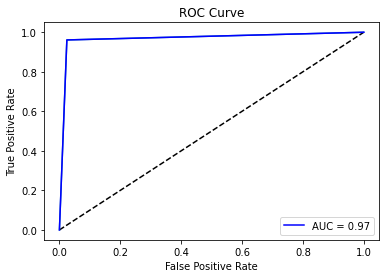

ROC Curve accuracy: 96.83%


In [58]:
y_pred_prob = model.predict_proba(X_test)[:,1]

fpr, tpr, thresholds = roc_curve(y_test, pred_test)
roc_auc = auc(fpr, tpr)

plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr, tpr)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.plot(fpr, tpr, 'b', label='AUC = %0.2f'% roc_auc)
plt.legend(loc='lower right')
plt.title('ROC Curve')
plt.show()

print("ROC Curve accuracy: {:.2f}%".format(roc_auc*100))

# 4.0 Validation test with dataset without classification

In [59]:
row = 1
flag = 1
column_fraud = 1
column_account_number = 0

workbook = xlsxwriter.Workbook('validation.xlsx') 
worksheet = workbook.add_worksheet() 
worksheet.write('A1', 'account_number')
worksheet.write('B1', 'fraud')

table_result = pd.DataFrame(columns = ['account_number', 'fraud'])

for account in range(len(tables_charges_accounts_without_level)):
    global account_number
    account_number = tables_charges_accounts_without_level['account_number'].iloc[account]
    
    global status
    status = tables_charges_accounts_without_level['status'].iloc[account]
    
    global value
    value = tables_charges_accounts_without_level['value'].iloc[account]
    
    global year
    year = tables_charges_accounts_without_level['year'].iloc[account]
    
    global month
    month = tables_charges_accounts_without_level['month'].iloc[account]
    
    global day
    day = tables_charges_accounts_without_level['day'].iloc[account]
    
    global hour
    hour = tables_charges_accounts_without_level['hour'].iloc[account]
    
    global minute
    minute = tables_charges_accounts_without_level['minute'].iloc[account]
    
    prediction = model.predict([[account_number, status, value, year, month, day, hour, minute]])
    
    if (tables_charges_accounts_without_level['account_number'].iloc[account] == 0 or 
        (tables_charges_accounts_without_level['account_number'].iloc[account] != 
         tables_charges_accounts_without_level['account_number'].iloc[account-1])):
        
        illicit_flag = 0
        
        if (prediction):
            worksheet.write(flag, column_fraud, 1)    
            worksheet.write(flag, column_account_number, tables_charges_accounts_without_level['account_number'].
                            iloc[account])
            flag += 1
            illicit_flag = 1
        else:
            if (illicit_flag != 1):
                worksheet.write(flag, column_fraud, 0)
                worksheet.write(flag, column_account_number, tables_charges_accounts_without_level['account_number'].
                                iloc[account])
     
            flag += 1
    else:
        
        if (prediction):
            count_illicit = 1
    row += 1
    
workbook.close()

In [60]:
df = pd.DataFrame(pd.read_excel("validation.xlsx"))

df

,account_number,fraud
0,208404,0
1,108762,1
2,309054,0
3,89836,0
4,900180,0
...,...,...
83,733497,0
84,905598,0
85,583343,0
86,81888,0


In [61]:
ct = collections.Counter(df['fraud'])

ct

Counter({0: 73, 1: 15})

# Conclusion

### Unclassified accounts from the 'level' table: 73 have no apparent irregularities and 15 had illegalities in some transaction.